# Generative Adversarial Networks (GANs)

So far in CS231N, all the applications of neural networks that we have explored have been **discriminative models** that take an input and are trained to produce a labeled output. This has ranged from straightforward classification of image categories to sentence generation (which was still phrased as a classification problem, our labels were in vocabulary space and we’d learned a recurrence to capture multi-word labels). In this notebook, we will expand our repetoire, and build **generative models** using neural networks. Specifically, we will learn how to build models which generate novel images that resemble a set of training images.

### What is a GAN?

In 2014, [Goodfellow et al.](https://arxiv.org/abs/1406.2661) presented a method for training generative models called Generative Adversarial Networks (GANs for short). In a GAN, we build two different neural networks. Our first network is a traditional classification network, called the **discriminator**. We will train the discriminator to take images, and classify them as being real (belonging to the training set) or fake (not present in the training set). Our other network, called the **generator**, will take random noise as input and transform it using a neural network to produce images. The goal of the generator is to fool the discriminator into thinking the images it produced are real.

We can think of this back and forth process of the generator ($G$) trying to fool the discriminator ($D$), and the discriminator trying to correctly classify real vs. fake as a minimax game:
$$\underset{G}{\text{minimize}}\; \underset{D}{\text{maximize}}\; \mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] + \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
where $x \sim p_\text{data}$ are samples from the input data, $z \sim p(z)$ are the random noise samples, $G(z)$ are the generated images using the neural network generator $G$, and $D$ is the output of the discriminator, specifying the probability of an input being real. In [Goodfellow et al.](https://arxiv.org/abs/1406.2661), they analyze this minimax game and show how it relates to minimizing the Jensen-Shannon divergence between the training data distribution and the generated samples from $G$.

To optimize this minimax game, we will aternate between taking gradient *descent* steps on the objective for $G$, and gradient *ascent* steps on the objective for $D$:
1. update the **generator** ($G$) to minimize the probability of the __discriminator making the correct choice__. 
2. update the **discriminator** ($D$) to maximize the probability of the __discriminator making the correct choice__.

While these updates are useful for analysis, they do not perform well in practice. Instead, we will use a different objective when we update the generator: maximize the probability of the **discriminator making the incorrect choice**. This small change helps to allevaiate problems with the generator gradient vanishing when the discriminator is confident. This is the standard update used in most GAN papers, and was used in the original paper from [Goodfellow et al.](https://arxiv.org/abs/1406.2661). 

In this assignment, we will alternate the following updates:
1. Update the generator ($G$) to maximize the probability of the discriminator making the incorrect choice on generated data:
$$\underset{G}{\text{maximize}}\;  \mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
2. Update the discriminator ($D$), to maximize the probability of the discriminator making the correct choice on real and generated data:
$$\underset{D}{\text{maximize}}\; \mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] + \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$

### What else is there?
Since 2014, GANs have exploded into a huge research area, with massive [workshops](https://sites.google.com/site/nips2016adversarial/), and [hundreds of new papers](https://github.com/hindupuravinash/the-gan-zoo). Compared to other approaches for generative models, they often produce the highest quality samples but are some of the most difficult and finicky models to train (see [this github repo](https://github.com/soumith/ganhacks) that contains a set of 17 hacks that are useful for getting models working). Improving the stabiilty and robustness of GAN training is an open research question, with new papers coming out every day! For a more recent tutorial on GANs, see [here](https://arxiv.org/abs/1701.00160). There is also some even more recent exciting work that changes the objective function to Wasserstein distance and yields much more stable results across model architectures: [WGAN](https://arxiv.org/abs/1701.07875), [WGAN-GP](https://arxiv.org/abs/1704.00028).


GANs are not the only way to train a generative model! For other approaches to generative modeling check out the [deep generative model chapter](http://www.deeplearningbook.org/contents/generative_models.html) of the Deep Learning [book](http://www.deeplearningbook.org). Another popular way of training neural networks as generative models is Variational Autoencoders (co-discovered [here](https://arxiv.org/abs/1312.6114) and [here](https://arxiv.org/abs/1401.4082)). Variational autoencoders combine neural networks with variational inference to train deep generative models. These models tend to be far more stable and easier to train but currently don't produce samples that are as pretty as GANs.

Example pictures of what you should expect (yours might look slightly different):

![caption](gan_outputs_tf.png)


## Setup

In [16]:
from __future__ import print_function, division
import tensorflow as tf
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# A bunch of utility functions

def show_images(images):
    images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return

def preprocess_img(x):
    return 2 * x - 1.0

def deprocess_img(x):
    return (x + 1.0) / 2.0

def rel_error(x,y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

def count_params():
    """Count the number of parameters in the current TensorFlow graph """
    param_count = np.sum([np.prod(x.get_shape().as_list()) for x in tf.global_variables()])
    return param_count


def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config=config)
    return session

answers = np.load('gan-checks-tf.npz')


## Dataset
 GANs are notoriously finicky with hyperparameters, and also require many training epochs. In order to make this assignment approachable without a GPU, we will be working on the MNIST dataset, which is 60,000 training and 10,000 test images. Each picture contains a centered image of white digit on black background (0 through 9). This was one of the first datasets used to train convolutional neural networks and it is fairly easy -- a standard CNN model can easily exceed 99% accuracy. 

To simplify our code here, we will use the TensorFlow MNIST wrapper, which downloads and loads the MNIST dataset. See the [documentation](https://github.com/tensorflow/tensorflow/blob/master/tensorflow/contrib/learn/python/learn/datasets/mnist.py) for more information about the interface. The default parameters will take 5,000 of the training examples and place them into a validation dataset. The data will be saved into a folder called `MNIST_data`. 

**Heads-up**: The TensorFlow MNIST wrapper returns images as vectors. That is, they're size (batch, 784). If you want to treat them as images, we have to resize them to (batch,28,28) or (batch,28,28,1). They are also type np.float32 and bounded [0,1]. 

Extracting ./cs231n/datasets/MNIST_data/train-images-idx3-ubyte.gz
Extracting ./cs231n/datasets/MNIST_data/train-labels-idx1-ubyte.gz
Extracting ./cs231n/datasets/MNIST_data/t10k-images-idx3-ubyte.gz
Extracting ./cs231n/datasets/MNIST_data/t10k-labels-idx1-ubyte.gz


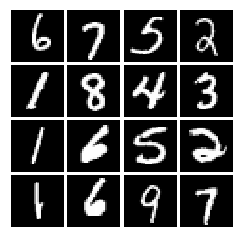

In [2]:
from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets('./cs231n/datasets/MNIST_data', one_hot=False)

# show a batch
show_images(mnist.train.next_batch(16)[0])

## LeakyReLU
In the cell below, you should implement a LeakyReLU. See the [class notes](http://cs231n.github.io/neural-networks-1/) (where alpha is small number) or equation (3) in [this paper](http://ai.stanford.edu/~amaas/papers/relu_hybrid_icml2013_final.pdf). LeakyReLUs keep ReLU units from dying and are often used in GAN methods (as are maxout units, however those increase model size and therefore are not used in this notebook).

HINT: You should be able to use `tf.maximum`

In [17]:
def leaky_relu(x, alpha=0.01):
    """Compute the leaky ReLU activation function.
    
    Inputs:
    - x: TensorFlow Tensor with arbitrary shape
    - alpha: leak parameter for leaky ReLU
    
    Returns:
    TensorFlow Tensor with the same shape as x
    """
    # TODO: implement leaky ReLU
    pass
    x = tf.maximum(x, alpha*x)
    return x

Test your leaky ReLU implementation. You should get errors < 1e-10

In [4]:
def test_leaky_relu(x, y_true):
    tf.reset_default_graph()
    with get_session() as sess:
        y_tf = leaky_relu(tf.constant(x))
        y = sess.run(y_tf)
        print('Maximum error: %g'%rel_error(y_true, y))

test_leaky_relu(answers['lrelu_x'], answers['lrelu_y'])

Maximum error: 0


## Random Noise
Generate a TensorFlow `Tensor` containing uniform noise from -1 to 1 with shape `[batch_size, dim]`.

In [18]:
def sample_noise(batch_size, dim):
    """Generate random uniform noise from -1 to 1.
    
    Inputs:
    - batch_size: integer giving the batch size of noise to generate
    - dim: integer giving the dimension of the the noise to generate
    
    Returns:
    TensorFlow Tensor containing uniform noise in [-1, 1] with shape [batch_size, dim]
    """
    # TODO: sample and return noise
    pass
    return tf.random_uniform([batch_size, dim], -1, 1)

Make sure noise is the correct shape and type:

In [6]:
def test_sample_noise():
    batch_size = 3
    dim = 4
    tf.reset_default_graph()
    with get_session() as sess:
        z = sample_noise(batch_size, dim)
        # Check z has the correct shape
        assert z.get_shape().as_list() == [batch_size, dim]
        # Make sure z is a Tensor and not a numpy array
        assert isinstance(z, tf.Tensor)
        # Check that we get different noise for different evaluations
        z1 = sess.run(z)
        z2 = sess.run(z)
        assert not np.array_equal(z1, z2)
        # Check that we get the correct range
        assert np.all(z1 >= -1.0) and np.all(z1 <= 1.0)
        print("All tests passed!")
    
test_sample_noise()

All tests passed!


## Discriminator
Our first step is to build a discriminator. You should use the layers in `tf.layers` to build the model.
All fully connected layers should include bias terms.

Architecture:
 * Fully connected layer from size 784 to 256
 * LeakyReLU with alpha 0.01
 * Fully connected layer from 256 to 256
 * LeakyReLU with alpha 0.01
 * Fully connected layer from 256 to 1
 
The output of the discriminator should have shape `[batch_size, 1]`, and contain real numbers corresponding to the scores that each of the `batch_size` inputs is a real image.

In [7]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 784]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        pass
        alpha = 0.01
        
        fc1 = tf.layers.dense(inputs = x,
                              units = 256,
                              activation = None,
                              use_bias = True)
        
        lru1 = leaky_relu(fc1, alpha)
        
        fc2 = tf.layers.dense(inputs = lru1,
                              units = 256,
                              activation = None,
                              use_bias = True)
        
        lru2 = leaky_relu(fc2, alpha)
        
        logits = tf.layers.dense(inputs = lru2,
                                 units = 1,
                                 activation = None,
                                 use_bias = True)
        return logits

Test to make sure the number of parameters in the discriminator is correct:

In [8]:
def test_discriminator(true_count=267009):
    tf.reset_default_graph()
    with get_session() as sess:
        y = discriminator(tf.ones((2, 784)))
        cur_count = count_params()
        if cur_count != true_count:
            print('Incorrect number of parameters in discriminator. {0} instead of {1}. Check your achitecture.'.format(cur_count,true_count))
        else:
            print('Correct number of parameters in discriminator.')
        
test_discriminator()

Correct number of parameters in discriminator.


## Generator
Now to build a generator. You should use the layers in `tf.layers` to construct the model. All fully connected layers should include bias terms.

Architecture:
 * Fully connected layer from tf.shape(z)[1] (the number of noise dimensions) to 1024
 * ReLU
 * Fully connected layer from 1024 to 1024 
 * ReLU
 * Fully connected layer from 1024 to 784
 * TanH (To restrict the output to be [-1,1])

In [9]:
def generator(z):
    """Generate images from a random noise vector.
    
    Inputs:
    - z: TensorFlow Tensor of random noise with shape [batch_size, noise_dim]
    
    Returns:
    TensorFlow Tensor of generated images, with shape [batch_size, 784].
    """
    with tf.variable_scope("generator"):
        # TODO: implement architecture
        fc1 = tf.layers.dense(inputs = z,
                              units = 1024,
                              activation = tf.nn.relu,
                              use_bias = True)
        
        fc2 = tf.layers.dense(inputs = fc1,
                             units = 1024,
                             activation = tf.nn.relu,
                             use_bias = True)
        
        img = tf.layers.dense(inputs = fc2,
                             units = 784,
                             activation = tf.nn.tanh,
                             use_bias = True)
        pass
        return img

Test to make sure the number of parameters in the generator is correct:

In [10]:
def test_generator(true_count=1858320):
    tf.reset_default_graph()
    with get_session() as sess:
        y = generator(tf.ones((1, 4)))
        cur_count = count_params()
        if cur_count != true_count:
            print('Incorrect number of parameters in generator. {0} instead of {1}. Check your achitecture.'.format(cur_count,true_count))
        else:
            print('Correct number of parameters in generator.')
        
test_generator()

Correct number of parameters in generator.


# GAN Loss

Compute the generator and discriminator loss. The generator loss is:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: Use [tf.ones_like](https://www.tensorflow.org/api_docs/python/tf/ones_like) and [tf.zeros_like](https://www.tensorflow.org/api_docs/python/tf/zeros_like) to generate labels for your discriminator. Use [sigmoid_cross_entropy loss](https://www.tensorflow.org/api_docs/python/tf/nn/sigmoid_cross_entropy_with_logits) to help compute your loss function. Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [19]:
def gan_loss(logits_real, logits_fake):
    """Compute the GAN loss.
    
    Inputs:
    - logits_real: Tensor, shape [batch_size, 1], output of discriminator
        Log probability that the image is real for each real image
    - logits_fake: Tensor, shape[batch_size, 1], output of discriminator
        Log probability that the image is real for each fake image
    
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    pass
    # tf.nn.sigmoid_cross_entropy_with_logits(labels = x, logits = y)
    # - (y * log(sigmoid(x)) + (1-y) * log(1 - sigmoid(x)))
    G_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,
                                                                   labels = tf.ones_like(logits_fake)))
    D_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_real,
                                                                   labels = tf.ones_like(logits_real)))
    D_loss += tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,
                                                                    labels = tf.zeros_like(logits_fake)))

    return D_loss, G_loss

Test your GAN loss. Make sure both the generator and discriminator loss are correct. You should see errors less than 1e-5.

In [12]:
def test_gan_loss(logits_real, logits_fake, d_loss_true, g_loss_true):
    tf.reset_default_graph()
    with get_session() as sess:
        d_loss, g_loss = sess.run(gan_loss(tf.constant(logits_real), tf.constant(logits_fake)))
    print("Maximum error in d_loss: %g"%rel_error(d_loss_true, d_loss))
    print("Maximum error in g_loss: %g"%rel_error(g_loss_true, g_loss))

test_gan_loss(answers['logits_real'], answers['logits_fake'],
              answers['d_loss_true'], answers['g_loss_true'])

Maximum error in d_loss: 0
Maximum error in g_loss: 0


# Optimizing our loss
Make an `AdamOptimizer` with a 1e-3 learning rate, beta1=0.5 to mininize G_loss and D_loss separately. The trick of decreasing beta was shown to be effective in helping GANs converge in the [Improved Techniques for Training GANs](https://arxiv.org/abs/1606.03498) paper. In fact, with our current hyperparameters, if you set beta1 to the Tensorflow default of 0.9, there's a good chance your discriminator loss will go to zero and the generator will fail to learn entirely. In fact, this is a common failure mode in GANs; if your D(x) learns to be too fast (e.g. loss goes near zero), your G(z) is never able to learn. Often D(x) is trained with SGD with Momentum or RMSProp instead of Adam, but here we'll use Adam for both D(x) and G(z). 

In [13]:
# TODO: create an AdamOptimizer for D_solver and G_solver
def get_solvers(learning_rate=1e-3, beta1=0.5):
    """Create solvers for GAN training.
    
    Inputs:
    - learning_rate: learning rate to use for both solvers
    - beta1: beta1 parameter for both solvers (first moment decay)
    
    Returns:
    - D_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    - G_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    """
    D_solver = None
    G_solver = None
    pass
    D_solver = tf.train.AdamOptimizer(learning_rate=1e-3, beta1=0.5)
    G_solver = tf.train.AdamOptimizer(learning_rate=1e-3, beta1=0.5)
    return D_solver, G_solver

## Putting it all together
Now just a bit of Lego Construction.. Read this section over carefully to understand how we'll be composing the generator and discriminator

In [14]:
tf.reset_default_graph()

# number of images for each batch
batch_size = 128
# our noise dimension
noise_dim = 96

# placeholder for images from the training dataset
x = tf.placeholder(tf.float32, [None, 784])
# random noise fed into our generator
z = sample_noise(batch_size, noise_dim)
# generated images
G_sample = generator(z)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(preprocess_img(x))
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator') 

# get our solver
D_solver, G_solver = get_solvers()

# get our loss
D_loss, G_loss = gan_loss(logits_real, logits_fake)

# setup training steps
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS, 'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS, 'generator')

# Training a GAN!
Well that wasn't so hard, was it? In the iterations in the low 100s you should see black backgrounds, fuzzy shapes as you approach iteration 1000, and decent shapes, about half of which will be sharp and clearly recognizable as we pass 3000. In our case, we'll simply train D(x) and G(z) with one batch each every iteration. However, papers often experiment with different schedules of training D(x) and G(z), sometimes doing one for more steps than the other, or even training each one until the loss gets "good enough" and then switching to training the other. 

In [15]:
# a giant helper function
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    max_iter = int(mnist.train.num_examples*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            samples = sess.run(G_sample)
            fig = show_images(samples[:16])
            plt.show()
            print()
        # run a batch of data through the network
        minibatch,minbatch_y = mnist.train.next_batch(batch_size)
        _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
        _, G_loss_curr = sess.run([G_train_step, G_loss])

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    print('Final images')
    samples = sess.run(G_sample)

    fig = show_images(samples[:16])
    plt.show()

#### Train your GAN! This should take about 10 minutes on a CPU, or less than a minute on GPU.

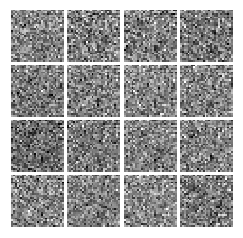


Iter: 0, D: 1.648, G:0.7165
Iter: 50, D: 0.5874, G:1.493
Iter: 100, D: 1.586, G:1.345
Iter: 150, D: 0.9235, G:1.366
Iter: 200, D: 1.678, G:1.827


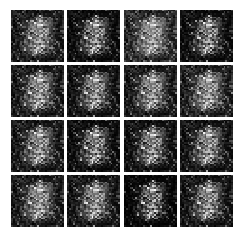


Iter: 250, D: 1.181, G:1.211
Iter: 300, D: 0.9612, G:2.731
Iter: 350, D: 0.9741, G:0.9231
Iter: 400, D: 1.204, G:1.552
Iter: 450, D: 0.9228, G:2.395


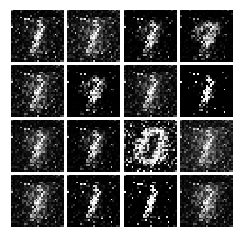


Iter: 500, D: 0.8623, G:1.912
Iter: 550, D: 1.271, G:1.535
Iter: 600, D: 1.039, G:1.664
Iter: 650, D: 0.962, G:1.983
Iter: 700, D: 0.9236, G:1.423


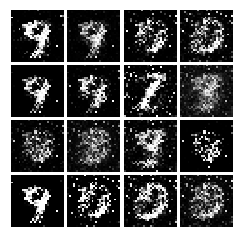


Iter: 750, D: 1.145, G:1.253
Iter: 800, D: 1.088, G:1.408
Iter: 850, D: 1.205, G:1.546
Iter: 900, D: 1.22, G:0.959
Iter: 950, D: 1.431, G:0.3909


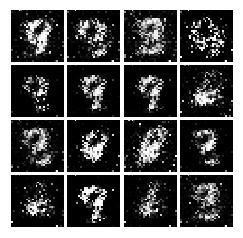


Iter: 1000, D: 1.209, G:0.5308
Iter: 1050, D: 1.152, G:1.09
Iter: 1100, D: 1.108, G:1.283
Iter: 1150, D: 1.128, G:1.189
Iter: 1200, D: 1.049, G:1.182


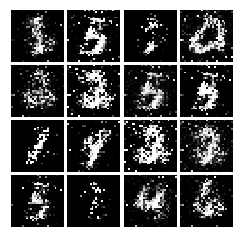


Iter: 1250, D: 1.575, G:0.922
Iter: 1300, D: 1.138, G:1.325
Iter: 1350, D: 1.278, G:1.335
Iter: 1400, D: 1.275, G:0.9503
Iter: 1450, D: 1.162, G:1.034


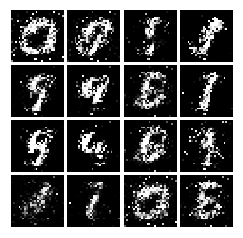


Iter: 1500, D: 1.226, G:1.097
Iter: 1550, D: 1.226, G:1.377
Iter: 1600, D: 1.302, G:1.473
Iter: 1650, D: 1.119, G:1.171
Iter: 1700, D: 1.214, G:1.075


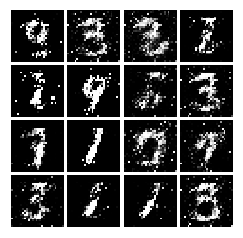


Iter: 1750, D: 1.313, G:0.9817
Iter: 1800, D: 1.216, G:1.668
Iter: 1850, D: 1.481, G:0.7717
Iter: 1900, D: 1.258, G:0.8565
Iter: 1950, D: 1.286, G:0.8497


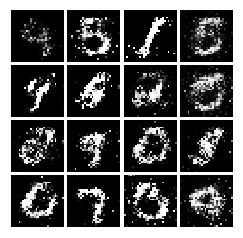


Iter: 2000, D: 1.315, G:0.991
Iter: 2050, D: 1.224, G:0.9757
Iter: 2100, D: 1.328, G:0.9
Iter: 2150, D: 1.266, G:0.8897
Iter: 2200, D: 1.286, G:0.9132


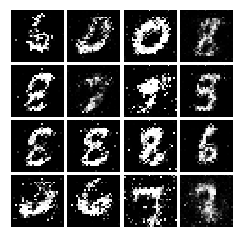


Iter: 2250, D: 1.333, G:0.8749
Iter: 2300, D: 1.3, G:1.119
Iter: 2350, D: 1.372, G:0.8749
Iter: 2400, D: 1.306, G:0.8101
Iter: 2450, D: 1.355, G:0.6982


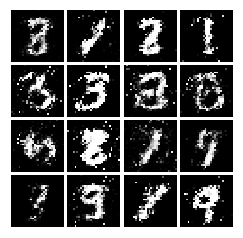


Iter: 2500, D: 1.225, G:0.9841
Iter: 2550, D: 1.36, G:0.8372
Iter: 2600, D: 1.36, G:0.7625
Iter: 2650, D: 1.32, G:0.8769
Iter: 2700, D: 1.197, G:1.107


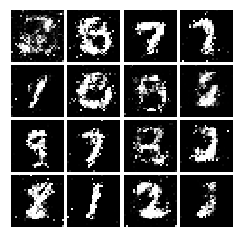


Iter: 2750, D: 1.314, G:0.9837
Iter: 2800, D: 1.362, G:0.905
Iter: 2850, D: 1.234, G:0.8733
Iter: 2900, D: 1.282, G:0.8739
Iter: 2950, D: 1.262, G:0.8936


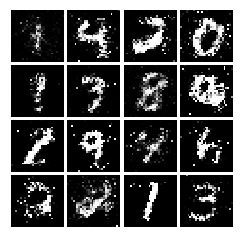


Iter: 3000, D: 1.198, G:0.9868
Iter: 3050, D: 1.221, G:1.03
Iter: 3100, D: 1.229, G:0.9559
Iter: 3150, D: 1.319, G:0.9062
Iter: 3200, D: 1.276, G:0.8813


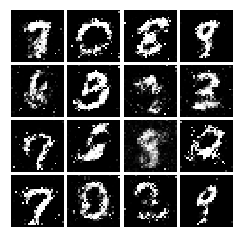


Iter: 3250, D: 1.173, G:0.9475
Iter: 3300, D: 1.266, G:0.9888
Iter: 3350, D: 1.349, G:0.8116
Iter: 3400, D: 1.26, G:0.8712
Iter: 3450, D: 1.299, G:0.8638


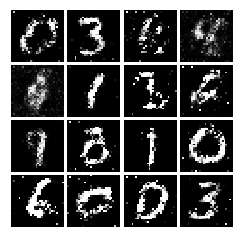


Iter: 3500, D: 1.301, G:0.8547
Iter: 3550, D: 1.359, G:0.8485
Iter: 3600, D: 1.283, G:0.9483
Iter: 3650, D: 1.238, G:0.846
Iter: 3700, D: 1.273, G:0.8474


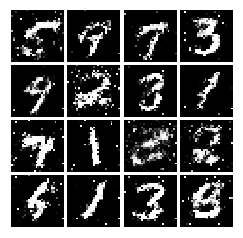


Iter: 3750, D: 1.274, G:0.8495
Iter: 3800, D: 1.283, G:0.9808
Iter: 3850, D: 1.279, G:0.8521
Iter: 3900, D: 1.241, G:0.9032
Iter: 3950, D: 1.331, G:0.8703


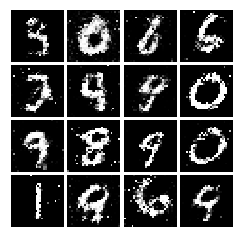


Iter: 4000, D: 1.296, G:0.8176
Iter: 4050, D: 1.391, G:0.8222
Iter: 4100, D: 1.276, G:0.8683
Iter: 4150, D: 1.222, G:0.9627
Iter: 4200, D: 1.293, G:0.8916


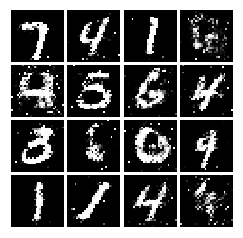


Iter: 4250, D: 1.367, G:0.8634
Final images


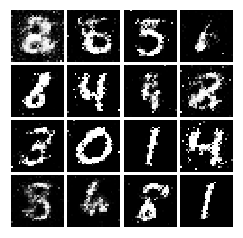

In [18]:
with get_session() as sess:
    sess.run(tf.global_variables_initializer())
    run_a_gan(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step)

# Least Squares GAN
We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alternative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`score_real` and `score_fake`).

In [20]:
def lsgan_loss(score_real, score_fake):
    """Compute the Least Squares GAN loss.
    
    Inputs:
    - score_real: Tensor, shape [batch_size, 1], output of discriminator
        score for each real image
    - score_fake: Tensor, shape[batch_size, 1], output of discriminator
        score for each fake image    
          
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    pass
    G_loss = 0.5 * tf.reduce_mean(tf.pow(score_fake - tf.ones_like(score_fake), 2))
    D_loss = 0.5 * (tf.reduce_mean(tf.pow(score_real - tf.ones_like(score_real), 2)) 
                    + tf.reduce_mean(tf.pow(score_fake, 2)))
    return D_loss, G_loss

Test your LSGAN loss. You should see errors less than 1e-7.

In [17]:
def test_lsgan_loss(score_real, score_fake, d_loss_true, g_loss_true):
    with get_session() as sess:
        d_loss, g_loss = sess.run(
            lsgan_loss(tf.constant(score_real), tf.constant(score_fake)))
    print("Maximum error in d_loss: %g"%rel_error(d_loss_true, d_loss))
    print("Maximum error in g_loss: %g"%rel_error(g_loss_true, g_loss))

test_lsgan_loss(answers['logits_real'], answers['logits_fake'],
                answers['d_loss_lsgan_true'], answers['g_loss_lsgan_true'])

Maximum error in d_loss: 0
Maximum error in g_loss: 0


Create new training steps so we instead minimize the LSGAN loss:

In [18]:
D_loss, G_loss = lsgan_loss(logits_real, logits_fake)
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)

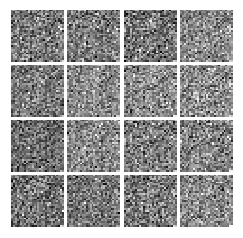


Iter: 0, D: 1.072, G:0.3277
Iter: 50, D: 0.7731, G:1.635
Iter: 100, D: 0.108, G:0.4569
Iter: 150, D: 0.7294, G:1.314
Iter: 200, D: 0.118, G:0.8605


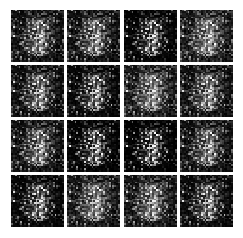


Iter: 250, D: 0.1682, G:0.4542
Iter: 300, D: 0.09487, G:0.4586
Iter: 350, D: 0.05726, G:0.4093
Iter: 400, D: 0.1621, G:0.4251
Iter: 450, D: 0.133, G:0.3266


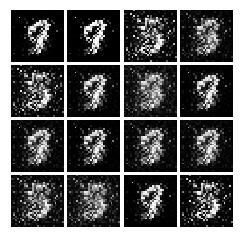


Iter: 500, D: 0.1317, G:0.3589
Iter: 550, D: 0.08967, G:0.5811
Iter: 600, D: 0.07926, G:0.5591
Iter: 650, D: 0.1582, G:0.4372
Iter: 700, D: 0.1691, G:0.395


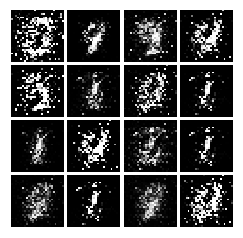


Iter: 750, D: 0.1818, G:0.2964
Iter: 800, D: 0.1647, G:0.5057
Iter: 850, D: 0.1784, G:0.304
Iter: 900, D: 0.1526, G:0.4613
Iter: 950, D: 0.1517, G:0.1208


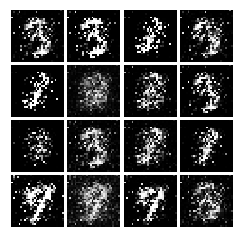


Iter: 1000, D: 0.1719, G:0.27
Iter: 1050, D: 0.143, G:0.3017
Iter: 1100, D: 0.16, G:0.2377
Iter: 1150, D: 0.1444, G:0.2432
Iter: 1200, D: 0.1668, G:0.3597


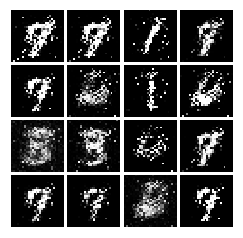


Iter: 1250, D: 0.1728, G:0.1949
Iter: 1300, D: 0.1863, G:0.2716
Iter: 1350, D: 0.2186, G:0.4452
Iter: 1400, D: 0.185, G:0.2507
Iter: 1450, D: 0.2517, G:0.1063


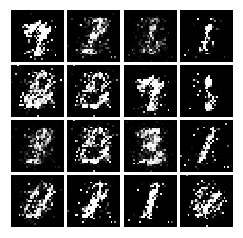


Iter: 1500, D: 0.1905, G:0.3451
Iter: 1550, D: 0.1625, G:0.2491
Iter: 1600, D: 0.1905, G:0.2566
Iter: 1650, D: 0.2159, G:0.2059
Iter: 1700, D: 0.2217, G:0.2081


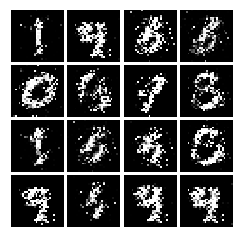


Iter: 1750, D: 0.2605, G:0.1345
Iter: 1800, D: 0.164, G:0.2176
Iter: 1850, D: 0.199, G:0.2047
Iter: 1900, D: 0.2229, G:0.2921
Iter: 1950, D: 0.2054, G:0.2234


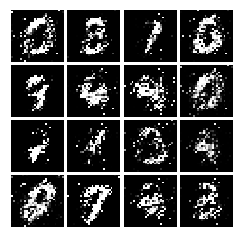


Iter: 2000, D: 0.2103, G:0.2325
Iter: 2050, D: 0.2228, G:0.1628
Iter: 2100, D: 0.2091, G:0.1724
Iter: 2150, D: 0.2049, G:0.2026
Iter: 2200, D: 0.2316, G:0.1912


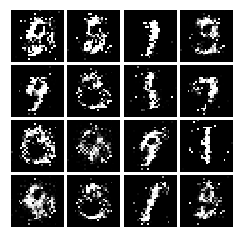


Iter: 2250, D: 0.2022, G:0.1912
Iter: 2300, D: 0.2055, G:0.1875
Iter: 2350, D: 0.1872, G:0.2308
Iter: 2400, D: 0.1947, G:0.287
Iter: 2450, D: 0.1997, G:0.1989


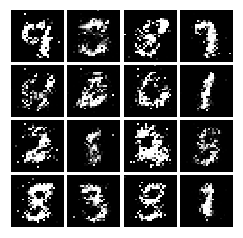


Iter: 2500, D: 0.2111, G:0.1918
Iter: 2550, D: 0.2027, G:0.1929
Iter: 2600, D: 0.24, G:0.2419
Iter: 2650, D: 0.2164, G:0.2074
Iter: 2700, D: 0.2174, G:0.1803


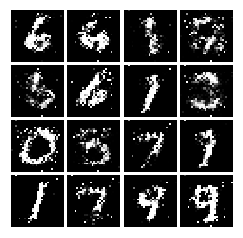


Iter: 2750, D: 0.2101, G:0.1908
Iter: 2800, D: 0.194, G:0.2964
Iter: 2850, D: 0.2295, G:0.2008
Iter: 2900, D: 0.218, G:0.2154
Iter: 2950, D: 0.2167, G:0.1595


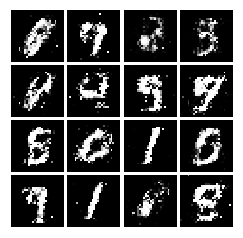


Iter: 3000, D: 0.2276, G:0.1723
Iter: 3050, D: 0.2398, G:0.1678
Iter: 3100, D: 0.2227, G:0.1865
Iter: 3150, D: 0.2334, G:0.1649
Iter: 3200, D: 0.2183, G:0.1546


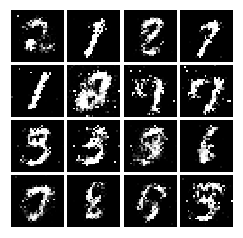


Iter: 3250, D: 0.214, G:0.1868
Iter: 3300, D: 0.2214, G:0.1892
Iter: 3350, D: 0.2111, G:0.1574
Iter: 3400, D: 0.235, G:0.1841
Iter: 3450, D: 0.2113, G:0.1919


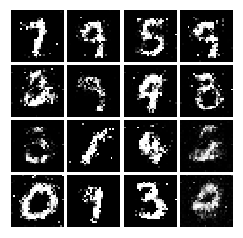


Iter: 3500, D: 0.2375, G:0.1414
Iter: 3550, D: 0.235, G:0.1746
Iter: 3600, D: 0.2188, G:0.1773
Iter: 3650, D: 0.2412, G:0.1708
Iter: 3700, D: 0.2442, G:0.1564


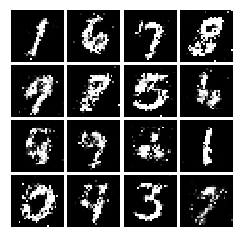


Iter: 3750, D: 0.2451, G:0.2109
Iter: 3800, D: 0.2215, G:0.1797
Iter: 3850, D: 0.2259, G:0.1622
Iter: 3900, D: 0.2475, G:0.171
Iter: 3950, D: 0.2161, G:0.1617


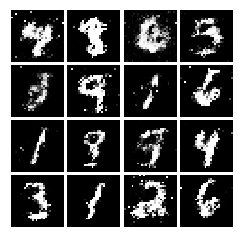


Iter: 4000, D: 0.2488, G:0.1675
Iter: 4050, D: 0.2282, G:0.2042
Iter: 4100, D: 0.2314, G:0.2077
Iter: 4150, D: 0.2367, G:0.1751
Iter: 4200, D: 0.2277, G:0.1739


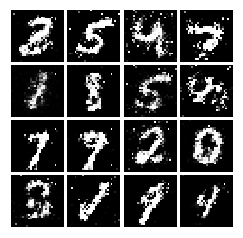


Iter: 4250, D: 0.2286, G:0.1799
Final images


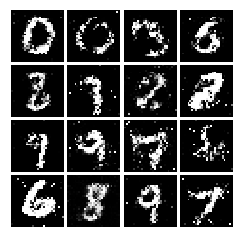

In [22]:
with get_session() as sess:
    sess.run(tf.global_variables_initializer())
    run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step)

# INLINE QUESTION 1:
Describe how the visual quality of the samples changes over the course of training. Do you notice anything about the distribution of the samples? How do the results change across different training runs?

The visual quality is becoming better and better untill 2700 iterations, after that it seems achieve stable state and I can distinguish most of them.
In the beginning, all of 16 samples are looking like 9, but with future train, they changed unpredictable. 

# Deep Convolutional GANs
In the first part of the notebook, we implemented an almost direct copy of the original GAN network from Ian Goodfellow. However, this network architecture allows no real spatial reasoning. It is unable to reason about things like "sharp edges" in general because it lacks any convolutional layers. Thus, in this section, we will implement some of the ideas from [DCGAN](https://arxiv.org/abs/1511.06434), where we use convolutional networks as our discriminators and generators.

#### Discriminator
We will use a discriminator inspired by the TensorFlow MNIST classification [tutorial](https://www.tensorflow.org/get_started/mnist/pros), which is able to get above 99% accuracy on the MNIST dataset fairly quickly. *Be sure to check the dimensions of x and reshape when needed*, fully connected blocks expect [N,D] Tensors while conv2d blocks expect [N,H,W,C] Tensors. 

Architecture:
* 32 Filters, 5x5, Stride 1, Leaky ReLU(alpha=0.01)
* Max Pool 2x2, Stride 2
* 64 Filters, 5x5, Stride 1, Leaky ReLU(alpha=0.01)
* Max Pool 2x2, Stride 2
* Flatten
* Fully Connected size 4 x 4 x 64, Leaky ReLU(alpha=0.01)
* Fully Connected size 1

In [ ]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 784]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        pass
        x_img = tf.reshape(x, [-1,28,28,1])
        conv1 = tf.layers.conv2d(inputs= x_img, # 24*24*32
                                 filters= 32,
                                 kernel_size= (5,5),
                                 strides = (1,1))
        lru1 = leaky_relu(conv1, alpha=0.01)
        maxpooling1 = tf.layers.max_pooling2d(inputs=lru1, # 12*12*32
                                             pool_size= (2,2),
                                             strides= 2)
        conv2 = tf.layers.conv2d(inputs= maxpooling1, # 8*8*64
                                 filters= 64,
                                 kernel_size= (5,5),
                                 strides= (1,1))
        lru2 = leaky_relu(conv2, alpha=0.01)
        maxpooling2 = tf.layers.max_pooling2d(inputs= lru2, # 4*4*64
                                             pool_size= (2,2),
                                             strides= 2)
        x_flat = tf.reshape(maxpooling2, [-1, 4*4*64])
        fc1 = tf.layers.dense(inputs= x_flat,
                             units= 1024,
                             activation= None)
        lru3 = leaky_relu(fc1, alpha=0.01)
        logits = tf.layers.dense(inputs= lru3,
                                units= 1,
                                activation= None)
        return logits
test_discriminator(1102721)

#### Generator
For the generator, we will copy the architecture exactly from the [InfoGAN paper](https://arxiv.org/pdf/1606.03657.pdf). See Appendix C.1 MNIST. See the documentation for [tf.nn.conv2d_transpose](https://www.tensorflow.org/api_docs/python/tf/nn/conv2d_transpose). We are always "training" in GAN mode.

Architecture:
* Fully connected of size 1024, ReLU
* BatchNorm
* Fully connected of size 7 x 7 x 128, ReLU
* BatchNorm
* Resize into Image Tensor
* 64 conv2d^T (transpose) filters of 4x4, stride 2, ReLU
* BatchNorm
* 1 conv2d^T (transpose) filter of 4x4, stride 2, TanH

In [41]:
def generator(z):
    """Generate images from a random noise vector.
    
    Inputs:
    - z: TensorFlow Tensor of random noise with shape [batch_size, noise_dim]
    
    Returns:
    TensorFlow Tensor of generated images, with shape [batch_size, 784].
    """
    with tf.variable_scope("generator"):
        # TODO: implement architecture
        pass
        fc1 = tf.layers.dense(inputs= z, #1024
                             units= 1024,
                             activation= tf.nn.relu)
        bn1 = tf.layers.batch_normalization(inputs= fc1,
                                            axis = 1,
                                           training= True)
        fc2 = tf.layers.dense(inputs= bn1, # 7*7*128
                             units= 7*7*128,
                             activation= tf.nn.relu)
        bn2 = tf.layers.batch_normalization(inputs= fc2,
                                           training= True)
        bn2_img = tf.reshape(bn2, [-1, 7, 7, 128])
        conv_t1 = tf.layers.conv2d_transpose(inputs= bn2_img, # 14*14*64
                                            filters= 64,
                                            kernel_size= (4,4),
                                            strides= (2,2),
                                            activation = tf.nn.relu,
                                            padding= 'same')
        bn3 = tf.layers.batch_normalization(inputs= conv_t1,
                                           axis= 3,
                                           training= True)
        conv_t2 = tf.layers.conv2d_transpose(inputs= bn3, # 28*28*1
                                            filters= 1,
                                            kernel_size= (4,4),
                                            strides= (2,2),
                                            activation= tf.nn.tanh,
                                            padding= 'same')
        img = tf.reshape(conv_t2, [-1, 784])
        return img
test_generator(6595521)

Correct number of parameters in generator.


We have to recreate our network since we've changed our functions.

In [42]:
tf.reset_default_graph()

batch_size = 128
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [None, 784])
z = sample_noise(batch_size, noise_dim)
# generated images
G_sample = generator(z)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(preprocess_img(x))
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator') 

D_solver,G_solver = get_solvers()
D_loss, G_loss = gan_loss(logits_real, logits_fake)
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

### Train and evaluate a DCGAN
This is the one part of A3 that significantly benefits from using a GPU. It takes 3 minutes on a GPU for the requested five epochs. Or about 50 minutes on a dual core laptop on CPU (feel free to use 3 epochs if you do it on CPU).

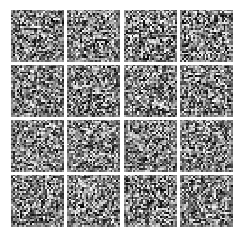


Iter: 0, D: 1.387, G:0.591
Iter: 50, D: 0.794, G:1.136
Iter: 100, D: 0.7492, G:1.163
Iter: 150, D: 0.8438, G:1.446
Iter: 200, D: 1.129, G:1.082


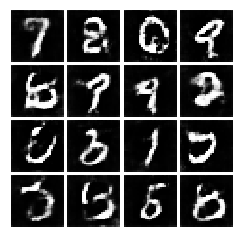


Iter: 250, D: 1.062, G:0.4828
Iter: 300, D: 1.149, G:0.9141
Iter: 350, D: 1.119, G:0.9852
Iter: 400, D: 1.161, G:0.8006
Iter: 450, D: 1.252, G:0.9783


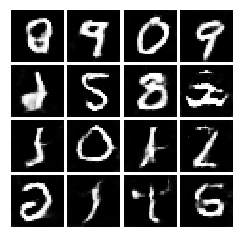


Iter: 500, D: 1.128, G:0.8572
Iter: 550, D: 1.23, G:1.034
Iter: 600, D: 1.536, G:0.9144
Iter: 650, D: 1.115, G:1.17
Iter: 700, D: 1.08, G:1.166


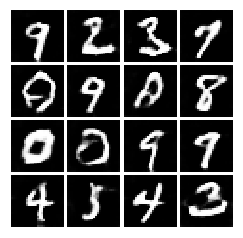


Iter: 750, D: 1.302, G:1.264
Iter: 800, D: 1.197, G:1.086
Iter: 850, D: 1.158, G:1.397
Iter: 900, D: 1.18, G:0.7018
Iter: 950, D: 1.18, G:1.111


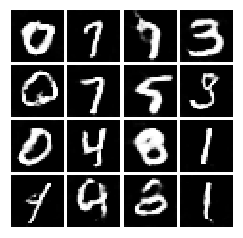


Iter: 1000, D: 1.229, G:1.204
Iter: 1050, D: 1.405, G:1.651
Iter: 1100, D: 1.149, G:0.9256
Iter: 1150, D: 1.177, G:1.002
Iter: 1200, D: 1.111, G:1.122


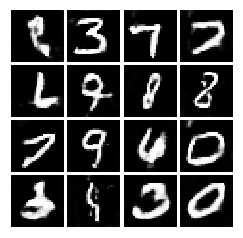


Iter: 1250, D: 1.221, G:0.9443
Iter: 1300, D: 1.379, G:0.8137
Iter: 1350, D: 1.43, G:0.7493
Iter: 1400, D: 1.067, G:0.9893
Iter: 1450, D: 1.179, G:0.8574


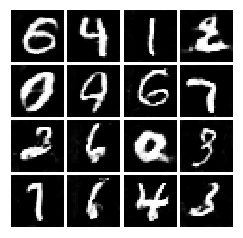


Iter: 1500, D: 1.124, G:1.058
Iter: 1550, D: 1.057, G:1.422
Iter: 1600, D: 1.265, G:1.435
Iter: 1650, D: 1.204, G:0.8541
Iter: 1700, D: 1.044, G:1.005


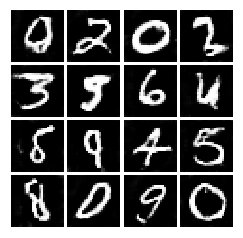


Iter: 1750, D: 1.181, G:0.8066
Iter: 1800, D: 1.501, G:1.013
Iter: 1850, D: 1.129, G:0.8309
Iter: 1900, D: 1.181, G:1.231
Iter: 1950, D: 1.219, G:0.8261


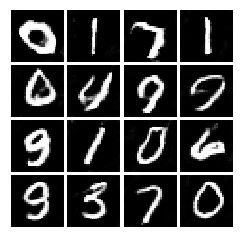


Iter: 2000, D: 1.135, G:0.8842
Iter: 2050, D: 1.248, G:0.65
Iter: 2100, D: 1.129, G:0.8933
Final images


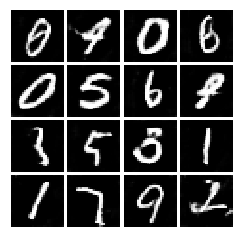

In [43]:
with get_session() as sess:
    sess.run(tf.global_variables_initializer())
    run_a_gan(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,num_epoch=5)

# INLINE QUESTION 2:
What differences do you see between the DCGAN results and the original GAN results?

The images' edge of number generated from DCGAN are smoother than them get from original GAN, and easier to recognize them.

------

# Extra Credit 
** Be sure you don't destroy your results above, but feel free to copy+paste code to get results below **
* For a small amount of extra credit, you can implement additional new GAN loss functions below, provided they converge. See AFI, BiGAN, Softmax GAN, Conditional GAN, InfoGAN, etc. They should converge to get credit.
* Likewise for an improved architecture or using a convolutional GAN (or even implement a VAE)
* For a bigger chunk of extra credit, load the CIFAR10 data (see last assignment) and train a compelling generative model on CIFAR-10
* Demonstrate the value of GANs in building semi-supervised models. In a semi-supervised example, only some fraction of the input data has labels; we can supervise this in MNIST by only training on a few dozen or hundred labeled examples. This was first described in [Improved Techniques for Training GANs](https://arxiv.org/abs/1606.03498).
* Something new/cool.

#### Describe what you did here

In [60]:
import tensorflow as tf
import numpy as np
import math
import timeit
import matplotlib.pyplot as plt
%matplotlib inline
print (tf.VERSION)

from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=10000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
    
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

#     # Normalize the data: subtract the mean image
#     mean_image = np.mean(X_train, axis=0)
#     X_train -= mean_image
#     X_val -= mean_image
#     X_test -= mean_image

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print('Train data shape: ', X_train.shape)
print('Train labels shape: ', y_train.shape)
print('Validation data shape: ', X_val.shape)
print('Validation labels shape: ', y_val.shape)
print('Test data shape: ', X_test.shape)
print('Test labels shape: ', y_test.shape)

1.2.0-rc0
Train data shape:  (49000, 32, 32, 3)
Train labels shape:  (49000,)
Validation data shape:  (1000, 32, 32, 3)
Validation labels shape:  (1000,)
Test data shape:  (10000, 32, 32, 3)
Test labels shape:  (10000,)


In [61]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1]/3)))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))
    return

In [62]:
MODE = 'wgan-gp' # Valid options are dcgan, wgan, or wgan-gp
DIM = 64 # This overfits substantially; you're probably better off with 64
LAMBDA = 10 # Gradient penalty lambda hyperparameter
CRITIC_ITERS = 5 # How many critic iterations per generator iteration
BATCH_SIZE = 64 # Batch size
ITERS = 200000 # How many generator iterations to train for
OUTPUT_DIM = 3072 # Number of pixels in CIFAR10 (3*32*32)
alpha = 0.2

In [63]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 3072]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        pass
        x_img = tf.reshape(x, [-1,32,32,3])
        conv1 = tf.layers.conv2d(inputs= x_img, # 16*16* DIM
                                 filters= DIM,
                                 kernel_size= (5,5),
                                 strides = (2,2),
                                 padding= 'same')
        lru1 = leaky_relu(conv1, alpha=alpha)
        bn1 = tf.layers.batch_normalization(inputs= lru1, training=True)
        
        conv2 = tf.layers.conv2d(inputs= bn1, # 16*16* 2*DIM
                                 filters= 2*DIM,
                                 kernel_size= (3,3),
                                 strides= (1,1),
                                 padding= 'same')
        lru2 = leaky_relu(conv2, alpha=alpha)
        bn2 = tf.layers.batch_normalization(inputs= lru2, training=True)
        
        conv3 = tf.layers.conv2d(inputs= bn2, # 8*8* 4*DIM
                                 filters= 4*DIM,
                                 kernel_size= (5,5),
                                 strides= (2,2),
                                 padding= 'same')
        lru3 = leaky_relu(conv3, alpha=alpha)
        bn3 = tf.layers.batch_normalization(inputs= lru3, training=True)
        
        conv4 = tf.layers.conv2d(inputs= bn3, # 8*8* 8*DIM
                                 filters= 8*DIM,
                                 kernel_size= (3,3),
                                 strides= (1,1),
                                 padding= 'same')
        lru4 = leaky_relu(conv4, alpha=alpha)
        bn4 = tf.layers.batch_normalization(inputs= lru4, training=True)
        
        conv5 = tf.layers.conv2d(inputs= bn4, # 4*4* 16*DIM
                                 filters= 16*DIM,
                                 kernel_size= (5,5),
                                 strides= (2,2),
                                 padding= 'same')
        lru5 = leaky_relu(conv5, alpha=alpha)
        bn5 = tf.layers.batch_normalization(inputs= lru5, training=True)
        
        x_flat = tf.reshape(bn5, [-1, 4*4*16*DIM])
        
        fc1 = tf.layers.dense(inputs= x_flat,
                             units= 1024,
                             activation= None)
        lru4 = leaky_relu(fc1, alpha=alpha)
#         bn6 = tf.layers.batch_normalization(lru4, training=True)
        
        logits = tf.layers.dense(inputs= lru4,
                                units= 1,
                                activation= None)
        return logits
# test_discriminator(1102721)

In [45]:
def generator(z):
    """Generate images from a random noise vector.
    
    Inputs:
    - z: TensorFlow Tensor of random noise with shape [batch_size, noise_dim] noise_dim=128
    
    Returns:
    TensorFlow Tensor of generated images, with shape [batch_size, 3072].
    """
    with tf.variable_scope("generator"):
        # TODO: implement architecture
        pass
        fc1 = tf.layers.dense(inputs= z, units= 1024)
#         bn1 = tf.layers.batch_normalization(inputs= fc1, training= True)
        ru1 = tf.nn.relu(fc1)
        
        fc2 = tf.layers.dense(inputs= ru1, units= 4*4*16*DIM)
        bn2 = tf.layers.batch_normalization(inputs= fc2, training= True)
#         ru2 = tf.nn.relu(bn2)

        bn2_img = tf.reshape(bn2, [-1, 4, 4, 16*DIM])
        
        conv_t1 = tf.layers.conv2d_transpose(inputs= bn2_img, # 8*8* 2*DIM
                                            filters= 8*DIM,
                                            kernel_size= (5,5),
                                            strides= (2,2),
                                            activation = None,
                                            padding= 'same')
        bn3 = tf.layers.batch_normalization(inputs= conv_t1,
                                           axis= 3,
                                           training= True)
        ru3 = tf.nn.relu(bn3)
        
        conv_t2 = tf.layers.conv2d_transpose(inputs= ru3, #8*8* 4*DIM
                                            filters= 4*DIM,
                                            kernel_size= (3,3),
                                            strides= (1,1),
                                            activation= None,
                                            padding= 'same')
        bn4 = tf.layers.batch_normalization(inputs= conv_t2,
                                           axis= 3,
                                           training= True)
        ru4 = tf.nn.relu(bn4)
        
        conv_t3 = tf.layers.conv2d_transpose(inputs= ru4, #16*16* 2*DIM
                                            filters= 2*DIM,
                                            kernel_size= (5,5),
                                            strides= (2,2),
                                            activation= None,
                                            padding= 'same')
        bn5 = tf.layers.batch_normalization(inputs= conv_t3,
                                           axis= 3,
                                           training= True)
        ru5 = tf.nn.relu(bn5)
        
        conv_t4 = tf.layers.conv2d_transpose(inputs= ru5, #16*16* DIM
                                            filters= DIM,
                                            kernel_size= (3,3),
                                            strides= (1,1),
                                            activation= None,
                                            padding= 'same')
        bn6 = tf.layers.batch_normalization(inputs= conv_t4,
                                           axis= 3,
                                           training= True)
        ru6 = tf.nn.relu(bn6)
        
        conv_t5 = tf.layers.conv2d_transpose(inputs= ru6, # 32*32* 3
                                            filters= 3,
                                            kernel_size= (5,5),
                                            strides= (2,2),
                                            activation= tf.nn.tanh,
                                            padding= 'same')
        img = tf.reshape(conv_t5, [-1, OUTPUT_DIM])
        return img
# test_generator(6595521)

In [64]:
def preprocess_img(x):
    '''The value of RBG image is range from 0 to 255, we should scale it in [-1,1]'''
    return 2 * ((tf.cast(x, tf.float32) / 255.) - .5)

def deprocess_image(img, rescale=False):
    """Undo preprocessing on an image and convert back to uint8."""
    # scale value of image from [-1,1] to [0,1]
    img = img.reshape(-1,32,32,3)
    img = img / 2. + .5
    if rescale:
        vmin, vmax = img.min(), img.max()
        img = (img - vmin) / (vmax - vmin)
    return np.clip(255 * img, 0.0, 255.0).astype(np.uint8)

In [65]:
# TODO: create an AdamOptimizer for D_solver and G_solver
def get_solvers(learning_rate=1e-3, beta1=0.5):
    """Create solvers for GAN training.
    
    Inputs:
    - learning_rate: learning rate to use for both solvers
    - beta1: beta1 parameter for both solvers (first moment decay)
    
    Returns:
    - D_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    - G_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    """
    D_solver = None
    G_solver = None
    pass
    D_solver = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9)
    G_solver = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9)
#     D_solver = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5)
#     G_solver = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5)
    return D_solver, G_solver

In [71]:
def sample_noise(batch_size, dim):
    """Generate random uniform noise from -1 to 1.
    
    Inputs:
    - batch_size: integer giving the batch size of noise to generate
    - dim: integer giving the dimension of the the noise to generate
    
    Returns:
    TensorFlow Tensor containing uniform noise in [-1, 1] with shape [batch_size, dim]
    """
    # TODO: sample and return noise
    pass
    return tf.random_normal([batch_size, dim])

In [72]:
tf.reset_default_graph()

batch_size = BATCH_SIZE
# our noise dimension
noise_dim = 128

# placeholders for images from the training dataset
x_int = tf.placeholder(tf.int32, [None, OUTPUT_DIM])
x = preprocess_img(x_int)
z = sample_noise(batch_size, noise_dim)
# generated images
G_sample = generator(z)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(x)
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')

D_solver, G_solver = get_solvers()

In [73]:
# real_data_int = tf.placeholder(tf.int32, shape=[BATCH_SIZE, OUTPUT_DIM])
# x = 2*((tf.cast(real_data_int, tf.float32)/255.)-.5)
# G_sample = Generator(BATCH_SIZE)

# logits_real = Discriminator(real_data)
# logits_fake = Discriminator(fake_data)

def wgangp_loss(logits_real, logits_fake, batch_size, x, G_sample):
    """Compute the WGAN-GP loss.
    
    Inputs:
    - logits_real: Tensor, shape [batch_size, 1], output of discriminator
        Log probability that the image is real for each real image
    - logits_fake: Tensor, shape[batch_size, 1], output of discriminator
        Log probability that the image is real for each fake image
    - batch_size: The number of examples in this batch
    - x: the input (real) images for this batch
    - G_sample: the generated (fake) images for this batch
    
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = tf.reduce_mean(logits_fake) - tf.reduce_mean(logits_real)
    G_loss = -tf.reduce_mean(logits_fake)

    # lambda from the paper
    lam = 10
    
    # random sample of batch_size (tf.random_uniform)
    eps = tf.random_uniform(shape=[batch_size, 1], minval=0, maxval=1, dtype=tf.float32)
    x_hat = eps * x + (1 - eps)* G_sample

    # Gradients of Gradients is kind of tricky!
    with tf.variable_scope('',reuse=True) as scope:
        grad_D_x_hat = tf.gradients(discriminator(x_hat), [x_hat])[0]

    grad_norm = tf.sqrt(tf.reduce_sum(tf.square(grad_D_x_hat), reduction_indices=[1]))
    grad_pen = tf.reduce_mean((grad_norm - 1.)**2)
    D_loss += lam * grad_pen

    return D_loss, G_loss

D_loss, G_loss = wgangp_loss(logits_real, logits_fake, BATCH_SIZE, x, G_sample)
# D_loss, G_loss = gan_loss(logits_real, logits_fake)
# D_loss, G_loss = lsgan_loss(logits_real, logits_fake)

D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')
#     gen_train_op = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9).minimize(gen_cost, var_list=gen_params)
#     disc_train_op = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9).minimize(disc_cost, var_list=disc_params)

In [74]:
# a giant helper function
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    train_indicies = np.arange(X_train.shape[0])
    np.random.shuffle(train_indicies)
    
    max_iter = int(X_train.shape[0]*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            samples = sess.run(G_sample)
#             print (samples.shape)
            fig = show_images(deprocess_image(samples[:16]))
#             plt.imshow(deprocess_image(samples[0], rescale=False))
            plt.show()
            print()
        # run a batch of data through the network
        start_idx = (it*batch_size)%X_train.shape[0]
        if start_idx + batch_size > X_train.shape[0]:
            start_idx = X_train.shape[0] - batch_size
        idx = train_indicies[start_idx:start_idx+batch_size]
        
        minibatch,minbatch_y = X_train[idx, :].reshape(-1, 32*32*3), y_train[idx]
#         print (minibatch.shape)
        if it % show_every == 0:
            # show batch image
            x_temp = preprocess_img(minibatch[:16])
            x_temp_pre = sess.run(x_temp)
            fig = show_images(deprocess_image(x_temp_pre))
            plt.show()
            print()
            # end show image
        _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
        _, G_loss_curr = sess.run([G_train_step, G_loss])

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    print('Final images')
    samples = sess.run(G_sample)
#     plt.imshow(deprocess_image(samples[0], rescale=False))
    plt.axis('off')
#     plt.show()
    fig = show_images(deprocess_image(samples[:16]))
    plt.show()

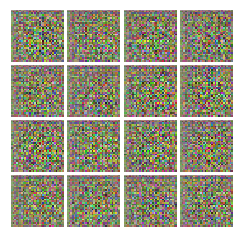

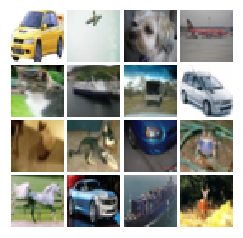


Iter: 0, D: 8.551, G:12.03
Iter: 50, D: -3.269e+03, G:1.485e+03
Iter: 100, D: -7.947e+03, G:3.759e+03
Iter: 150, D: -1.373e+04, G:6.775e+03
Iter: 200, D: -2.113e+04, G:1.053e+04


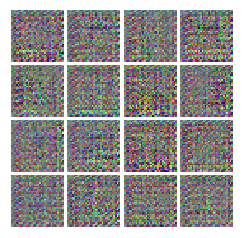

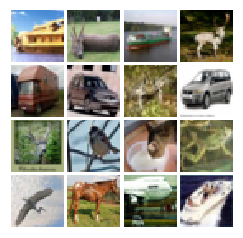


Iter: 250, D: -3.018e+04, G:1.5e+04
Iter: 300, D: -3.992e+04, G:2.004e+04
Iter: 350, D: -5.127e+04, G:2.577e+04
Iter: 400, D: -6.326e+04, G:3.194e+04
Iter: 450, D: -7.662e+04, G:3.876e+04


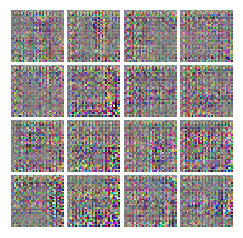

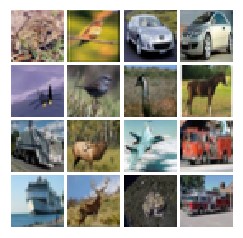


Iter: 500, D: -9.106e+04, G:4.616e+04
Iter: 550, D: -1.067e+05, G:5.415e+04
Iter: 600, D: -1.19e+05, G:6.24e+04
Iter: 650, D: -1.371e+05, G:7.105e+04
Iter: 700, D: -1.6e+05, G:8.16e+04


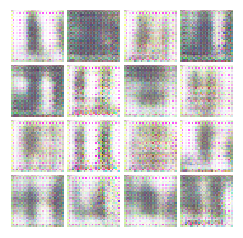

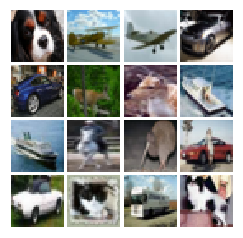


Iter: 750, D: -1.807e+05, G:9.221e+04
Iter: 800, D: -2.024e+05, G:1.032e+05
Iter: 850, D: -2.248e+05, G:1.146e+05
Iter: 900, D: -2.493e+05, G:1.271e+05
Iter: 950, D: -2.751e+05, G:1.403e+05


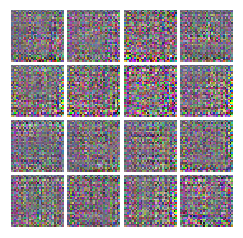

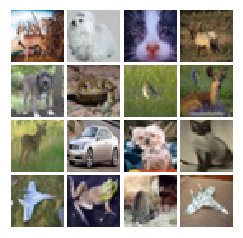


Iter: 1000, D: -3.02e+05, G:1.541e+05
Iter: 1050, D: -3.302e+05, G:1.685e+05
Iter: 1100, D: -3.598e+05, G:1.836e+05
Iter: 1150, D: -3.908e+05, G:1.995e+05
Iter: 1200, D: -4.231e+05, G:2.159e+05


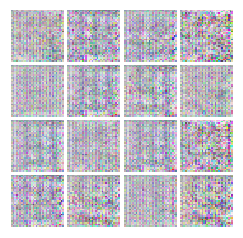

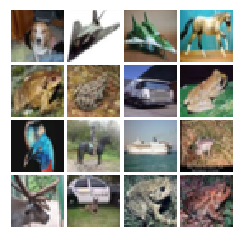


Iter: 1250, D: -4.567e+05, G:2.332e+05
Iter: 1300, D: -4.912e+05, G:2.506e+05
Iter: 1350, D: -5.278e+05, G:2.695e+05
Iter: 1400, D: -5.663e+05, G:2.89e+05
Iter: 1450, D: -6.059e+05, G:3.09e+05


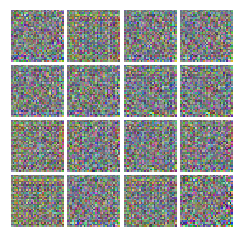

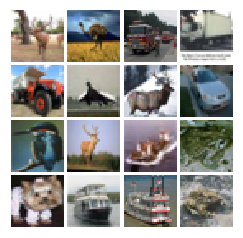


Iter: 1500, D: -6.468e+05, G:3.3e+05
Iter: 1550, D: -6.893e+05, G:3.517e+05
Iter: 1600, D: -7.332e+05, G:3.741e+05
Iter: 1650, D: -7.787e+05, G:3.973e+05
Iter: 1700, D: -8.258e+05, G:4.213e+05


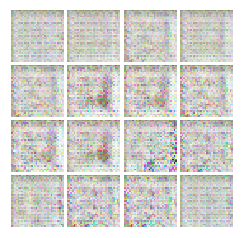

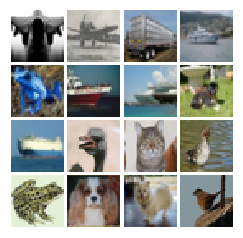


Iter: 1750, D: -8.737e+05, G:4.458e+05
Iter: 1800, D: -9.24e+05, G:4.715e+05
Iter: 1850, D: -9.763e+05, G:4.979e+05
Iter: 1900, D: -1.029e+06, G:5.248e+05
Iter: 1950, D: -1.084e+06, G:5.529e+05


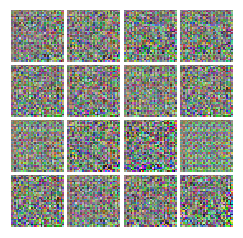

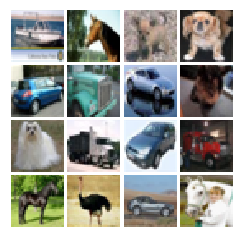


Iter: 2000, D: -1.141e+06, G:5.816e+05
Iter: 2050, D: -1.199e+06, G:6.113e+05
Iter: 2100, D: -1.259e+06, G:6.417e+05
Iter: 2150, D: -1.321e+06, G:6.731e+05
Iter: 2200, D: -1.384e+06, G:7.053e+05


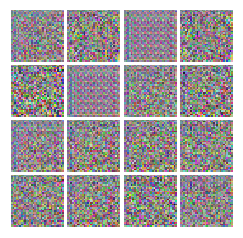

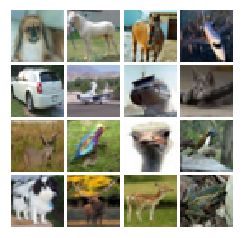


Iter: 2250, D: -1.449e+06, G:7.383e+05
Iter: 2300, D: -1.515e+06, G:7.723e+05
Iter: 2350, D: -1.584e+06, G:8.07e+05
Iter: 2400, D: -1.654e+06, G:8.427e+05
Iter: 2450, D: -1.726e+06, G:8.793e+05


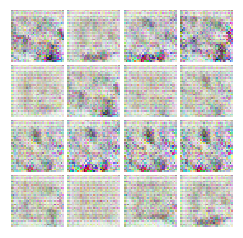

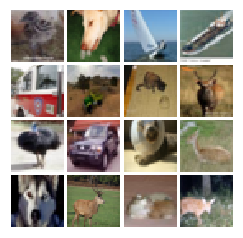


Iter: 2500, D: -1.796e+06, G:9.158e+05
Iter: 2550, D: -1.873e+06, G:9.547e+05
Iter: 2600, D: -1.952e+06, G:9.943e+05
Iter: 2650, D: -2.031e+06, G:1.035e+06
Iter: 2700, D: -2.112e+06, G:1.076e+06


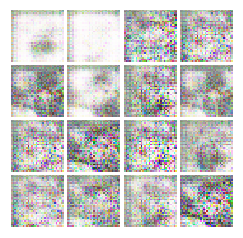

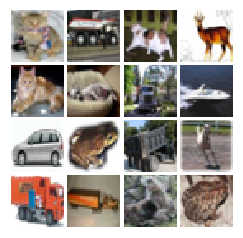


Iter: 2750, D: -2.195e+06, G:1.118e+06
Iter: 2800, D: -2.28e+06, G:1.161e+06
Iter: 2850, D: -2.367e+06, G:1.205e+06
Iter: 2900, D: -2.455e+06, G:1.25e+06
Iter: 2950, D: -2.546e+06, G:1.296e+06


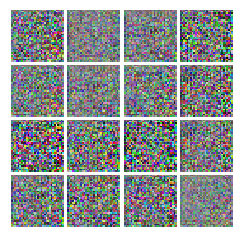

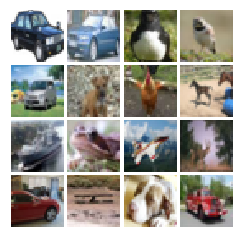


Iter: 3000, D: -2.638e+06, G:1.343e+06
Iter: 3050, D: -2.733e+06, G:1.391e+06
Iter: 3100, D: -2.829e+06, G:1.44e+06
Iter: 3150, D: -2.927e+06, G:1.489e+06
Iter: 3200, D: -3.028e+06, G:1.54e+06


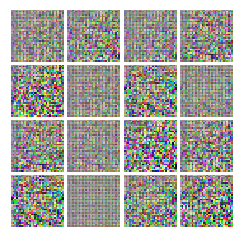

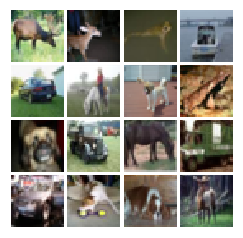


Iter: 3250, D: -3.13e+06, G:1.592e+06
Iter: 3300, D: -3.234e+06, G:1.645e+06
Iter: 3350, D: -3.341e+06, G:1.699e+06
Iter: 3400, D: -3.45e+06, G:1.754e+06
Iter: 3450, D: -3.56e+06, G:1.81e+06


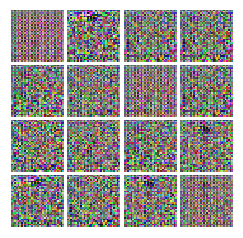

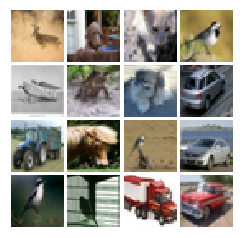


Iter: 3500, D: -3.673e+06, G:1.867e+06
Iter: 3550, D: -3.788e+06, G:1.926e+06
Iter: 3600, D: -3.904e+06, G:1.985e+06
Iter: 3650, D: -4.007e+06, G:2.043e+06
Iter: 3700, D: -4.143e+06, G:2.106e+06


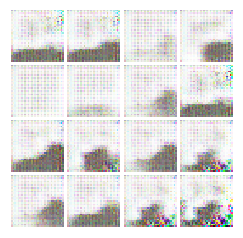

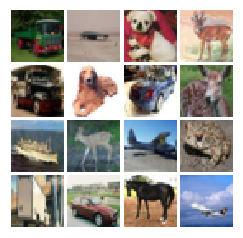


Iter: 3750, D: -4.267e+06, G:2.169e+06
Iter: 3800, D: -4.382e+06, G:2.231e+06
Iter: 3850, D: -4.521e+06, G:2.298e+06
Iter: 3900, D: -4.651e+06, G:2.364e+06
Iter: 3950, D: -4.783e+06, G:2.431e+06


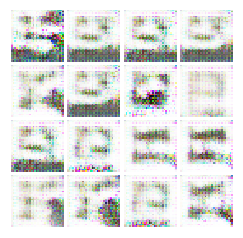

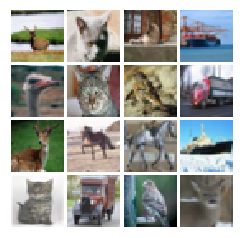


Iter: 4000, D: -4.918e+06, G:2.499e+06
Iter: 4050, D: -5.055e+06, G:2.568e+06
Iter: 4100, D: -5.194e+06, G:2.638e+06
Iter: 4150, D: -5.336e+06, G:2.71e+06
Iter: 4200, D: -5.479e+06, G:2.783e+06


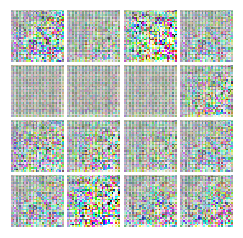

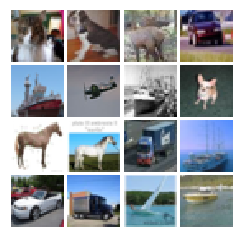


Iter: 4250, D: -5.625e+06, G:2.857e+06
Iter: 4300, D: -5.774e+06, G:2.932e+06
Iter: 4350, D: -5.924e+06, G:3.008e+06
Iter: 4400, D: -6.077e+06, G:3.085e+06
Iter: 4450, D: -6.233e+06, G:3.164e+06


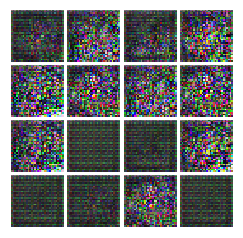

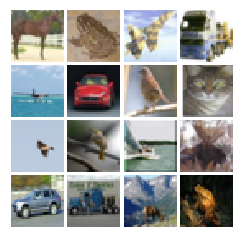


Iter: 4500, D: -6.391e+06, G:3.244e+06
Iter: 4550, D: -6.551e+06, G:3.325e+06
Iter: 4600, D: -6.714e+06, G:3.408e+06
Iter: 4650, D: -6.879e+06, G:3.491e+06
Iter: 4700, D: -7.047e+06, G:3.576e+06


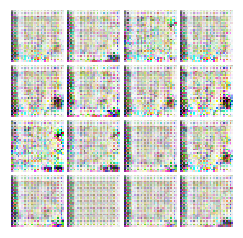

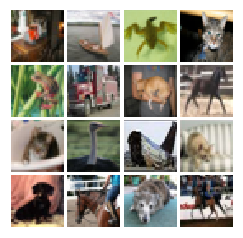


Iter: 4750, D: -7.216e+06, G:3.662e+06
Iter: 4800, D: -7.39e+06, G:3.749e+06
Iter: 4850, D: -7.564e+06, G:3.838e+06
Iter: 4900, D: -7.742e+06, G:3.928e+06
Iter: 4950, D: -7.922e+06, G:4.019e+06


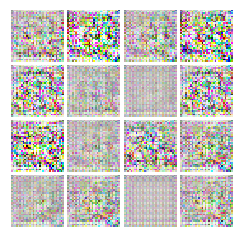

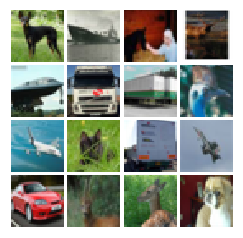


Iter: 5000, D: -8.105e+06, G:4.111e+06
Iter: 5050, D: -8.291e+06, G:4.205e+06
Iter: 5100, D: -8.479e+06, G:4.3e+06
Iter: 5150, D: -8.669e+06, G:4.397e+06
Iter: 5200, D: -8.862e+06, G:4.494e+06


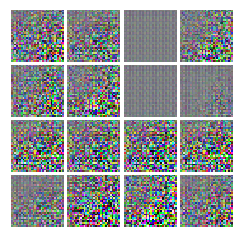

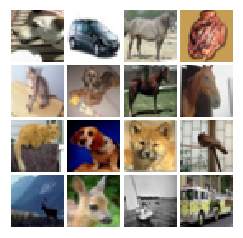


Iter: 5250, D: -9.058e+06, G:4.593e+06
Iter: 5300, D: -9.257e+06, G:4.694e+06
Iter: 5350, D: -9.458e+06, G:4.795e+06
Iter: 5400, D: -9.662e+06, G:4.898e+06
Iter: 5450, D: -9.868e+06, G:5.003e+06


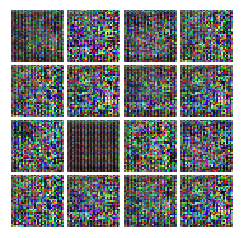

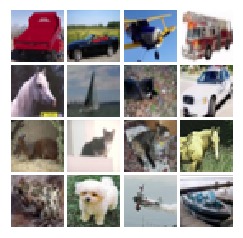


Iter: 5500, D: -1.008e+07, G:5.108e+06
Iter: 5550, D: -1.029e+07, G:5.215e+06
Iter: 5600, D: -1.05e+07, G:5.324e+06
Iter: 5650, D: -1.072e+07, G:5.434e+06
Iter: 5700, D: -1.094e+07, G:5.545e+06


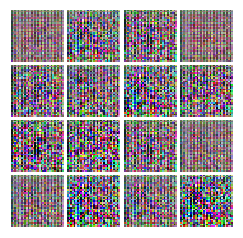

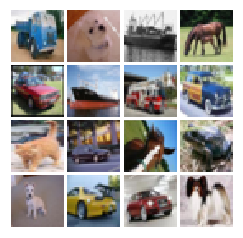


Iter: 5750, D: -1.117e+07, G:5.658e+06
Iter: 5800, D: -1.139e+07, G:5.772e+06
Iter: 5850, D: -1.162e+07, G:5.887e+06
Iter: 5900, D: -1.185e+07, G:6.004e+06
Iter: 5950, D: -1.209e+07, G:6.122e+06


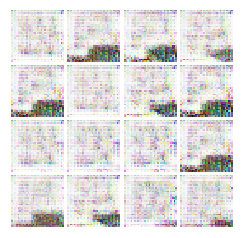

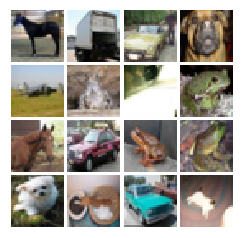


Iter: 6000, D: -1.232e+07, G:6.243e+06
Iter: 6050, D: -1.256e+07, G:6.364e+06
Iter: 6100, D: -1.281e+07, G:6.486e+06
Iter: 6150, D: -1.305e+07, G:6.611e+06
Iter: 6200, D: -1.33e+07, G:6.736e+06


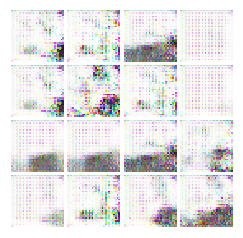

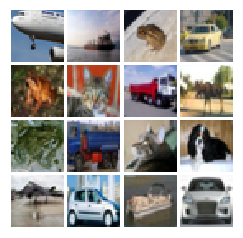


Iter: 6250, D: -1.355e+07, G:6.864e+06
Iter: 6300, D: -1.381e+07, G:6.992e+06
Iter: 6350, D: -1.407e+07, G:7.122e+06
Iter: 6400, D: -1.433e+07, G:7.254e+06
Iter: 6450, D: -1.459e+07, G:7.387e+06


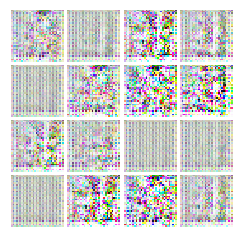

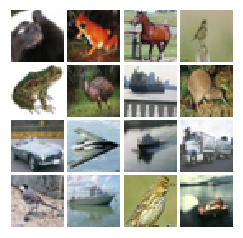


Iter: 6500, D: -1.486e+07, G:7.522e+06
Iter: 6550, D: -1.513e+07, G:7.658e+06
Iter: 6600, D: -1.54e+07, G:7.796e+06
Iter: 6650, D: -1.568e+07, G:7.935e+06
Iter: 6700, D: -1.596e+07, G:8.076e+06


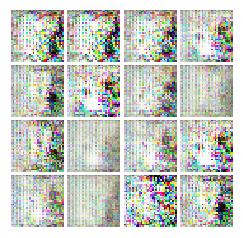

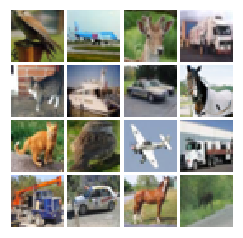


Iter: 6750, D: -1.624e+07, G:8.219e+06
Iter: 6800, D: -1.652e+07, G:8.363e+06
Iter: 6850, D: -1.681e+07, G:8.508e+06
Iter: 6900, D: -1.71e+07, G:8.655e+06
Iter: 6950, D: -1.74e+07, G:8.804e+06


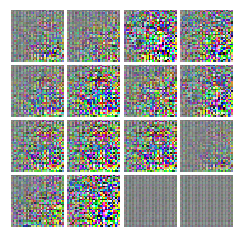

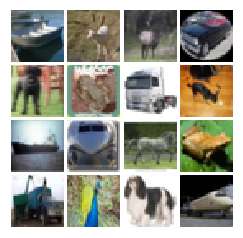


Iter: 7000, D: -1.77e+07, G:8.954e+06
Iter: 7050, D: -1.8e+07, G:9.106e+06
Iter: 7100, D: -1.83e+07, G:9.26e+06
Iter: 7150, D: -1.861e+07, G:9.415e+06
Iter: 7200, D: -1.892e+07, G:9.572e+06


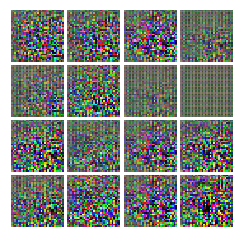

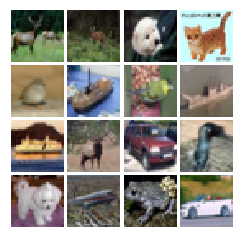


Iter: 7250, D: -1.924e+07, G:9.73e+06
Iter: 7300, D: -1.955e+07, G:9.89e+06
Iter: 7350, D: -1.987e+07, G:1.005e+07
Iter: 7400, D: -2.02e+07, G:1.022e+07
Iter: 7450, D: -2.053e+07, G:1.038e+07


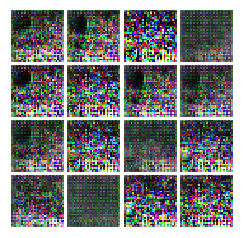

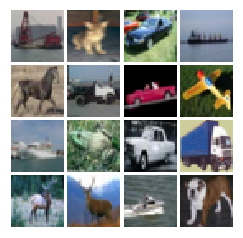


Iter: 7500, D: -2.086e+07, G:1.055e+07
Iter: 7550, D: -2.119e+07, G:1.072e+07
Iter: 7600, D: -2.153e+07, G:1.089e+07
Iter: 7650, D: -2.187e+07, G:1.106e+07
Iter: 7700, D: -2.221e+07, G:1.123e+07


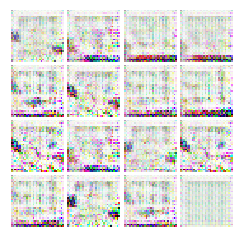

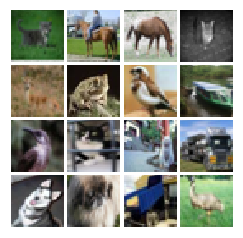


Iter: 7750, D: -2.256e+07, G:1.141e+07
Iter: 7800, D: -2.291e+07, G:1.158e+07
Iter: 7850, D: -2.327e+07, G:1.176e+07
Iter: 7900, D: -2.363e+07, G:1.194e+07
Iter: 7950, D: -2.399e+07, G:1.212e+07


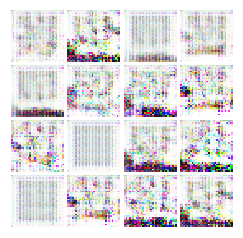

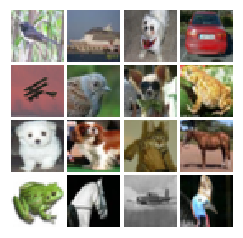


Iter: 8000, D: -2.435e+07, G:1.231e+07
Iter: 8050, D: -2.472e+07, G:1.249e+07
Iter: 8100, D: -2.509e+07, G:1.268e+07
Iter: 8150, D: -2.547e+07, G:1.287e+07
Iter: 8200, D: -2.585e+07, G:1.306e+07


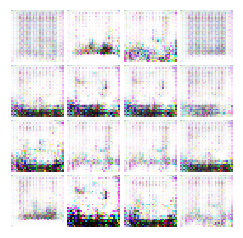

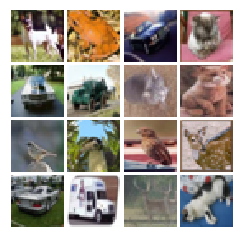


Iter: 8250, D: -2.623e+07, G:1.325e+07
Iter: 8300, D: -2.662e+07, G:1.345e+07
Iter: 8350, D: -2.701e+07, G:1.364e+07
Iter: 8400, D: -2.74e+07, G:1.384e+07
Iter: 8450, D: -2.78e+07, G:1.404e+07


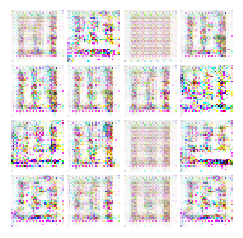

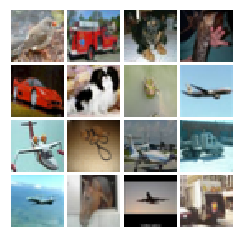


Iter: 8500, D: -2.82e+07, G:1.424e+07
Iter: 8550, D: -2.86e+07, G:1.445e+07
Iter: 8600, D: -2.901e+07, G:1.465e+07
Iter: 8650, D: -2.942e+07, G:1.486e+07
Iter: 8700, D: -2.984e+07, G:1.507e+07


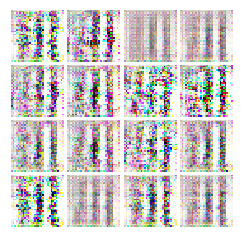

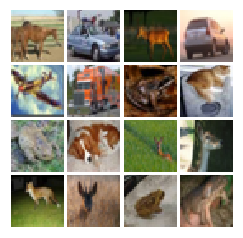


Iter: 8750, D: -3.026e+07, G:1.528e+07
Iter: 8800, D: -3.068e+07, G:1.549e+07
Iter: 8850, D: -3.111e+07, G:1.571e+07
Iter: 8900, D: -3.154e+07, G:1.592e+07
Iter: 8950, D: -3.197e+07, G:1.614e+07


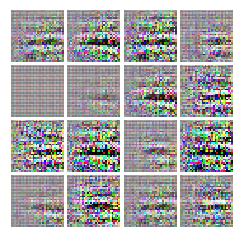

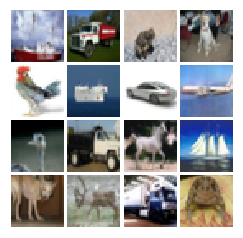


Iter: 9000, D: -3.241e+07, G:1.636e+07
Iter: 9050, D: -3.285e+07, G:1.659e+07
Iter: 9100, D: -3.33e+07, G:1.681e+07
Iter: 9150, D: -3.375e+07, G:1.704e+07
Iter: 9200, D: -3.42e+07, G:1.726e+07


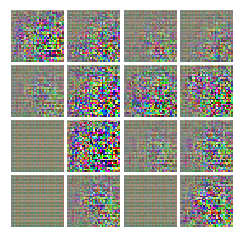

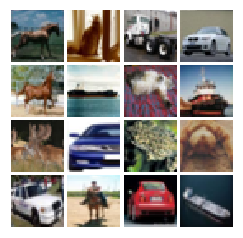


Iter: 9250, D: -3.466e+07, G:1.749e+07
Iter: 9300, D: -3.512e+07, G:1.773e+07
Iter: 9350, D: -3.558e+07, G:1.796e+07
Iter: 9400, D: -3.605e+07, G:1.82e+07
Iter: 9450, D: -3.653e+07, G:1.843e+07


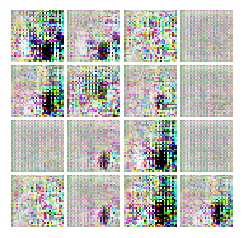

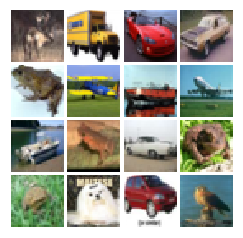


Iter: 9500, D: -3.7e+07, G:1.867e+07
Iter: 9550, D: -3.748e+07, G:1.892e+07
Iter: 9600, D: -3.797e+07, G:1.916e+07
Iter: 9650, D: -3.846e+07, G:1.941e+07
Iter: 9700, D: -3.895e+07, G:1.965e+07


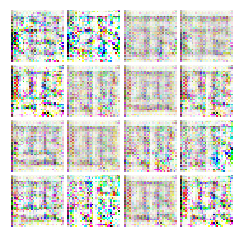

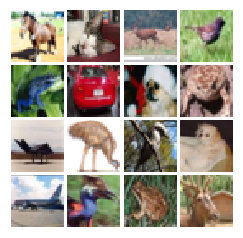


Iter: 9750, D: -3.945e+07, G:1.99e+07
Iter: 9800, D: -3.995e+07, G:2.016e+07
Iter: 9850, D: -4.046e+07, G:2.041e+07
Iter: 9900, D: -4.096e+07, G:2.067e+07
Iter: 9950, D: -4.148e+07, G:2.092e+07


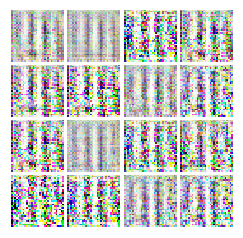

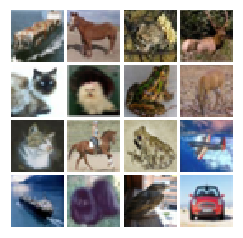


Iter: 10000, D: -4.2e+07, G:2.119e+07
Iter: 10050, D: -4.252e+07, G:2.145e+07
Iter: 10100, D: -4.304e+07, G:2.171e+07
Iter: 10150, D: -4.357e+07, G:2.198e+07
Iter: 10200, D: -4.411e+07, G:2.225e+07


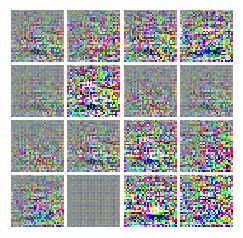

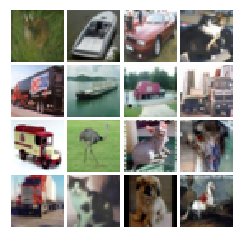


Iter: 10250, D: -4.465e+07, G:2.252e+07
Iter: 10300, D: -4.519e+07, G:2.279e+07
Iter: 10350, D: -4.574e+07, G:2.307e+07
Iter: 10400, D: -4.629e+07, G:2.334e+07
Iter: 10450, D: -4.684e+07, G:2.362e+07


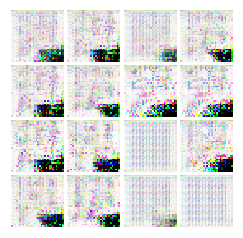

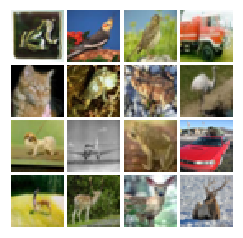


Iter: 10500, D: -4.74e+07, G:2.39e+07
Iter: 10550, D: -4.797e+07, G:2.419e+07
Iter: 10600, D: -4.853e+07, G:2.447e+07
Iter: 10650, D: -4.911e+07, G:2.476e+07
Iter: 10700, D: -4.968e+07, G:2.505e+07


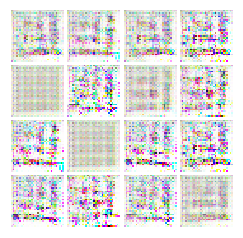

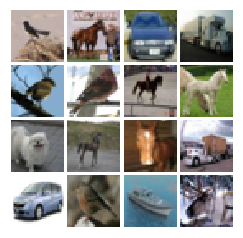


Iter: 10750, D: -5.026e+07, G:2.534e+07
Iter: 10800, D: -5.085e+07, G:2.564e+07
Iter: 10850, D: -5.144e+07, G:2.593e+07
Iter: 10900, D: -5.203e+07, G:2.623e+07
Iter: 10950, D: -5.263e+07, G:2.653e+07


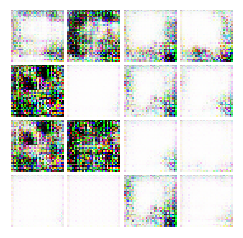

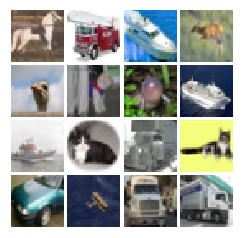


Iter: 11000, D: -5.324e+07, G:2.683e+07
Iter: 11050, D: -5.384e+07, G:2.714e+07
Iter: 11100, D: -5.446e+07, G:2.745e+07
Iter: 11150, D: -5.507e+07, G:2.776e+07
Iter: 11200, D: -5.569e+07, G:2.807e+07


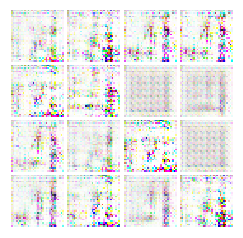

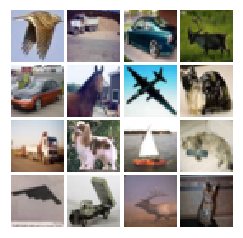


Iter: 11250, D: -5.632e+07, G:2.838e+07
Iter: 11300, D: -5.695e+07, G:2.87e+07
Iter: 11350, D: -5.758e+07, G:2.902e+07
Iter: 11400, D: -5.822e+07, G:2.934e+07
Iter: 11450, D: -5.887e+07, G:2.966e+07


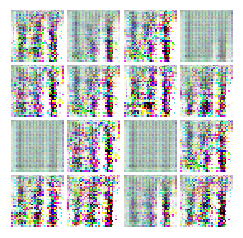

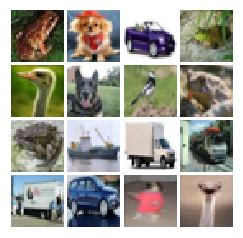


Iter: 11500, D: -5.952e+07, G:2.999e+07
Iter: 11550, D: -6.017e+07, G:3.032e+07
Iter: 11600, D: -6.083e+07, G:3.065e+07
Iter: 11650, D: -6.149e+07, G:3.098e+07
Iter: 11700, D: -6.216e+07, G:3.131e+07


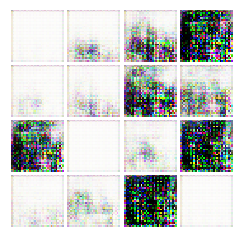

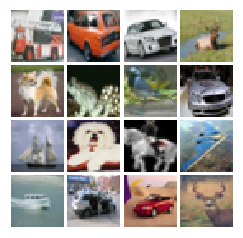


Iter: 11750, D: -6.283e+07, G:3.165e+07
Iter: 11800, D: -6.35e+07, G:3.199e+07
Iter: 11850, D: -6.419e+07, G:3.233e+07
Iter: 11900, D: -6.487e+07, G:3.268e+07
Iter: 11950, D: -6.556e+07, G:3.302e+07


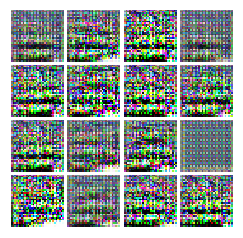

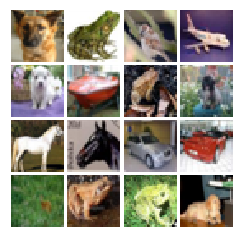


Iter: 12000, D: -6.626e+07, G:3.337e+07
Iter: 12050, D: -6.696e+07, G:3.372e+07
Iter: 12100, D: -6.766e+07, G:3.408e+07
Iter: 12150, D: -6.837e+07, G:3.443e+07
Iter: 12200, D: -6.908e+07, G:3.479e+07


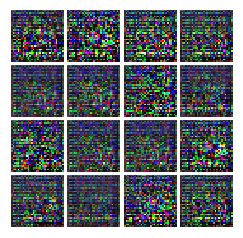

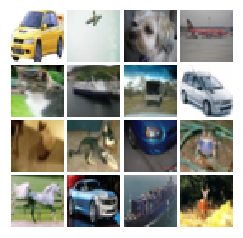


Iter: 12250, D: -6.98e+07, G:3.515e+07
Iter: 12300, D: -7.053e+07, G:3.552e+07
Iter: 12350, D: -7.126e+07, G:3.588e+07
Iter: 12400, D: -7.199e+07, G:3.625e+07
Iter: 12450, D: -7.273e+07, G:3.662e+07


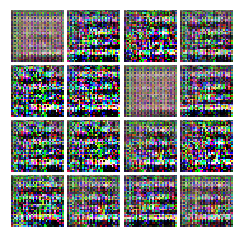

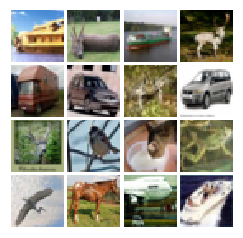


Iter: 12500, D: -7.347e+07, G:3.699e+07
Iter: 12550, D: -7.422e+07, G:3.737e+07
Iter: 12600, D: -7.497e+07, G:3.775e+07
Iter: 12650, D: -7.573e+07, G:3.813e+07
Iter: 12700, D: -7.649e+07, G:3.851e+07


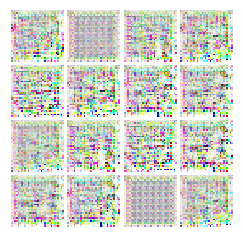

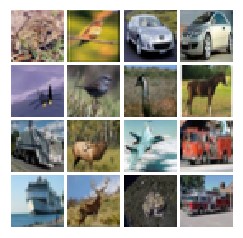


Iter: 12750, D: -7.726e+07, G:3.89e+07
Iter: 12800, D: -7.804e+07, G:3.928e+07
Iter: 12850, D: -7.881e+07, G:3.967e+07
Iter: 12900, D: -7.96e+07, G:4.007e+07
Iter: 12950, D: -8.038e+07, G:4.046e+07


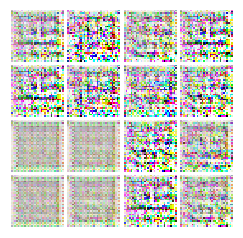

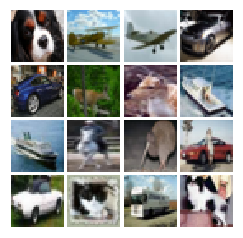


Iter: 13000, D: -8.118e+07, G:4.086e+07
Iter: 13050, D: -8.198e+07, G:4.126e+07
Iter: 13100, D: -8.278e+07, G:4.166e+07
Iter: 13150, D: -8.359e+07, G:4.207e+07
Iter: 13200, D: -8.44e+07, G:4.248e+07


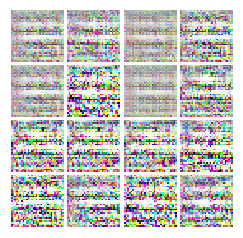

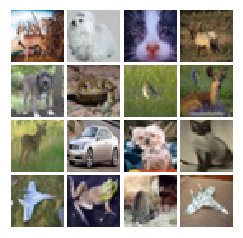


Iter: 13250, D: -8.522e+07, G:4.289e+07
Iter: 13300, D: -8.604e+07, G:4.33e+07
Iter: 13350, D: -8.687e+07, G:4.372e+07
Iter: 13400, D: -8.771e+07, G:4.414e+07
Iter: 13450, D: -8.855e+07, G:4.456e+07


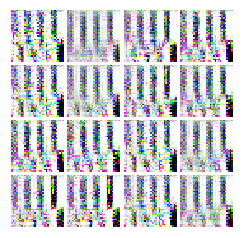

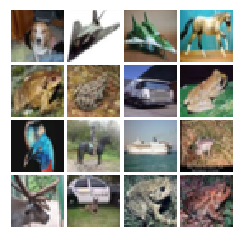


Iter: 13500, D: -8.939e+07, G:4.498e+07
Iter: 13550, D: -9.024e+07, G:4.541e+07
Iter: 13600, D: -9.11e+07, G:4.584e+07
Iter: 13650, D: -9.196e+07, G:4.627e+07
Iter: 13700, D: -9.282e+07, G:4.67e+07


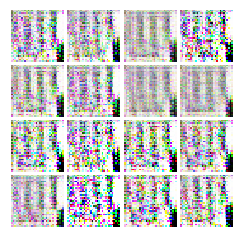

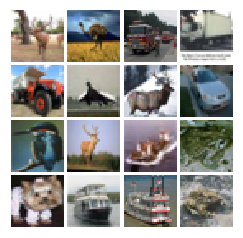


Iter: 13750, D: -9.369e+07, G:4.714e+07
Iter: 13800, D: -9.457e+07, G:4.758e+07
Iter: 13850, D: -9.545e+07, G:4.802e+07
Iter: 13900, D: -9.634e+07, G:4.846e+07
Iter: 13950, D: -9.723e+07, G:4.891e+07


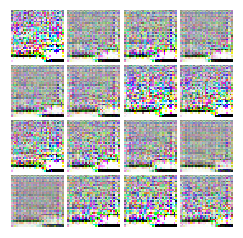

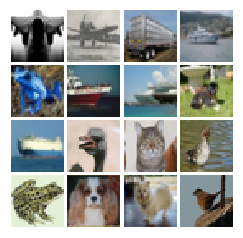


Iter: 14000, D: -9.813e+07, G:4.936e+07
Iter: 14050, D: -9.903e+07, G:4.981e+07
Iter: 14100, D: -9.994e+07, G:5.027e+07
Iter: 14150, D: -1.009e+08, G:5.073e+07
Iter: 14200, D: -1.018e+08, G:5.119e+07


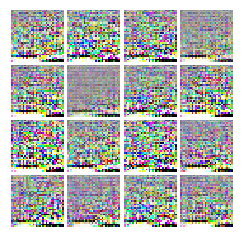

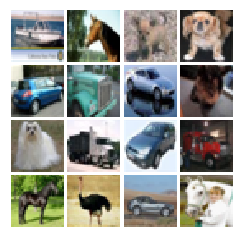


Iter: 14250, D: -1.027e+08, G:5.165e+07
Iter: 14300, D: -1.036e+08, G:5.212e+07
Iter: 14350, D: -1.046e+08, G:5.259e+07
Iter: 14400, D: -1.055e+08, G:5.306e+07
Iter: 14450, D: -1.065e+08, G:5.353e+07


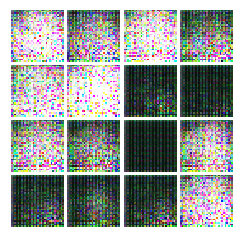

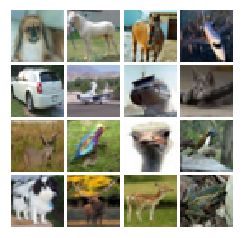


Iter: 14500, D: -1.074e+08, G:5.401e+07
Iter: 14550, D: -1.084e+08, G:5.449e+07
Iter: 14600, D: -1.093e+08, G:5.497e+07
Iter: 14650, D: -1.103e+08, G:5.546e+07
Iter: 14700, D: -1.113e+08, G:5.595e+07


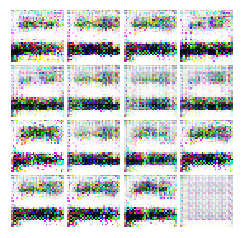

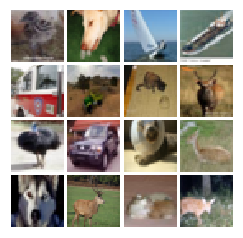


Iter: 14750, D: -1.122e+08, G:5.644e+07
Iter: 14800, D: -1.132e+08, G:5.693e+07
Iter: 14850, D: -1.142e+08, G:5.743e+07
Iter: 14900, D: -1.152e+08, G:5.793e+07
Iter: 14950, D: -1.162e+08, G:5.843e+07


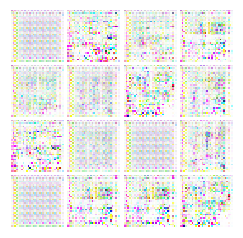

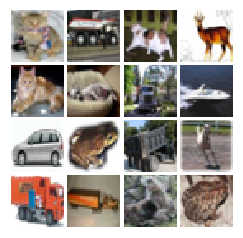


Iter: 15000, D: -1.172e+08, G:5.894e+07
Iter: 15050, D: -1.182e+08, G:5.945e+07
Iter: 15100, D: -1.193e+08, G:5.996e+07
Iter: 15150, D: -1.203e+08, G:6.047e+07
Iter: 15200, D: -1.213e+08, G:6.099e+07


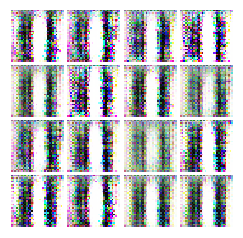

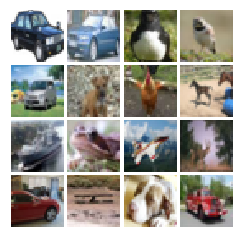


Iter: 15250, D: -1.224e+08, G:6.151e+07
Iter: 15300, D: -1.234e+08, G:6.203e+07
Iter: 15350, D: -1.244e+08, G:6.256e+07
Iter: 15400, D: -1.255e+08, G:6.308e+07
Iter: 15450, D: -1.266e+08, G:6.361e+07


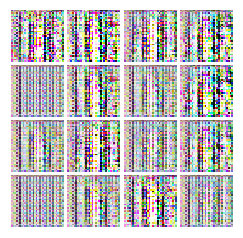

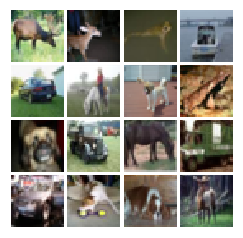


Iter: 15500, D: -1.276e+08, G:6.415e+07
Iter: 15550, D: -1.287e+08, G:6.469e+07
Iter: 15600, D: -1.298e+08, G:6.522e+07
Iter: 15650, D: -1.309e+08, G:6.577e+07
Iter: 15700, D: -1.319e+08, G:6.631e+07


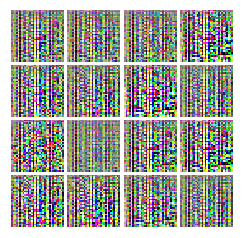

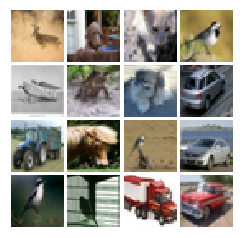


Iter: 15750, D: -1.33e+08, G:6.686e+07
Iter: 15800, D: -1.341e+08, G:6.741e+07
Iter: 15850, D: -1.353e+08, G:6.797e+07
Iter: 15900, D: -1.364e+08, G:6.853e+07
Iter: 15950, D: -1.375e+08, G:6.909e+07


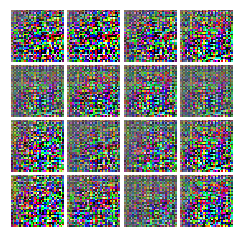

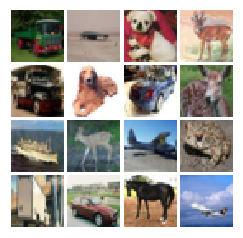


Iter: 16000, D: -1.386e+08, G:6.965e+07
Iter: 16050, D: -1.397e+08, G:7.022e+07
Iter: 16100, D: -1.409e+08, G:7.079e+07
Iter: 16150, D: -1.42e+08, G:7.136e+07
Iter: 16200, D: -1.432e+08, G:7.193e+07


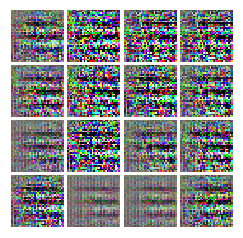

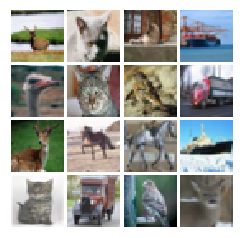


Iter: 16250, D: -1.443e+08, G:7.251e+07
Iter: 16300, D: -1.455e+08, G:7.309e+07
Iter: 16350, D: -1.467e+08, G:7.368e+07
Iter: 16400, D: -1.478e+08, G:7.427e+07
Iter: 16450, D: -1.49e+08, G:7.486e+07


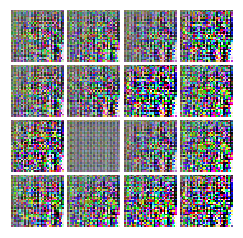

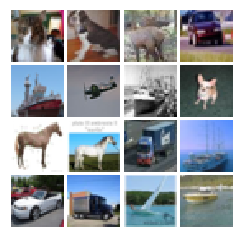


Iter: 16500, D: -1.502e+08, G:7.545e+07
Iter: 16550, D: -1.514e+08, G:7.605e+07
Iter: 16600, D: -1.526e+08, G:7.665e+07
Iter: 16650, D: -1.538e+08, G:7.725e+07
Iter: 16700, D: -1.55e+08, G:7.786e+07


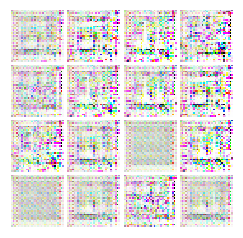

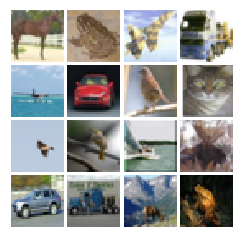


Iter: 16750, D: -1.562e+08, G:7.847e+07
Iter: 16800, D: -1.574e+08, G:7.908e+07
Iter: 16850, D: -1.587e+08, G:7.969e+07
Iter: 16900, D: -1.599e+08, G:8.031e+07
Iter: 16950, D: -1.611e+08, G:8.094e+07


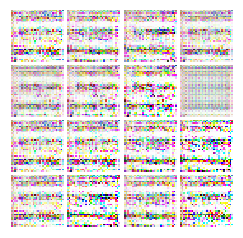

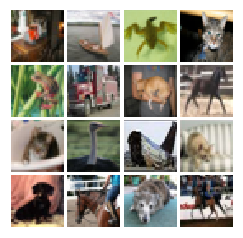


Iter: 17000, D: -1.624e+08, G:8.156e+07
Iter: 17050, D: -1.636e+08, G:8.219e+07
Iter: 17100, D: -1.649e+08, G:8.282e+07
Iter: 17150, D: -1.662e+08, G:8.345e+07
Iter: 17200, D: -1.674e+08, G:8.409e+07


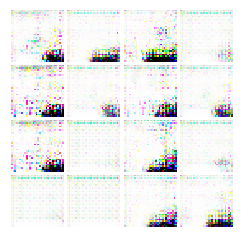

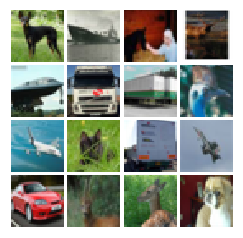


Iter: 17250, D: -1.687e+08, G:8.473e+07
Iter: 17300, D: -1.7e+08, G:8.537e+07
Iter: 17350, D: -1.713e+08, G:8.602e+07
Iter: 17400, D: -1.726e+08, G:8.667e+07
Iter: 17450, D: -1.739e+08, G:8.733e+07


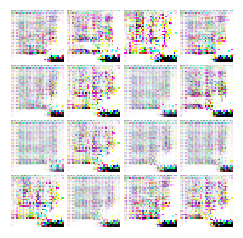

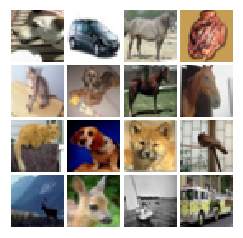


Iter: 17500, D: -1.752e+08, G:8.798e+07
Iter: 17550, D: -1.765e+08, G:8.864e+07
Iter: 17600, D: -1.779e+08, G:8.93e+07
Iter: 17650, D: -1.792e+08, G:8.997e+07
Iter: 17700, D: -1.805e+08, G:9.064e+07


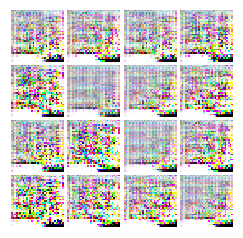

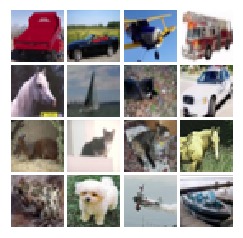


Iter: 17750, D: -1.819e+08, G:9.131e+07
Iter: 17800, D: -1.832e+08, G:9.199e+07
Iter: 17850, D: -1.846e+08, G:9.267e+07
Iter: 17900, D: -1.859e+08, G:9.335e+07
Iter: 17950, D: -1.873e+08, G:9.404e+07


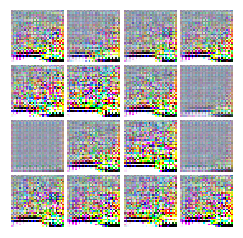

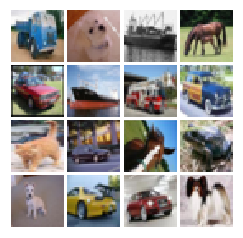


Iter: 18000, D: -1.887e+08, G:9.473e+07
Iter: 18050, D: -1.901e+08, G:9.542e+07
Iter: 18100, D: -1.915e+08, G:9.611e+07
Iter: 18150, D: -1.929e+08, G:9.681e+07
Iter: 18200, D: -1.943e+08, G:9.751e+07


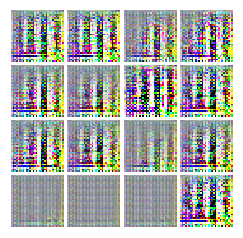

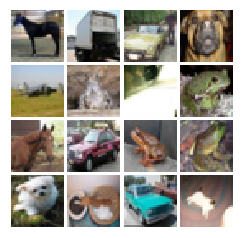


Iter: 18250, D: -1.957e+08, G:9.822e+07
Iter: 18300, D: -1.971e+08, G:9.893e+07
Iter: 18350, D: -1.985e+08, G:9.964e+07
Iter: 18400, D: -1.999e+08, G:1.004e+08
Iter: 18450, D: -2.014e+08, G:1.011e+08


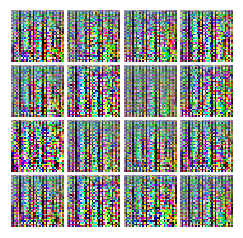

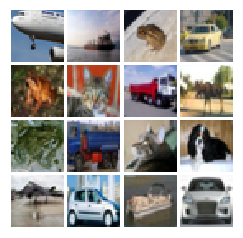


Iter: 18500, D: -2.028e+08, G:1.018e+08
Iter: 18550, D: -2.043e+08, G:1.025e+08
Iter: 18600, D: -2.057e+08, G:1.033e+08
Iter: 18650, D: -2.072e+08, G:1.04e+08
Iter: 18700, D: -2.087e+08, G:1.047e+08


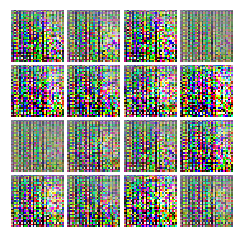

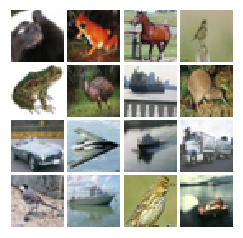


Iter: 18750, D: -2.101e+08, G:1.055e+08
Iter: 18800, D: -2.116e+08, G:1.062e+08
Iter: 18850, D: -2.131e+08, G:1.069e+08
Iter: 18900, D: -2.146e+08, G:1.077e+08
Iter: 18950, D: -2.161e+08, G:1.085e+08


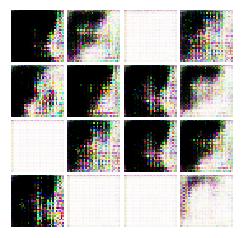

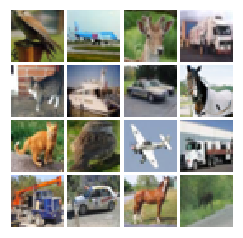


Iter: 19000, D: -2.176e+08, G:1.092e+08
Iter: 19050, D: -2.191e+08, G:1.1e+08
Iter: 19100, D: -2.207e+08, G:1.107e+08
Iter: 19150, D: -2.222e+08, G:1.115e+08
Iter: 19200, D: -2.237e+08, G:1.123e+08


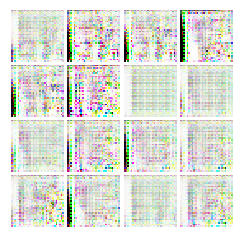

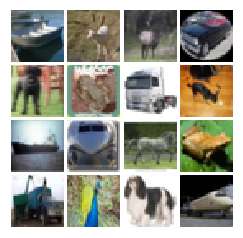


Iter: 19250, D: -2.253e+08, G:1.13e+08
Iter: 19300, D: -2.268e+08, G:1.138e+08
Iter: 19350, D: -2.284e+08, G:1.146e+08
Iter: 19400, D: -2.3e+08, G:1.154e+08
Iter: 19450, D: -2.315e+08, G:1.162e+08


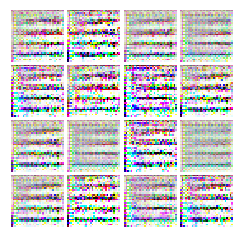

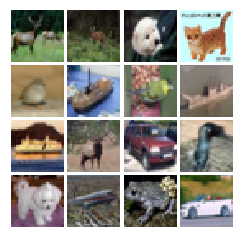


Iter: 19500, D: -2.331e+08, G:1.17e+08
Iter: 19550, D: -2.347e+08, G:1.178e+08
Iter: 19600, D: -2.363e+08, G:1.186e+08
Iter: 19650, D: -2.379e+08, G:1.194e+08
Iter: 19700, D: -2.395e+08, G:1.202e+08


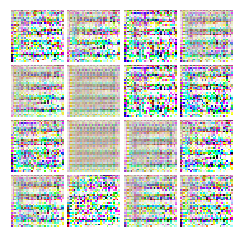

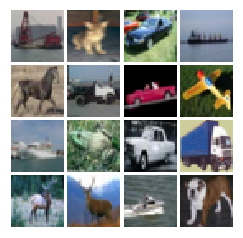


Iter: 19750, D: -2.412e+08, G:1.21e+08
Iter: 19800, D: -2.428e+08, G:1.218e+08
Iter: 19850, D: -2.444e+08, G:1.226e+08
Iter: 19900, D: -2.46e+08, G:1.234e+08
Iter: 19950, D: -2.477e+08, G:1.243e+08


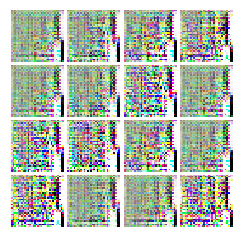

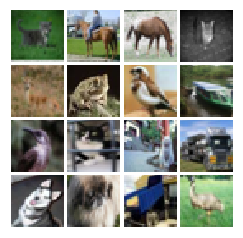


Iter: 20000, D: -2.493e+08, G:1.251e+08
Iter: 20050, D: -2.51e+08, G:1.259e+08
Iter: 20100, D: -2.527e+08, G:1.267e+08
Iter: 20150, D: -2.544e+08, G:1.276e+08
Iter: 20200, D: -2.56e+08, G:1.284e+08


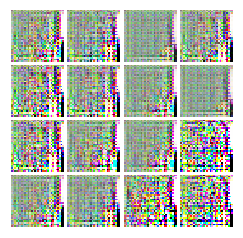

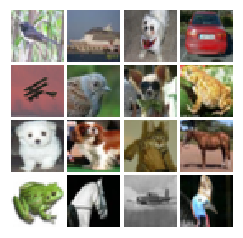


Iter: 20250, D: -2.577e+08, G:1.293e+08
Iter: 20300, D: -2.594e+08, G:1.301e+08
Iter: 20350, D: -2.611e+08, G:1.31e+08
Iter: 20400, D: -2.628e+08, G:1.318e+08
Iter: 20450, D: -2.646e+08, G:1.327e+08


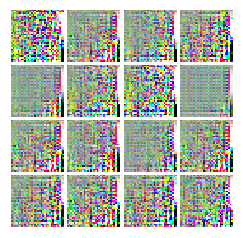

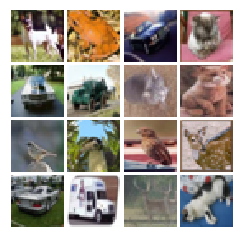


Iter: 20500, D: -2.663e+08, G:1.336e+08
Iter: 20550, D: -2.68e+08, G:1.344e+08
Iter: 20600, D: -2.698e+08, G:1.353e+08
Iter: 20650, D: -2.715e+08, G:1.362e+08
Iter: 20700, D: -2.733e+08, G:1.37e+08


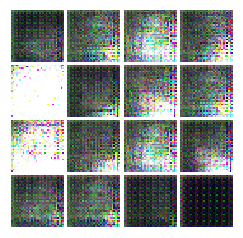

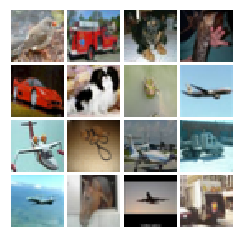


Iter: 20750, D: -2.75e+08, G:1.379e+08
Iter: 20800, D: -2.768e+08, G:1.388e+08
Iter: 20850, D: -2.786e+08, G:1.397e+08
Iter: 20900, D: -2.804e+08, G:1.406e+08
Iter: 20950, D: -2.822e+08, G:1.415e+08


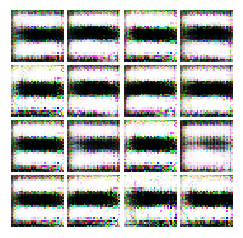

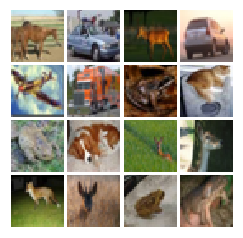


Iter: 21000, D: -2.84e+08, G:1.424e+08
Iter: 21050, D: -2.858e+08, G:1.433e+08
Iter: 21100, D: -2.876e+08, G:1.442e+08
Iter: 21150, D: -2.894e+08, G:1.451e+08
Iter: 21200, D: -2.913e+08, G:1.46e+08


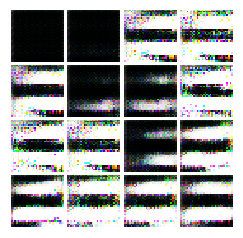

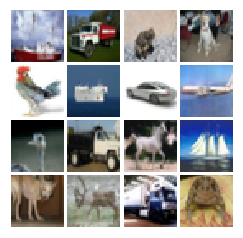


Iter: 21250, D: -2.931e+08, G:1.47e+08
Iter: 21300, D: -2.95e+08, G:1.479e+08
Iter: 21350, D: -2.968e+08, G:1.488e+08
Iter: 21400, D: -2.987e+08, G:1.497e+08
Iter: 21450, D: -3.005e+08, G:1.507e+08


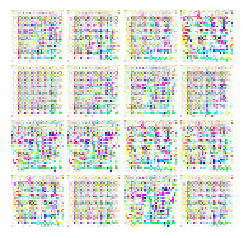

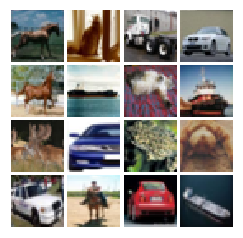


Iter: 21500, D: -3.024e+08, G:1.516e+08
Iter: 21550, D: -3.043e+08, G:1.526e+08
Iter: 21600, D: -3.062e+08, G:1.535e+08
Iter: 21650, D: -3.081e+08, G:1.545e+08
Iter: 21700, D: -3.1e+08, G:1.554e+08


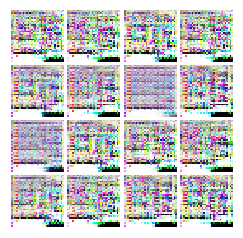

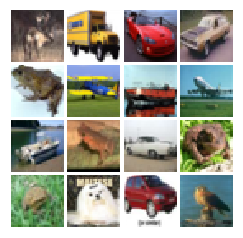


Iter: 21750, D: -3.119e+08, G:1.564e+08
Iter: 21800, D: -3.139e+08, G:1.573e+08
Iter: 21850, D: -3.158e+08, G:1.583e+08
Iter: 21900, D: -3.177e+08, G:1.593e+08
Iter: 21950, D: -3.197e+08, G:1.603e+08


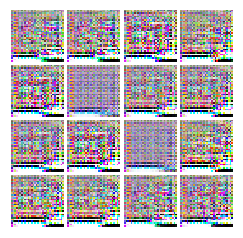

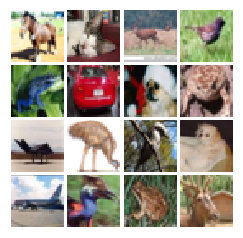


Iter: 22000, D: -3.216e+08, G:1.612e+08
Iter: 22050, D: -3.236e+08, G:1.622e+08
Iter: 22100, D: -3.256e+08, G:1.632e+08
Iter: 22150, D: -3.276e+08, G:1.642e+08
Iter: 22200, D: -3.296e+08, G:1.652e+08


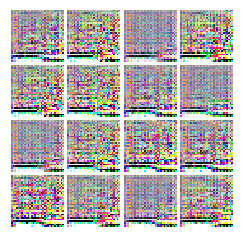

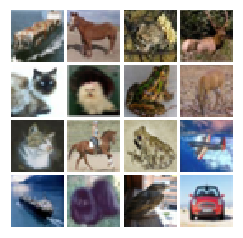


Iter: 22250, D: -3.315e+08, G:1.662e+08
Iter: 22300, D: -3.336e+08, G:1.672e+08
Iter: 22350, D: -3.356e+08, G:1.682e+08
Iter: 22400, D: -3.376e+08, G:1.692e+08
Iter: 22450, D: -3.396e+08, G:1.702e+08


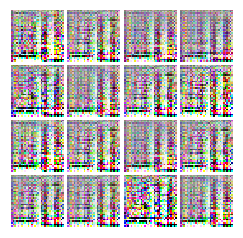

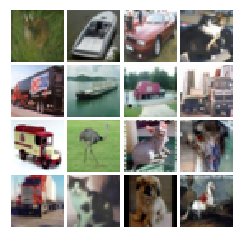


Iter: 22500, D: -3.416e+08, G:1.712e+08
Iter: 22550, D: -3.437e+08, G:1.723e+08
Iter: 22600, D: -3.457e+08, G:1.733e+08
Iter: 22650, D: -3.478e+08, G:1.743e+08
Iter: 22700, D: -3.499e+08, G:1.753e+08


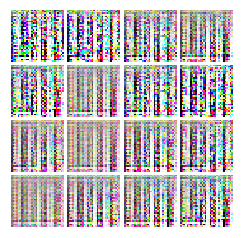

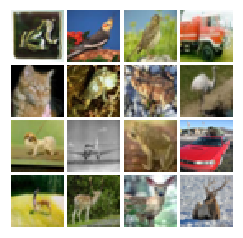


Iter: 22750, D: -3.52e+08, G:1.764e+08
Iter: 22800, D: -3.54e+08, G:1.774e+08
Iter: 22850, D: -3.561e+08, G:1.785e+08
Iter: 22900, D: -3.582e+08, G:1.795e+08
Iter: 22950, D: -3.603e+08, G:1.806e+08


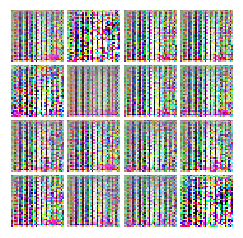

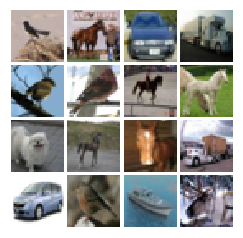


Iter: 23000, D: -3.625e+08, G:1.816e+08
Iter: 23050, D: -3.646e+08, G:1.827e+08
Iter: 23100, D: -3.667e+08, G:1.838e+08
Iter: 23150, D: -3.689e+08, G:1.848e+08
Iter: 23200, D: -3.71e+08, G:1.859e+08


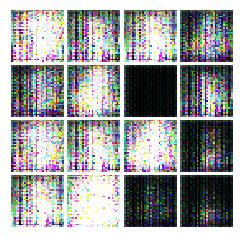

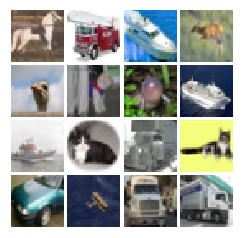


Iter: 23250, D: -3.732e+08, G:1.87e+08
Iter: 23300, D: -3.753e+08, G:1.881e+08
Iter: 23350, D: -3.775e+08, G:1.892e+08
Iter: 23400, D: -3.797e+08, G:1.902e+08
Iter: 23450, D: -3.819e+08, G:1.913e+08


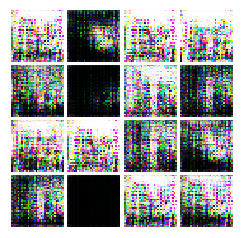

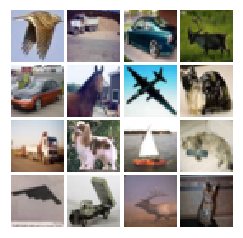


Iter: 23500, D: -3.841e+08, G:1.924e+08
Iter: 23550, D: -3.863e+08, G:1.935e+08
Iter: 23600, D: -3.885e+08, G:1.946e+08
Iter: 23650, D: -3.907e+08, G:1.958e+08
Iter: 23700, D: -3.93e+08, G:1.969e+08


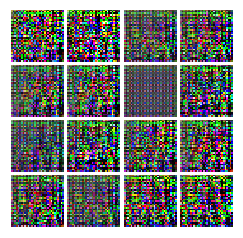

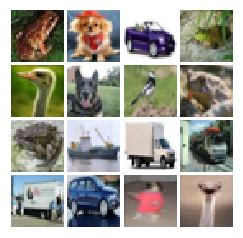


Iter: 23750, D: -3.952e+08, G:1.98e+08
Iter: 23800, D: -3.975e+08, G:1.991e+08
Iter: 23850, D: -3.997e+08, G:2.002e+08
Iter: 23900, D: -4.02e+08, G:2.014e+08
Iter: 23950, D: -4.043e+08, G:2.025e+08


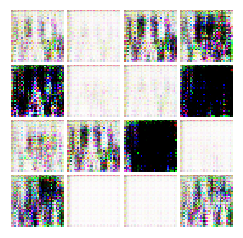

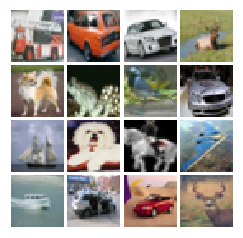


Iter: 24000, D: -4.065e+08, G:2.037e+08
Iter: 24050, D: -4.088e+08, G:2.048e+08
Iter: 24100, D: -4.111e+08, G:2.06e+08
Iter: 24150, D: -4.134e+08, G:2.071e+08
Iter: 24200, D: -4.158e+08, G:2.083e+08


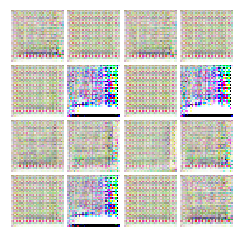

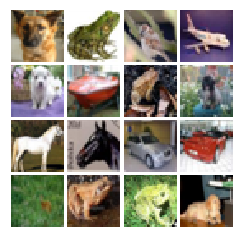


Iter: 24250, D: -4.181e+08, G:2.094e+08
Iter: 24300, D: -4.204e+08, G:2.106e+08
Iter: 24350, D: -4.228e+08, G:2.118e+08
Iter: 24400, D: -4.251e+08, G:2.129e+08
Iter: 24450, D: -4.275e+08, G:2.141e+08


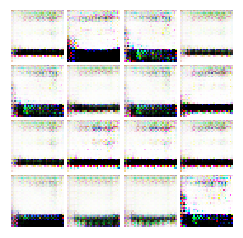

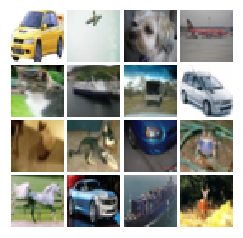


Iter: 24500, D: -4.299e+08, G:2.153e+08
Iter: 24550, D: -4.322e+08, G:2.165e+08
Iter: 24600, D: -4.346e+08, G:2.177e+08
Iter: 24650, D: -4.37e+08, G:2.189e+08
Iter: 24700, D: -4.394e+08, G:2.201e+08


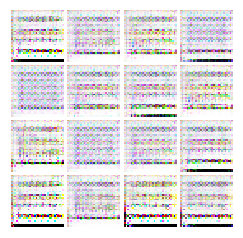

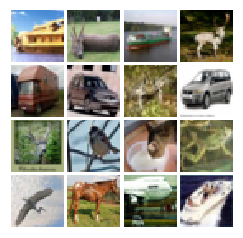


Iter: 24750, D: -4.418e+08, G:2.213e+08
Iter: 24800, D: -4.443e+08, G:2.225e+08
Iter: 24850, D: -4.467e+08, G:2.237e+08
Iter: 24900, D: -4.491e+08, G:2.249e+08
Iter: 24950, D: -4.516e+08, G:2.262e+08


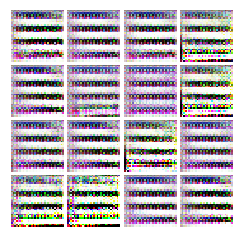

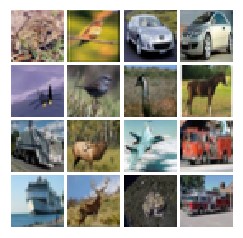


Iter: 25000, D: -4.54e+08, G:2.274e+08
Iter: 25050, D: -4.565e+08, G:2.286e+08
Iter: 25100, D: -4.59e+08, G:2.299e+08
Iter: 25150, D: -4.615e+08, G:2.311e+08
Iter: 25200, D: -4.639e+08, G:2.323e+08


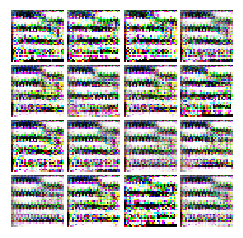

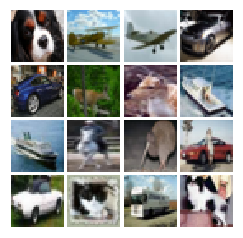


Iter: 25250, D: -4.664e+08, G:2.336e+08
Iter: 25300, D: -4.69e+08, G:2.348e+08
Iter: 25350, D: -4.715e+08, G:2.361e+08
Iter: 25400, D: -4.74e+08, G:2.374e+08
Iter: 25450, D: -4.765e+08, G:2.386e+08


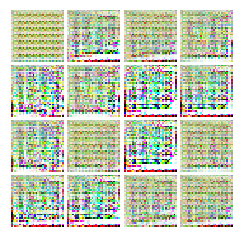

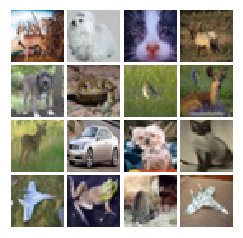


Iter: 25500, D: -4.791e+08, G:2.399e+08
Iter: 25550, D: -4.816e+08, G:2.412e+08
Iter: 25600, D: -4.842e+08, G:2.425e+08
Iter: 25650, D: -4.868e+08, G:2.437e+08
Iter: 25700, D: -4.894e+08, G:2.45e+08


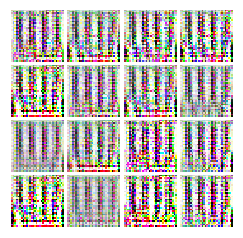

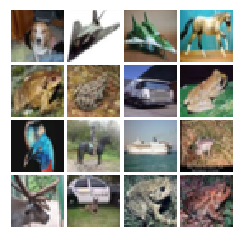


Iter: 25750, D: -4.92e+08, G:2.463e+08
Iter: 25800, D: -4.946e+08, G:2.476e+08
Iter: 25850, D: -4.972e+08, G:2.489e+08
Iter: 25900, D: -4.998e+08, G:2.502e+08
Iter: 25950, D: -5.024e+08, G:2.515e+08


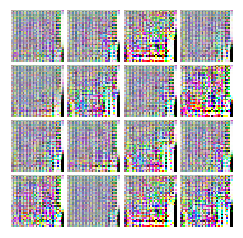

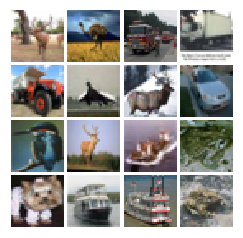


Iter: 26000, D: -5.05e+08, G:2.529e+08
Iter: 26050, D: -5.077e+08, G:2.542e+08
Iter: 26100, D: -5.103e+08, G:2.555e+08
Iter: 26150, D: -5.13e+08, G:2.568e+08
Iter: 26200, D: -5.157e+08, G:2.582e+08


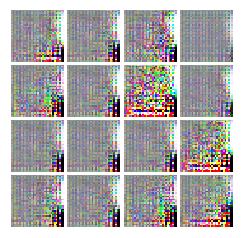

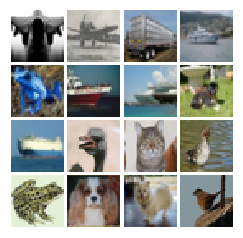


Iter: 26250, D: -5.184e+08, G:2.595e+08
Iter: 26300, D: -5.211e+08, G:2.609e+08
Iter: 26350, D: -5.238e+08, G:2.622e+08
Iter: 26400, D: -5.265e+08, G:2.636e+08
Iter: 26450, D: -5.292e+08, G:2.649e+08


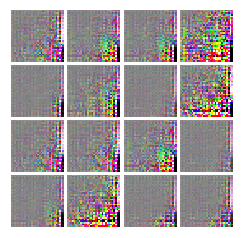

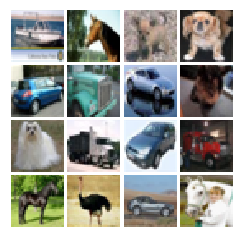


Iter: 26500, D: -5.319e+08, G:2.663e+08
Iter: 26550, D: -5.346e+08, G:2.676e+08
Iter: 26600, D: -5.374e+08, G:2.69e+08
Iter: 26650, D: -5.401e+08, G:2.704e+08
Iter: 26700, D: -5.429e+08, G:2.718e+08


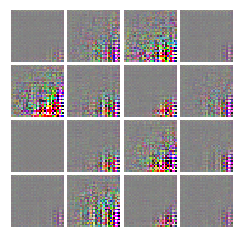

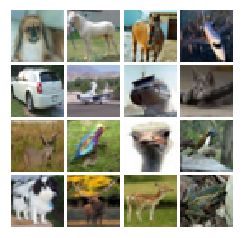


Iter: 26750, D: -5.457e+08, G:2.732e+08
Iter: 26800, D: -5.485e+08, G:2.746e+08
Iter: 26850, D: -5.513e+08, G:2.759e+08
Iter: 26900, D: -5.541e+08, G:2.773e+08
Iter: 26950, D: -5.569e+08, G:2.787e+08


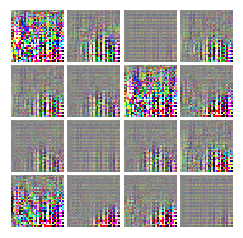

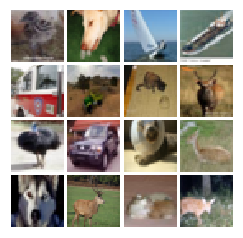


Iter: 27000, D: -5.597e+08, G:2.802e+08
Iter: 27050, D: -5.625e+08, G:2.816e+08
Iter: 27100, D: -5.654e+08, G:2.83e+08
Iter: 27150, D: -5.682e+08, G:2.844e+08
Iter: 27200, D: -5.711e+08, G:2.858e+08


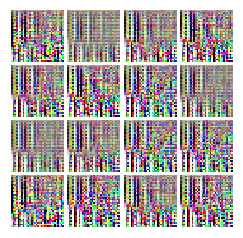

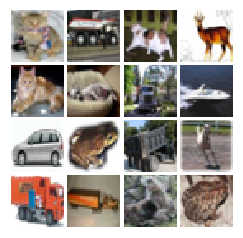


Iter: 27250, D: -5.74e+08, G:2.873e+08
Iter: 27300, D: -5.768e+08, G:2.887e+08
Iter: 27350, D: -5.797e+08, G:2.902e+08
Iter: 27400, D: -5.826e+08, G:2.916e+08
Iter: 27450, D: -5.855e+08, G:2.931e+08


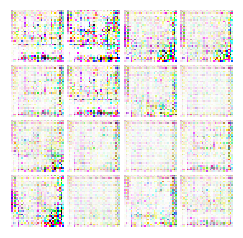

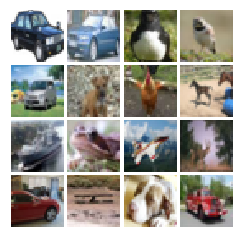


Iter: 27500, D: -5.884e+08, G:2.945e+08
Iter: 27550, D: -5.914e+08, G:2.96e+08
Iter: 27600, D: -5.943e+08, G:2.974e+08
Iter: 27650, D: -5.973e+08, G:2.989e+08
Iter: 27700, D: -6.002e+08, G:3.004e+08


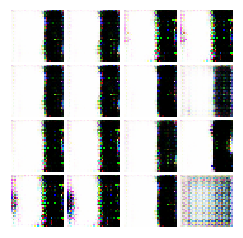

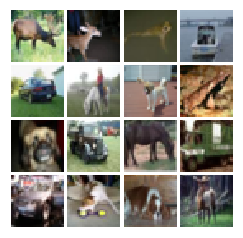


Iter: 27750, D: -6.032e+08, G:3.019e+08
Iter: 27800, D: -6.061e+08, G:3.033e+08
Iter: 27850, D: -6.091e+08, G:3.048e+08
Iter: 27900, D: -6.121e+08, G:3.063e+08
Iter: 27950, D: -6.151e+08, G:3.078e+08


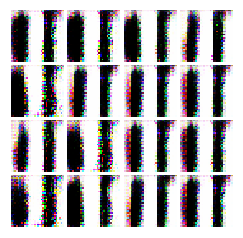

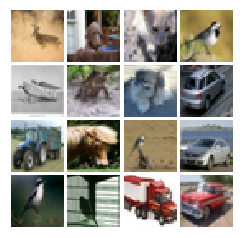


Iter: 28000, D: -6.181e+08, G:3.093e+08
Iter: 28050, D: -6.212e+08, G:3.108e+08
Iter: 28100, D: -6.242e+08, G:3.124e+08
Iter: 28150, D: -6.272e+08, G:3.139e+08
Iter: 28200, D: -6.303e+08, G:3.154e+08


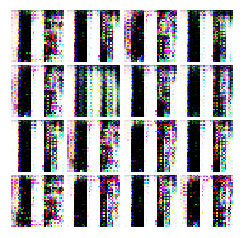

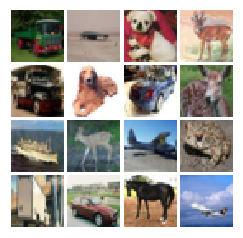


Iter: 28250, D: -6.334e+08, G:3.169e+08
Iter: 28300, D: -6.364e+08, G:3.185e+08
Iter: 28350, D: -6.395e+08, G:3.2e+08
Iter: 28400, D: -6.426e+08, G:3.215e+08
Iter: 28450, D: -6.457e+08, G:3.231e+08


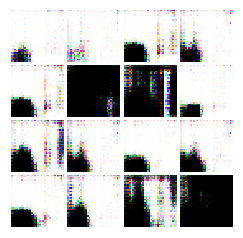

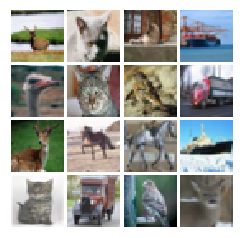


Iter: 28500, D: -6.488e+08, G:3.246e+08
Iter: 28550, D: -6.519e+08, G:3.262e+08
Iter: 28600, D: -6.551e+08, G:3.278e+08
Iter: 28650, D: -6.582e+08, G:3.293e+08
Iter: 28700, D: -6.614e+08, G:3.309e+08


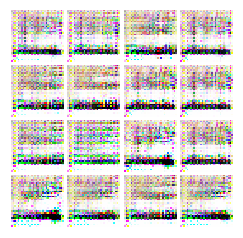

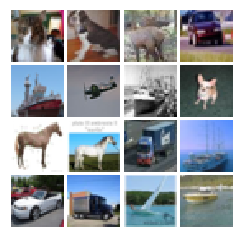


Iter: 28750, D: -6.645e+08, G:3.325e+08
Iter: 28800, D: -6.677e+08, G:3.341e+08
Iter: 28850, D: -6.709e+08, G:3.357e+08
Iter: 28900, D: -6.741e+08, G:3.372e+08
Iter: 28950, D: -6.773e+08, G:3.388e+08


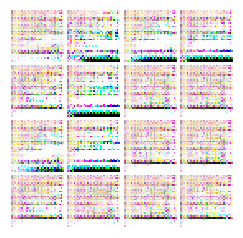

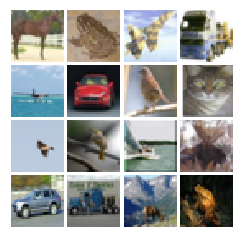


Iter: 29000, D: -6.805e+08, G:3.404e+08
Iter: 29050, D: -6.837e+08, G:3.421e+08
Iter: 29100, D: -6.869e+08, G:3.437e+08
Iter: 29150, D: -6.902e+08, G:3.453e+08
Iter: 29200, D: -6.934e+08, G:3.469e+08


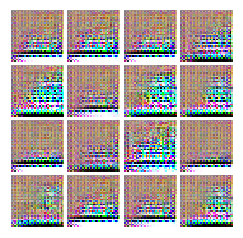

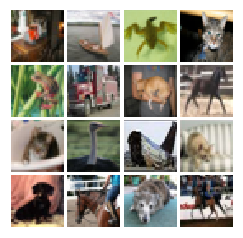


Iter: 29250, D: -6.967e+08, G:3.485e+08
Iter: 29300, D: -7e+08, G:3.502e+08
Iter: 29350, D: -7.032e+08, G:3.518e+08
Iter: 29400, D: -7.065e+08, G:3.535e+08
Iter: 29450, D: -7.098e+08, G:3.551e+08


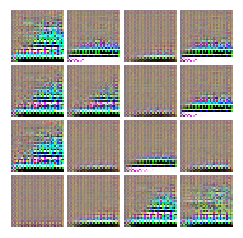

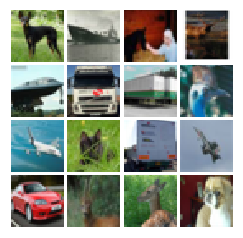


Iter: 29500, D: -7.131e+08, G:3.568e+08
Iter: 29550, D: -7.165e+08, G:3.584e+08
Iter: 29600, D: -7.198e+08, G:3.601e+08
Iter: 29650, D: -7.231e+08, G:3.617e+08
Iter: 29700, D: -7.265e+08, G:3.634e+08


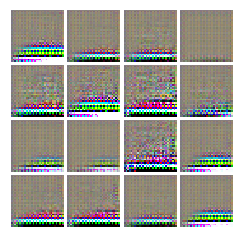

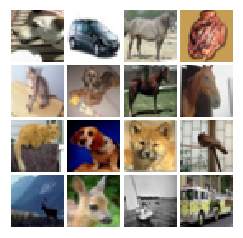


Iter: 29750, D: -7.299e+08, G:3.651e+08
Iter: 29800, D: -7.332e+08, G:3.668e+08
Iter: 29850, D: -7.366e+08, G:3.685e+08
Iter: 29900, D: -7.4e+08, G:3.702e+08
Iter: 29950, D: -7.434e+08, G:3.719e+08


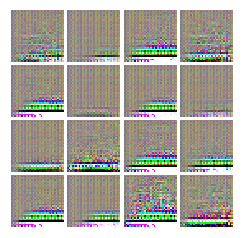

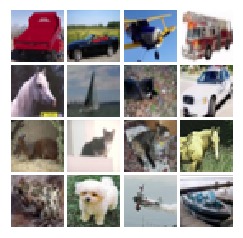


Iter: 30000, D: -7.468e+08, G:3.736e+08
Iter: 30050, D: -7.503e+08, G:3.753e+08
Iter: 30100, D: -7.537e+08, G:3.77e+08
Iter: 30150, D: -7.571e+08, G:3.787e+08
Iter: 30200, D: -7.606e+08, G:3.804e+08


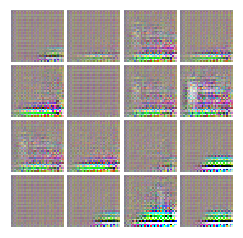

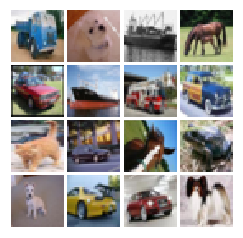


Iter: 30250, D: -7.641e+08, G:3.822e+08
Iter: 30300, D: -7.675e+08, G:3.839e+08
Iter: 30350, D: -7.71e+08, G:3.856e+08
Iter: 30400, D: -7.745e+08, G:3.874e+08
Iter: 30450, D: -7.78e+08, G:3.891e+08


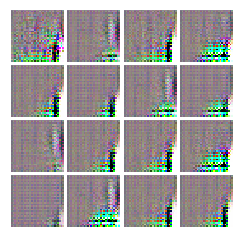

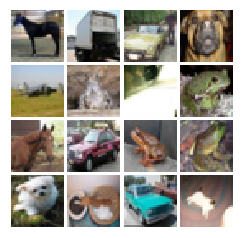


Iter: 30500, D: -7.816e+08, G:3.909e+08
Iter: 30550, D: -7.851e+08, G:3.927e+08
Iter: 30600, D: -7.886e+08, G:3.944e+08
Iter: 30650, D: -7.922e+08, G:3.962e+08
Iter: 30700, D: -7.958e+08, G:3.98e+08


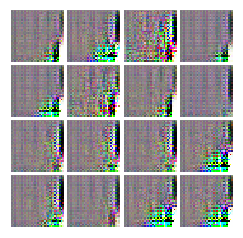

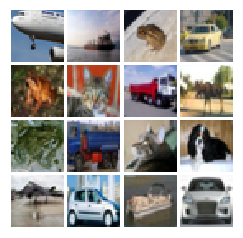


Iter: 30750, D: -7.993e+08, G:3.998e+08
Iter: 30800, D: -8.029e+08, G:4.015e+08
Iter: 30850, D: -8.065e+08, G:4.033e+08
Iter: 30900, D: -8.101e+08, G:4.051e+08
Iter: 30950, D: -8.137e+08, G:4.069e+08


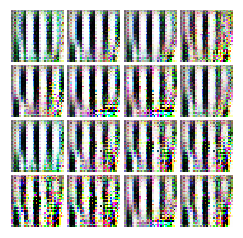

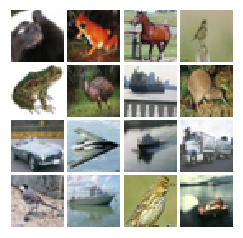


Iter: 31000, D: -8.173e+08, G:4.087e+08
Iter: 31050, D: -8.21e+08, G:4.106e+08
Iter: 31100, D: -8.246e+08, G:4.124e+08
Iter: 31150, D: -8.283e+08, G:4.142e+08
Iter: 31200, D: -8.32e+08, G:4.16e+08


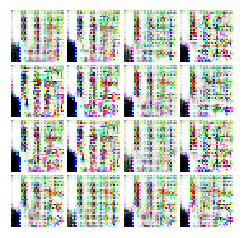

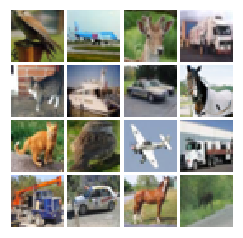


Iter: 31250, D: -8.356e+08, G:4.179e+08
Iter: 31300, D: -8.393e+08, G:4.197e+08
Iter: 31350, D: -8.43e+08, G:4.216e+08
Iter: 31400, D: -8.467e+08, G:4.234e+08
Iter: 31450, D: -8.505e+08, G:4.253e+08


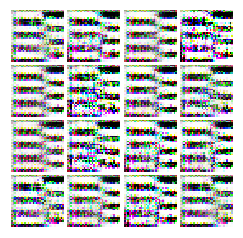

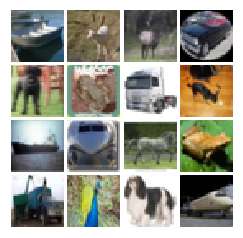


Iter: 31500, D: -8.542e+08, G:4.271e+08
Iter: 31550, D: -8.579e+08, G:4.29e+08
Iter: 31600, D: -8.617e+08, G:4.309e+08
Iter: 31650, D: -8.655e+08, G:4.328e+08
Iter: 31700, D: -8.692e+08, G:4.346e+08


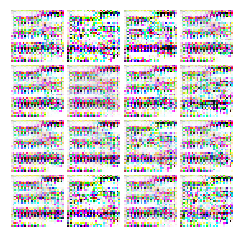

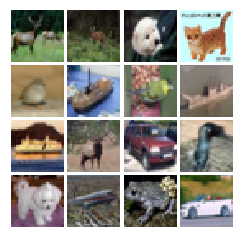


Iter: 31750, D: -8.73e+08, G:4.365e+08
Iter: 31800, D: -8.768e+08, G:4.384e+08
Iter: 31850, D: -8.806e+08, G:4.403e+08
Iter: 31900, D: -8.845e+08, G:4.422e+08
Iter: 31950, D: -8.883e+08, G:4.441e+08


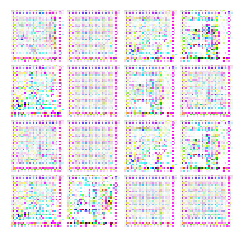

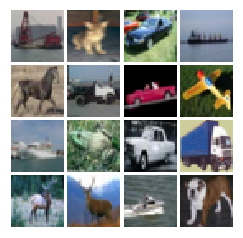


Iter: 32000, D: -8.921e+08, G:4.461e+08
Iter: 32050, D: -8.96e+08, G:4.48e+08
Iter: 32100, D: -8.998e+08, G:4.499e+08
Iter: 32150, D: -9.037e+08, G:4.518e+08
Iter: 32200, D: -9.076e+08, G:4.538e+08


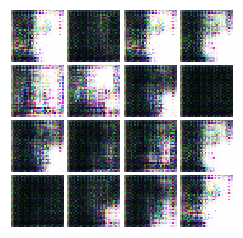

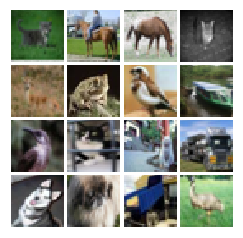


Iter: 32250, D: -9.115e+08, G:4.557e+08
Iter: 32300, D: -9.154e+08, G:4.577e+08
Iter: 32350, D: -9.193e+08, G:4.596e+08
Iter: 32400, D: -9.233e+08, G:4.616e+08
Iter: 32450, D: -9.272e+08, G:4.636e+08


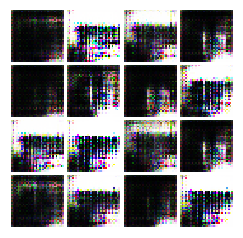

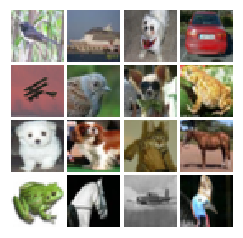


Iter: 32500, D: -9.312e+08, G:4.655e+08
Iter: 32550, D: -9.351e+08, G:4.675e+08
Iter: 32600, D: -9.391e+08, G:4.695e+08
Iter: 32650, D: -9.431e+08, G:4.715e+08
Iter: 32700, D: -9.471e+08, G:4.735e+08


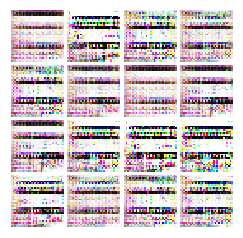

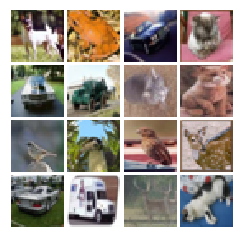


Iter: 32750, D: -9.511e+08, G:4.755e+08
Iter: 32800, D: -9.551e+08, G:4.775e+08
Iter: 32850, D: -9.591e+08, G:4.795e+08
Iter: 32900, D: -9.632e+08, G:4.815e+08
Iter: 32950, D: -9.672e+08, G:4.835e+08


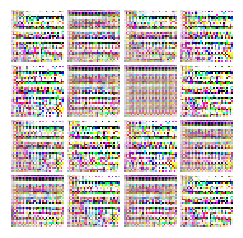

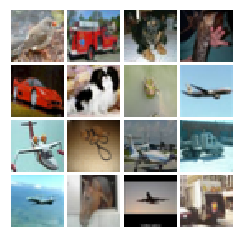


Iter: 33000, D: -9.713e+08, G:4.856e+08
Iter: 33050, D: -9.754e+08, G:4.876e+08
Iter: 33100, D: -9.795e+08, G:4.896e+08
Iter: 33150, D: -9.836e+08, G:4.917e+08
Iter: 33200, D: -9.877e+08, G:4.937e+08


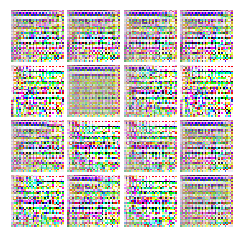

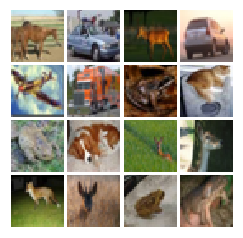


Iter: 33250, D: -9.918e+08, G:4.958e+08
Iter: 33300, D: -9.959e+08, G:4.978e+08
Iter: 33350, D: -1e+09, G:4.999e+08
Iter: 33400, D: -1.004e+09, G:5.02e+08
Iter: 33450, D: -1.008e+09, G:5.041e+08


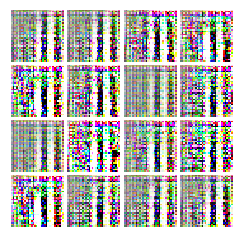

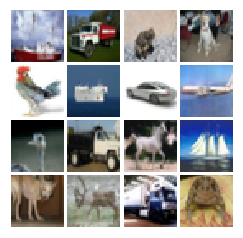


Iter: 33500, D: -1.013e+09, G:5.061e+08
Iter: 33550, D: -1.017e+09, G:5.082e+08
Iter: 33600, D: -1.021e+09, G:5.103e+08
Iter: 33650, D: -1.025e+09, G:5.124e+08
Iter: 33700, D: -1.029e+09, G:5.145e+08


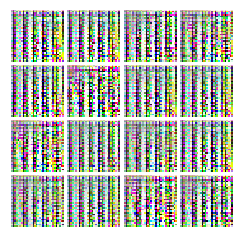

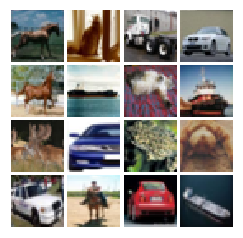


Iter: 33750, D: -1.034e+09, G:5.167e+08
Iter: 33800, D: -1.038e+09, G:5.188e+08
Iter: 33850, D: -1.042e+09, G:5.209e+08
Iter: 33900, D: -1.046e+09, G:5.23e+08
Iter: 33950, D: -1.051e+09, G:5.252e+08


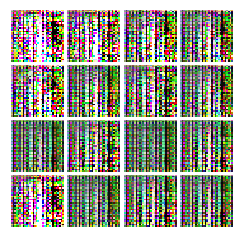

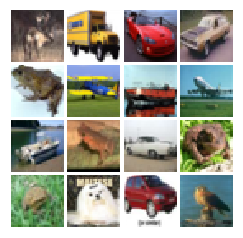


Iter: 34000, D: -1.055e+09, G:5.273e+08
Iter: 34050, D: -1.059e+09, G:5.295e+08
Iter: 34100, D: -1.064e+09, G:5.316e+08
Iter: 34150, D: -1.068e+09, G:5.338e+08
Iter: 34200, D: -1.072e+09, G:5.359e+08


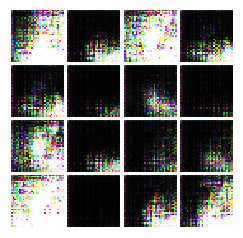

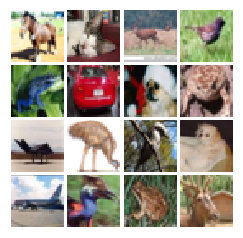


Iter: 34250, D: -1.077e+09, G:5.381e+08
Iter: 34300, D: -1.081e+09, G:5.403e+08
Iter: 34350, D: -1.085e+09, G:5.425e+08
Iter: 34400, D: -1.09e+09, G:5.447e+08
Iter: 34450, D: -1.094e+09, G:5.468e+08


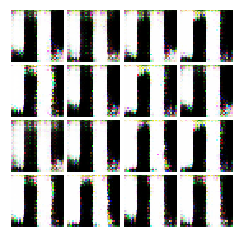

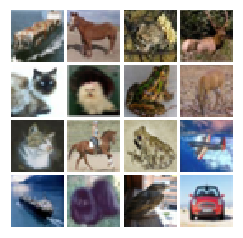


Iter: 34500, D: -1.099e+09, G:5.49e+08
Iter: 34550, D: -1.103e+09, G:5.513e+08
Iter: 34600, D: -1.107e+09, G:5.535e+08
Iter: 34650, D: -1.112e+09, G:5.557e+08
Iter: 34700, D: -1.116e+09, G:5.579e+08


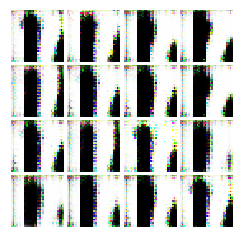

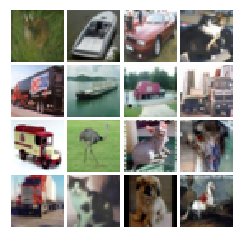


Iter: 34750, D: -1.121e+09, G:5.601e+08
Iter: 34800, D: -1.125e+09, G:5.624e+08
Iter: 34850, D: -1.13e+09, G:5.646e+08
Iter: 34900, D: -1.134e+09, G:5.669e+08
Iter: 34950, D: -1.139e+09, G:5.691e+08


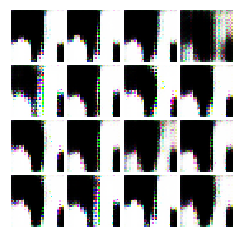

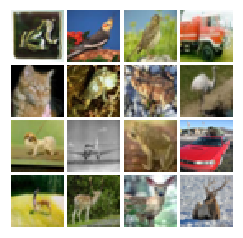


Iter: 35000, D: -1.143e+09, G:5.714e+08
Iter: 35050, D: -1.148e+09, G:5.736e+08
Iter: 35100, D: -1.152e+09, G:5.759e+08
Iter: 35150, D: -1.157e+09, G:5.782e+08
Iter: 35200, D: -1.162e+09, G:5.805e+08


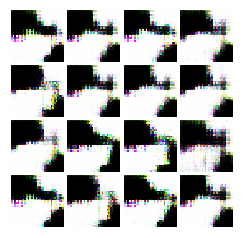

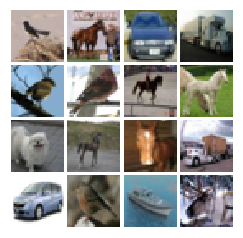


Iter: 35250, D: -1.166e+09, G:5.828e+08
Iter: 35300, D: -1.171e+09, G:5.85e+08
Iter: 35350, D: -1.175e+09, G:5.873e+08
Iter: 35400, D: -1.18e+09, G:5.897e+08
Iter: 35450, D: -1.185e+09, G:5.92e+08


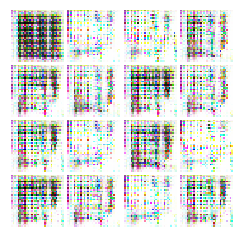

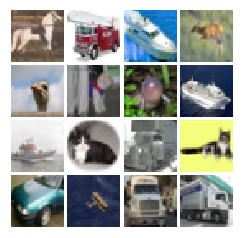


Iter: 35500, D: -1.189e+09, G:5.943e+08
Iter: 35550, D: -1.194e+09, G:5.966e+08
Iter: 35600, D: -1.199e+09, G:5.989e+08
Iter: 35650, D: -1.203e+09, G:6.013e+08
Iter: 35700, D: -1.208e+09, G:6.036e+08


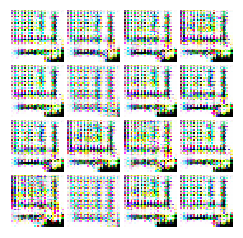

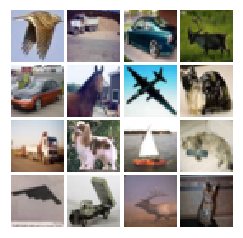


Iter: 35750, D: -1.213e+09, G:6.06e+08
Iter: 35800, D: -1.217e+09, G:6.083e+08
Iter: 35850, D: -1.222e+09, G:6.107e+08
Iter: 35900, D: -1.227e+09, G:6.131e+08
Iter: 35950, D: -1.232e+09, G:6.154e+08


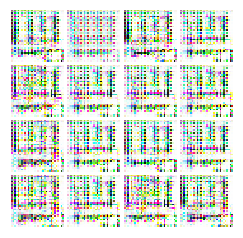

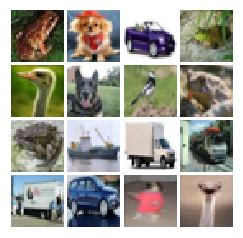


Iter: 36000, D: -1.236e+09, G:6.178e+08
Iter: 36050, D: -1.241e+09, G:6.202e+08
Iter: 36100, D: -1.246e+09, G:6.226e+08
Iter: 36150, D: -1.251e+09, G:6.25e+08
Iter: 36200, D: -1.256e+09, G:6.274e+08


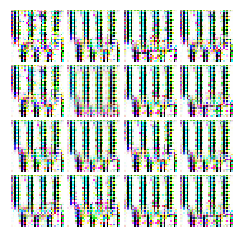

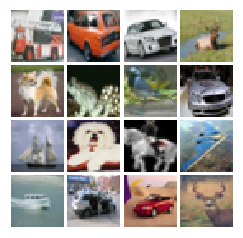


Iter: 36250, D: -1.261e+09, G:6.298e+08
Iter: 36300, D: -1.265e+09, G:6.322e+08
Iter: 36350, D: -1.27e+09, G:6.346e+08
Iter: 36400, D: -1.275e+09, G:6.371e+08
Iter: 36450, D: -1.28e+09, G:6.395e+08


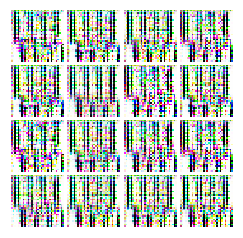

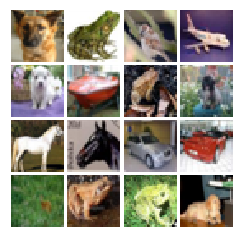


Iter: 36500, D: -1.285e+09, G:6.419e+08
Iter: 36550, D: -1.29e+09, G:6.444e+08
Iter: 36600, D: -1.295e+09, G:6.468e+08
Iter: 36650, D: -1.3e+09, G:6.493e+08
Iter: 36700, D: -1.305e+09, G:6.518e+08


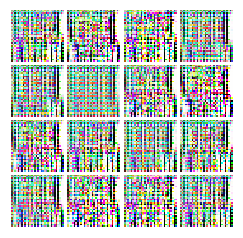

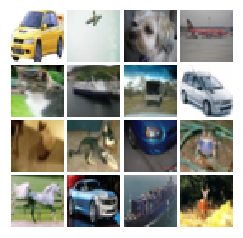


Iter: 36750, D: -1.31e+09, G:6.542e+08
Iter: 36800, D: -1.315e+09, G:6.567e+08
Iter: 36850, D: -1.319e+09, G:6.592e+08
Iter: 36900, D: -1.324e+09, G:6.617e+08
Iter: 36950, D: -1.329e+09, G:6.642e+08


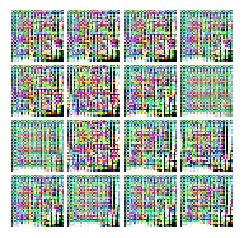

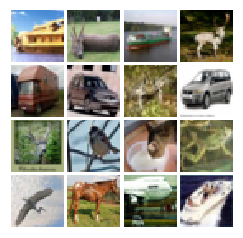


Iter: 37000, D: -1.335e+09, G:6.667e+08
Iter: 37050, D: -1.34e+09, G:6.692e+08
Iter: 37100, D: -1.345e+09, G:6.717e+08
Iter: 37150, D: -1.35e+09, G:6.742e+08
Iter: 37200, D: -1.355e+09, G:6.767e+08


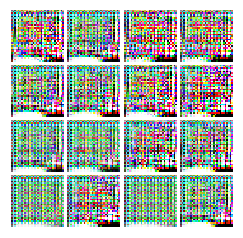

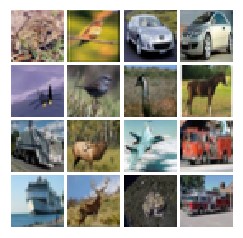


Iter: 37250, D: -1.36e+09, G:6.793e+08
Iter: 37300, D: -1.365e+09, G:6.818e+08
Iter: 37350, D: -1.37e+09, G:6.844e+08
Iter: 37400, D: -1.375e+09, G:6.869e+08
Iter: 37450, D: -1.38e+09, G:6.895e+08


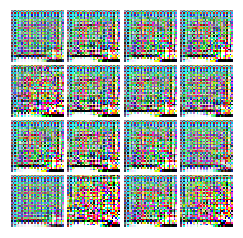

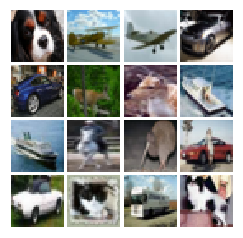


Iter: 37500, D: -1.385e+09, G:6.92e+08
Iter: 37550, D: -1.391e+09, G:6.946e+08
Iter: 37600, D: -1.396e+09, G:6.972e+08
Iter: 37650, D: -1.401e+09, G:6.998e+08
Iter: 37700, D: -1.406e+09, G:7.024e+08


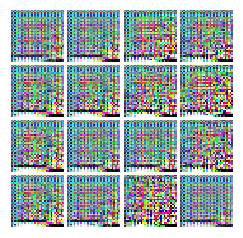

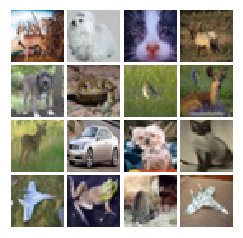


Iter: 37750, D: -1.411e+09, G:7.05e+08
Iter: 37800, D: -1.417e+09, G:7.076e+08
Iter: 37850, D: -1.422e+09, G:7.102e+08
Iter: 37900, D: -1.427e+09, G:7.128e+08
Iter: 37950, D: -1.432e+09, G:7.154e+08


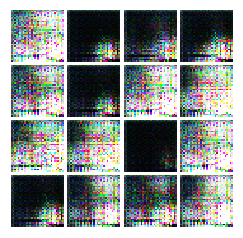

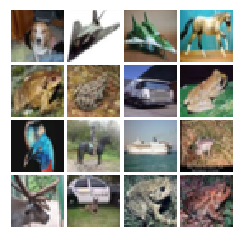


Iter: 38000, D: -1.438e+09, G:7.18e+08
Iter: 38050, D: -1.443e+09, G:7.207e+08
Iter: 38100, D: -1.448e+09, G:7.233e+08
Iter: 38150, D: -1.453e+09, G:7.26e+08
Iter: 38200, D: -1.459e+09, G:7.286e+08


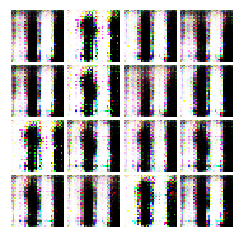

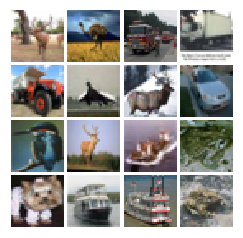


Iter: 38250, D: -1.464e+09, G:7.313e+08
Final images


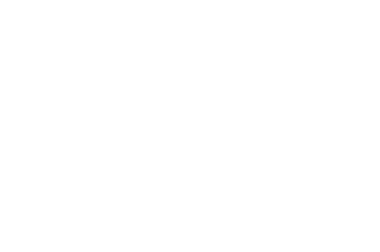

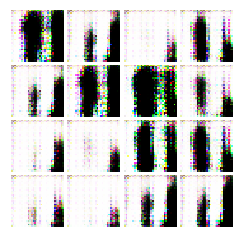

In [75]:
with get_session() as sess:
    sess.run(tf.global_variables_initializer())
    run_a_gan(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,batch_size=BATCH_SIZE,num_epoch=50)

In [1]:
import os, sys

sys.path.append(os.getcwd())



import time



import numpy as np

import tensorflow as tf



import tflib as lib

import tflib.ops.linear

import tflib.ops.conv2d

import tflib.ops.batchnorm

import tflib.ops.deconv2d

import tflib.save_images

import tflib.cifar10

#import tflib.inception_score

import tflib.plot



# Download CIFAR-10 (Python version) at

# https://www.cs.toronto.edu/~kriz/cifar.html and fill in the path to the

# extracted files here!

DATA_DIR = 'cs231n/datasets/cifar-10-batches-py'

if len(DATA_DIR) == 0:

    raise Exception('Please specify path to data directory in gan_cifar.py!')



MODE = 'wgan-gp' # Valid options are dcgan, wgan, or wgan-gp

DIM = 128 # This overfits substantially; you're probably better off with 64

LAMBDA = 10 # Gradient penalty lambda hyperparameter

CRITIC_ITERS = 5 # How many critic iterations per generator iteration

BATCH_SIZE = 64 # Batch size

ITERS = 200000 # How many generator iterations to train for

OUTPUT_DIM = 3072 # Number of pixels in CIFAR10 (3*32*32)



lib.print_model_settings(locals().copy())



def LeakyReLU(x, alpha=0.2):

    return tf.maximum(alpha*x, x)



def ReLULayer(name, n_in, n_out, inputs):

    output = lib.ops.linear.Linear(name+'.Linear', n_in, n_out, inputs)

    return tf.nn.relu(output)



def LeakyReLULayer(name, n_in, n_out, inputs):

    output = lib.ops.linear.Linear(name+'.Linear', n_in, n_out, inputs)

    return LeakyReLU(output)



def Generator(n_samples, noise=None):

    if noise is None:

        noise = tf.random_normal([n_samples, 128])



    output = lib.ops.linear.Linear('Generator.Input', 128, 4*4*4*DIM, noise)

    output = lib.ops.batchnorm.Batchnorm('Generator.BN1', [0], output)

    output = tf.nn.relu(output)

    output = tf.reshape(output, [-1, 4*DIM, 4, 4])



    output = lib.ops.deconv2d.Deconv2D('Generator.2', 4*DIM, 2*DIM, 5, output)

    output = lib.ops.batchnorm.Batchnorm('Generator.BN2', [0,2,3], output)

    output = tf.nn.relu(output)



    output = lib.ops.deconv2d.Deconv2D('Generator.3', 2*DIM, DIM, 5, output)

    output = lib.ops.batchnorm.Batchnorm('Generator.BN3', [0,2,3], output)

    output = tf.nn.relu(output)



    output = lib.ops.deconv2d.Deconv2D('Generator.5', DIM, 3, 5, output)



    output = tf.tanh(output)



    return tf.reshape(output, [-1, OUTPUT_DIM])



def Discriminator(inputs):

    output = tf.reshape(inputs, [-1, 3, 32, 32])



    output = lib.ops.conv2d.Conv2D('Discriminator.1', 3, DIM, 5, output, stride=2)

    output = LeakyReLU(output)



    output = lib.ops.conv2d.Conv2D('Discriminator.2', DIM, 2*DIM, 5, output, stride=2)

    if MODE != 'wgan-gp':

        output = lib.ops.batchnorm.Batchnorm('Discriminator.BN2', [0,2,3], output)

    output = LeakyReLU(output)



    output = lib.ops.conv2d.Conv2D('Discriminator.3', 2*DIM, 4*DIM, 5, output, stride=2)

    if MODE != 'wgan-gp':

        output = lib.ops.batchnorm.Batchnorm('Discriminator.BN3', [0,2,3], output)

    output = LeakyReLU(output)



    output = tf.reshape(output, [-1, 4*4*4*DIM])

    output = lib.ops.linear.Linear('Discriminator.Output', 4*4*4*DIM, 1, output)



    return tf.reshape(output, [-1])



real_data_int = tf.placeholder(tf.int32, shape=[BATCH_SIZE, OUTPUT_DIM])

real_data = 2*((tf.cast(real_data_int, tf.float32)/255.)-.5)

fake_data = Generator(BATCH_SIZE)



disc_real = Discriminator(real_data)

disc_fake = Discriminator(fake_data)



gen_params = lib.params_with_name('Generator')

disc_params = lib.params_with_name('Discriminator')



if MODE == 'wgan':

    gen_cost = -tf.reduce_mean(disc_fake)

    disc_cost = tf.reduce_mean(disc_fake) - tf.reduce_mean(disc_real)



    gen_train_op = tf.train.RMSPropOptimizer(learning_rate=5e-5).minimize(gen_cost, var_list=gen_params)

    disc_train_op = tf.train.RMSPropOptimizer(learning_rate=5e-5).minimize(disc_cost, var_list=disc_params)



    clip_ops = []

    for var in disc_params:

        clip_bounds = [-.01, .01]

        clip_ops.append(

            tf.assign(

                var, 

                tf.clip_by_value(var, clip_bounds[0], clip_bounds[1])

            )

        )

    clip_disc_weights = tf.group(*clip_ops)



elif MODE == 'wgan-gp':

    # Standard WGAN loss

    gen_cost = -tf.reduce_mean(disc_fake)

    disc_cost = tf.reduce_mean(disc_fake) - tf.reduce_mean(disc_real)



    # Gradient penalty

    alpha = tf.random_uniform(

        shape=[BATCH_SIZE,1], 

        minval=0.,

        maxval=1.

    )

    differences = fake_data - real_data

    interpolates = real_data + (alpha*differences)

    gradients = tf.gradients(Discriminator(interpolates), [interpolates])[0]

    slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), reduction_indices=[1]))

    gradient_penalty = tf.reduce_mean((slopes-1.)**2)

    disc_cost += LAMBDA*gradient_penalty



    gen_train_op = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9).minimize(gen_cost, var_list=gen_params)

    disc_train_op = tf.train.AdamOptimizer(learning_rate=1e-4, beta1=0.5, beta2=0.9).minimize(disc_cost, var_list=disc_params)



elif MODE == 'dcgan':

    gen_cost = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(disc_fake, tf.ones_like(disc_fake)))

    disc_cost =  tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(disc_fake, tf.zeros_like(disc_fake)))

    disc_cost += tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(disc_real, tf.ones_like(disc_real)))

    disc_cost /= 2.



    gen_train_op = tf.train.AdamOptimizer(learning_rate=2e-4, beta1=0.5).minimize(gen_cost,

                                                                                  var_list=lib.params_with_name('Generator'))

    disc_train_op = tf.train.AdamOptimizer(learning_rate=2e-4, beta1=0.5).minimize(disc_cost,

                                                                                   var_list=lib.params_with_name('Discriminator.'))



# For generating samples

fixed_noise_128 = tf.constant(np.random.normal(size=(128, 128)).astype('float32'))

fixed_noise_samples_128 = Generator(128, noise=fixed_noise_128)

def generate_image(frame, true_dist):

    samples = session.run(fixed_noise_samples_128)

    samples = ((samples+1.)*(255./2)).astype('int32')

    lib.save_images.save_images(samples.reshape((128, 3, 32, 32)), 'samples_{}.jpg'.format(frame))



# For calculating inception score

#samples_100 = Generator(100)

# def get_inception_score():

#     all_samples = []

#     for i in xrange(10):

#         all_samples.append(session.run(samples_100))

#     all_samples = np.concatenate(all_samples, axis=0)

#     all_samples = ((all_samples+1.)*(255./2)).astype('int32')

#     all_samples = all_samples.reshape((-1, 3, 32, 32)).transpose(0,2,3,1)

#     return lib.inception_score.get_inception_score(list(all_samples))



# Dataset iterators

train_gen, dev_gen = lib.cifar10.load(BATCH_SIZE, data_dir=DATA_DIR)

def inf_train_gen():

    while True:

        for images,_ in train_gen():

            yield images



# Train loop

with tf.Session() as session:

    session.run(tf.global_variables_initializer())

    gen = inf_train_gen()



    for iteration in xrange(ITERS):

        start_time = time.time()

        # Train generator

        if iteration > 0:

            _ = session.run(gen_train_op)

        # Train critic

        if MODE == 'dcgan':

            disc_iters = 1

        else:

            disc_iters = CRITIC_ITERS

        for i in xrange(disc_iters):

            _data = gen.next()

            _disc_cost, _ = session.run([disc_cost, disc_train_op], feed_dict={real_data_int: _data})

            if MODE == 'wgan':

                _ = session.run(clip_disc_weights)



        lib.plot.plot('train disc cost', _disc_cost)

        lib.plot.plot('time', time.time() - start_time)



        # Calculate inception score every 1K iters

#         if iteration % 1000 == 999:

#             inception_score = get_inception_score()

#             lib.plot.plot('inception score', inception_score[0])



        # Calculate dev loss and generate samples every 100 iters

        if iteration % 100 == 99:

            dev_disc_costs = []

            for images,_ in dev_gen():

                _dev_disc_cost = session.run(disc_cost, feed_dict={real_data_int: images}) 

                dev_disc_costs.append(_dev_disc_cost)

            lib.plot.plot('dev disc cost', np.mean(dev_disc_costs))

            generate_image(iteration, _data)



        # Save logs every 100 iters

        if (iteration < 5) or (iteration % 100 == 99):

            lib.plot.flush()



        lib.plot.tick()

Uppercase local vars:
	BATCH_SIZE: 64
	CRITIC_ITERS: 5
	DATA_DIR: cs231n/datasets/cifar-10-batches-py
	DIM: 128
	ITERS: 200000
	LAMBDA: 10
	MODE: wgan-gp
	OUTPUT_DIM: 3072
iter 0	train disc cost	-8.52808952332	time	1.25360202789
iter 1	train disc cost	-22.3704948425	time	0.395015954971
iter 2	train disc cost	-30.9231948853	time	0.363248109818
iter 3	train disc cost	-35.2655944824	time	0.368246078491
iter 4	train disc cost	-38.9640007019	time	0.368392944336
iter 99	train disc cost	-30.0488567352	dev disc cost	-17.7310562134	time	0.374988001271
iter 199	train disc cost	-15.3431892395	dev disc cost	-13.3787469864	time	0.371624078751
iter 299	train disc cost	-11.9130277634	dev disc cost	-11.1379327774	time	0.373549187183
iter 399	train disc cost	-9.92865085602	dev disc cost	-8.09513568878	time	0.376255431175
iter 499	train disc cost	-7.98823165894	dev disc cost	-8.04552936554	time	0.376463906765
iter 599	train disc cost	-8.0310716629	dev disc cost	-8.44583702087	time	0.364330351353
iter 69

iter 8799	train disc cost	-3.38670325279	dev disc cost	-3.48168587685	time	0.365149645805
iter 8899	train disc cost	-3.34866333008	dev disc cost	-3.38405394554	time	0.36533393383
iter 8999	train disc cost	-3.3616476059	dev disc cost	-3.44405627251	time	0.365954811573
iter 9099	train disc cost	-3.34636616707	dev disc cost	-3.23188185692	time	0.366819524765
iter 9199	train disc cost	-3.26346063614	dev disc cost	-3.46025586128	time	0.36665337801
iter 9299	train disc cost	-3.31254482269	dev disc cost	-3.13644552231	time	0.36614521265
iter 9399	train disc cost	-3.3428413868	dev disc cost	-3.26186609268	time	0.366764121056
iter 9499	train disc cost	-3.33278131485	dev disc cost	-3.07199716568	time	0.366363778114
iter 9599	train disc cost	-3.28896999359	dev disc cost	-3.14608931541	time	0.366808965206
iter 9699	train disc cost	-3.29236912727	dev disc cost	-3.34016919136	time	0.365056340694
iter 9799	train disc cost	-3.29860830307	dev disc cost	-3.36664748192	time	0.368592863083
iter 9899	train

iter 17899	train disc cost	-2.84128975868	dev disc cost	-2.82131910324	time	0.367134301662
iter 17999	train disc cost	-2.90251040459	dev disc cost	-2.91213607788	time	0.367823638916
iter 18099	train disc cost	-2.85835361481	dev disc cost	-2.76543259621	time	0.366648221016
iter 18199	train disc cost	-2.85334563255	dev disc cost	-2.68201184273	time	0.367499616146
iter 18299	train disc cost	-2.83493900299	dev disc cost	-2.7344660759	time	0.36703139782
iter 18399	train disc cost	-2.86704111099	dev disc cost	-2.71357536316	time	0.366249012947
iter 18499	train disc cost	-2.78187465668	dev disc cost	-2.70953774452	time	0.368889987469
iter 18599	train disc cost	-2.82597970963	dev disc cost	-2.85872602463	time	0.367106249332
iter 18699	train disc cost	-2.82180786133	dev disc cost	-2.72501635551	time	0.365504660606
iter 18799	train disc cost	-2.83911585808	dev disc cost	-2.57915878296	time	0.368289358616
iter 18899	train disc cost	-2.82266378403	dev disc cost	-2.59734916687	time	0.366338944435
i

iter 26999	train disc cost	-2.59067988396	dev disc cost	-2.32463264465	time	0.364637949467
iter 27099	train disc cost	-2.5898194313	dev disc cost	-2.50982236862	time	0.366134946346
iter 27199	train disc cost	-2.58241510391	dev disc cost	-2.61832594872	time	0.366739354134
iter 27299	train disc cost	-2.59579706192	dev disc cost	-2.36425352097	time	0.365204906464
iter 27399	train disc cost	-2.59351587296	dev disc cost	-2.30382275581	time	0.366690995693
iter 27499	train disc cost	-2.5593585968	dev disc cost	-2.37679696083	time	0.365517601967
iter 27599	train disc cost	-2.56969380379	dev disc cost	-2.48163199425	time	0.365892379284
iter 27699	train disc cost	-2.58898448944	dev disc cost	-2.37228035927	time	0.36546585083
iter 27799	train disc cost	-2.6005089283	dev disc cost	-2.48052668571	time	0.36493527174
iter 27899	train disc cost	-2.53185534477	dev disc cost	-2.36099553108	time	0.365480136871
iter 27999	train disc cost	-2.59098362923	dev disc cost	-2.33488464355	time	0.36570776701
iter 

iter 36099	train disc cost	-2.49656224251	dev disc cost	-2.10235023499	time	0.366802945137
iter 36199	train disc cost	-2.52951335907	dev disc cost	-2.274528265	time	0.366522500515
iter 36299	train disc cost	-2.51299381256	dev disc cost	-2.29303336143	time	0.365694518089
iter 36399	train disc cost	-2.48283457756	dev disc cost	-2.07971358299	time	0.365856494904
iter 36499	train disc cost	-2.53367519379	dev disc cost	-2.15959119797	time	0.364460439682
iter 36599	train disc cost	-2.49881339073	dev disc cost	-2.22791600227	time	0.366299357414
iter 36699	train disc cost	-2.47811865807	dev disc cost	-2.1767334938	time	0.365308790207
iter 36799	train disc cost	-2.49435973167	dev disc cost	-2.17259383202	time	0.365832202435
iter 36899	train disc cost	-2.4705786705	dev disc cost	-2.1228582859	time	0.366120622158
iter 36999	train disc cost	-2.46259498596	dev disc cost	-2.02988815308	time	0.365100734234
iter 37099	train disc cost	-2.4702205658	dev disc cost	-2.03924322128	time	0.366073210239
iter 

iter 45199	train disc cost	-2.42126703262	dev disc cost	-2.05613303185	time	0.363919248581
iter 45299	train disc cost	-2.47285532951	dev disc cost	-2.14493250847	time	0.366404550076
iter 45399	train disc cost	-2.44571828842	dev disc cost	-1.87835419178	time	0.363996896744
iter 45499	train disc cost	-2.38328790665	dev disc cost	-2.11646795273	time	0.367320225239
iter 45599	train disc cost	-2.4389193058	dev disc cost	-1.95842838287	time	0.366015496254
iter 45699	train disc cost	-2.46105933189	dev disc cost	-2.01328444481	time	0.365143520832
iter 45799	train disc cost	-2.4641187191	dev disc cost	-2.01087164879	time	0.367035810947
iter 45899	train disc cost	-2.45921158791	dev disc cost	-2.11203050613	time	0.364146549702
iter 45999	train disc cost	-2.45642876625	dev disc cost	-1.96280038357	time	0.365254709721
iter 46099	train disc cost	-2.39628410339	dev disc cost	-1.94378197193	time	0.365583105087
iter 46199	train disc cost	-2.4344959259	dev disc cost	-1.94369995594	time	0.364810450077
it

iter 54299	train disc cost	-2.48454093933	dev disc cost	-1.90121519566	time	0.365096282959
iter 54399	train disc cost	-2.45408773422	dev disc cost	-1.78509247303	time	0.365246310234
iter 54499	train disc cost	-2.4293859005	dev disc cost	-1.72104680538	time	0.364532825947
iter 54599	train disc cost	-2.44155788422	dev disc cost	-1.7459423542	time	0.366298420429
iter 54699	train disc cost	-2.39547657967	dev disc cost	-1.79782569408	time	0.366657893658
iter 54799	train disc cost	-2.44346022606	dev disc cost	-1.83771884441	time	0.367274141312
iter 54899	train disc cost	-2.42306423187	dev disc cost	-1.82974767685	time	0.367031619549
iter 54999	train disc cost	-2.45877122879	dev disc cost	-1.80836081505	time	0.366422784328
iter 55099	train disc cost	-2.39964199066	dev disc cost	-1.79410529137	time	0.366208794117
iter 55199	train disc cost	-2.44147539139	dev disc cost	-1.92107725143	time	0.366592960358
iter 55299	train disc cost	-2.40100240707	dev disc cost	-1.81438469887	time	0.367103247643
i

iter 63399	train disc cost	-2.39182901382	dev disc cost	-2.01843571663	time	0.36451333046
iter 63499	train disc cost	-2.43417572975	dev disc cost	-1.75228238106	time	0.368307514191
iter 63599	train disc cost	-2.48995828629	dev disc cost	-1.66147971153	time	0.367779457569
iter 63699	train disc cost	-2.43908524513	dev disc cost	-1.68850004673	time	0.366451377869
iter 63799	train disc cost	-2.44479036331	dev disc cost	-1.7862457037	time	0.366306438446
iter 63899	train disc cost	-2.36581087112	dev disc cost	-1.72549009323	time	0.366317105293
iter 63999	train disc cost	-2.48177456856	dev disc cost	-1.66436183453	time	0.365469152927
iter 64099	train disc cost	-2.46178126335	dev disc cost	-1.80122375488	time	0.367764954567
iter 64199	train disc cost	-2.4366235733	dev disc cost	-1.77250862122	time	0.36775267601
iter 64299	train disc cost	-2.45750689507	dev disc cost	-1.78114688396	time	0.367277646065
iter 64399	train disc cost	-2.45714497566	dev disc cost	-1.69904410839	time	0.367047662735
ite

iter 72499	train disc cost	-2.46698641777	dev disc cost	-1.5714571476	time	0.36732809782
iter 72599	train disc cost	-2.50097346306	dev disc cost	-1.48344218731	time	0.364313218594
iter 72699	train disc cost	-2.45680356026	dev disc cost	-1.65574133396	time	0.367701292038
iter 72799	train disc cost	-2.47605967522	dev disc cost	-1.60461139679	time	0.368024563789
iter 72899	train disc cost	-2.44399595261	dev disc cost	-1.53154838085	time	0.366373417377
iter 72999	train disc cost	-2.46226859093	dev disc cost	-1.61931622028	time	0.366676609516
iter 73099	train disc cost	-2.42921710014	dev disc cost	-1.54853761196	time	0.366453831196
iter 73199	train disc cost	-2.48611593246	dev disc cost	-1.59105479717	time	0.365973505974
iter 73299	train disc cost	-2.48918437958	dev disc cost	-1.54870092869	time	0.366143643856
iter 73399	train disc cost	-2.47693657875	dev disc cost	-1.50372684002	time	0.366244394779
iter 73499	train disc cost	-2.48059296608	dev disc cost	-1.61085546017	time	0.368079030514
i

iter 81599	train disc cost	-2.53879642487	dev disc cost	-1.40017771721	time	0.36539000988
iter 81699	train disc cost	-2.47383451462	dev disc cost	-1.42141199112	time	0.366592152119
iter 81799	train disc cost	-2.51679849625	dev disc cost	-1.50883746147	time	0.364751896858
iter 81899	train disc cost	-2.50825572014	dev disc cost	-1.44034183025	time	0.366473631859
iter 81999	train disc cost	-2.50416254997	dev disc cost	-1.4156396389	time	0.365324201584
iter 82099	train disc cost	-2.52333259583	dev disc cost	-1.42842161655	time	0.365863685608
iter 82199	train disc cost	-2.50773906708	dev disc cost	-1.42877054214	time	0.367613518238
iter 82299	train disc cost	-2.51197838783	dev disc cost	-1.4584543705	time	0.364934449196
iter 82399	train disc cost	-2.51667094231	dev disc cost	-1.36900115013	time	0.36610363245
iter 82499	train disc cost	-2.51069736481	dev disc cost	-1.50791418552	time	0.365519979
iter 82599	train disc cost	-2.47426247597	dev disc cost	-1.49920225143	time	0.365982055664
iter 8

iter 90699	train disc cost	-2.48680853844	dev disc cost	-1.21248376369	time	0.364821336269
iter 90799	train disc cost	-2.52272439003	dev disc cost	-1.35118937492	time	0.364790651798
iter 90899	train disc cost	-2.52490758896	dev disc cost	-1.47045242786	time	0.366834900379
iter 90999	train disc cost	-2.59086251259	dev disc cost	-1.33714056015	time	0.366891345978
iter 91099	train disc cost	-2.54433751106	dev disc cost	-1.32051491737	time	0.368020515442
iter 91199	train disc cost	-2.54333281517	dev disc cost	-1.44455134869	time	0.365370924473
iter 91299	train disc cost	-2.52660512924	dev disc cost	-1.371768713	time	0.364621522427
iter 91399	train disc cost	-2.58546805382	dev disc cost	-1.2876958847	time	0.365094926357
iter 91499	train disc cost	-2.55933475494	dev disc cost	-1.30389285088	time	0.36531583786
iter 91599	train disc cost	-2.53115749359	dev disc cost	-1.39898729324	time	0.36693308115
iter 91699	train disc cost	-2.49184703827	dev disc cost	-1.3411591053	time	0.365596427917
iter 

iter 99799	train disc cost	-2.53945612907	dev disc cost	-1.18633782864	time	0.366251142025
iter 99899	train disc cost	-2.57246160507	dev disc cost	-1.19401490688	time	0.367545084953
iter 99999	train disc cost	-2.59517216682	dev disc cost	-1.1770529747	time	0.367167992592
iter 100099	train disc cost	-2.52765274048	dev disc cost	-1.2310448885	time	0.36595666647
iter 100199	train disc cost	-2.58096432686	dev disc cost	-1.24796235561	time	0.367528173923
iter 100299	train disc cost	-2.55365467072	dev disc cost	-1.24893498421	time	0.365567657948
iter 100399	train disc cost	-2.61334109306	dev disc cost	-1.19226622581	time	0.366917431355
iter 100499	train disc cost	-2.56759548187	dev disc cost	-1.17790198326	time	0.367089412212
iter 100599	train disc cost	-2.55814647675	dev disc cost	-1.34531497955	time	0.366674609184
iter 100699	train disc cost	-2.56714916229	dev disc cost	-1.27386176586	time	0.366299538612
iter 100799	train disc cost	-2.56248950958	dev disc cost	-1.26868712902	time	0.3681396

iter 108799	train disc cost	-2.62054038048	dev disc cost	-1.12658822536	time	0.369022350311
iter 108899	train disc cost	-2.62534022331	dev disc cost	-1.12399935722	time	0.36799767971
iter 108999	train disc cost	-2.60431027412	dev disc cost	-1.21960508823	time	0.364578275681
iter 109099	train disc cost	-2.65143251419	dev disc cost	-1.12542426586	time	0.367691237926
iter 109199	train disc cost	-2.60884189606	dev disc cost	-1.08627963066	time	0.368640863895
iter 109299	train disc cost	-2.66058063507	dev disc cost	-1.1375528574	time	0.365405042171
iter 109399	train disc cost	-2.63477134705	dev disc cost	-1.17099297047	time	0.366020810604
iter 109499	train disc cost	-2.60927271843	dev disc cost	-1.14636528492	time	0.365111832619
iter 109599	train disc cost	-2.6023952961	dev disc cost	-1.16891908646	time	0.366717355251
iter 109699	train disc cost	-2.63290691376	dev disc cost	-1.0521903038	time	0.367889215946
iter 109799	train disc cost	-2.57456302643	dev disc cost	-1.0808788538	time	0.366912

iter 117799	train disc cost	-2.62207055092	dev disc cost	-1.00932490826	time	0.367859015465
iter 117899	train disc cost	-2.64581489563	dev disc cost	-0.981980741024	time	0.364307317734
iter 117999	train disc cost	-2.60455656052	dev disc cost	-1.07623910904	time	0.367337577343
iter 118099	train disc cost	-2.75684690475	dev disc cost	-1.09065401554	time	0.365365986824
iter 118199	train disc cost	-2.67979097366	dev disc cost	-1.02605903149	time	0.365759315491
iter 118299	train disc cost	-2.66423463821	dev disc cost	-1.04508292675	time	0.365189943314
iter 118399	train disc cost	-2.67749333382	dev disc cost	-1.04586005211	time	0.36707760334
iter 118499	train disc cost	-2.64378905296	dev disc cost	-1.02254462242	time	0.365127997398
iter 118599	train disc cost	-2.66901612282	dev disc cost	-1.03514802456	time	0.367546896935
iter 118699	train disc cost	-2.68638896942	dev disc cost	-1.03142797947	time	0.364508976936
iter 118799	train disc cost	-2.69118714333	dev disc cost	-1.1386731863	time	0.36

iter 126799	train disc cost	-2.69985842705	dev disc cost	-0.989349782467	time	0.365597493649
iter 126899	train disc cost	-2.72962713242	dev disc cost	-1.01322841644	time	0.367210454941
iter 126999	train disc cost	-2.66789340973	dev disc cost	-1.00485992432	time	0.365067994595
iter 127099	train disc cost	-2.72653436661	dev disc cost	-0.916879415512	time	0.364786818027
iter 127199	train disc cost	-2.72959470749	dev disc cost	-0.964709162712	time	0.366788024902
iter 127299	train disc cost	-2.66169643402	dev disc cost	-1.07220983505	time	0.367116601467
iter 127399	train disc cost	-2.6932785511	dev disc cost	-0.898602485657	time	0.365674853325
iter 127499	train disc cost	-2.6752114296	dev disc cost	-1.01687586308	time	0.368605549335
iter 127599	train disc cost	-2.72045111656	dev disc cost	-0.955854952335	time	0.365633742809
iter 127699	train disc cost	-2.73013782501	dev disc cost	-1.05561983585	time	0.368543646336
iter 127799	train disc cost	-2.68891453743	dev disc cost	-1.09389424324	time	

iter 135699	train disc cost	-2.75877785683	dev disc cost	-0.936014056206	time	0.367057700157
iter 135799	train disc cost	-2.76435565948	dev disc cost	-0.894554436207	time	0.365191662312
iter 135899	train disc cost	-2.71485614777	dev disc cost	-0.95803385973	time	0.365390188694
iter 135999	train disc cost	-2.7860212326	dev disc cost	-0.948782086372	time	0.364784574509
iter 136099	train disc cost	-2.76207375526	dev disc cost	-0.961897611618	time	0.375418543816
iter 136199	train disc cost	-2.69263482094	dev disc cost	-0.898190498352	time	0.370508847237
iter 136299	train disc cost	-2.76998066902	dev disc cost	-0.958092033863	time	0.374996795654
iter 136399	train disc cost	-2.76680755615	dev disc cost	-0.880480825901	time	0.373200292587
iter 136499	train disc cost	-2.79509329796	dev disc cost	-0.961444377899	time	0.370239281654
iter 136599	train disc cost	-2.75181174278	dev disc cost	-0.883050560951	time	0.367303068638
iter 136699	train disc cost	-2.75934243202	dev disc cost	-0.786491394043

iter 144599	train disc cost	-2.76897120476	dev disc cost	-0.907665133476	time	0.364812283516
iter 144699	train disc cost	-2.8346092701	dev disc cost	-0.847512960434	time	0.365582401752
iter 144799	train disc cost	-2.78880500793	dev disc cost	-0.953957557678	time	0.365457987785
iter 144899	train disc cost	-2.84580206871	dev disc cost	-0.822975158691	time	0.365032536983
iter 144999	train disc cost	-2.87069773674	dev disc cost	-0.829321146011	time	0.365349011421
iter 145099	train disc cost	-2.7978682518	dev disc cost	-0.957722306252	time	0.362004826069
iter 145199	train disc cost	-2.80770564079	dev disc cost	-0.951024591923	time	0.367153897285
iter 145299	train disc cost	-2.76910042763	dev disc cost	-0.764508962631	time	0.363746452332
iter 145399	train disc cost	-2.84456920624	dev disc cost	-0.832633197308	time	0.364342610836
iter 145499	train disc cost	-2.81550383568	dev disc cost	-0.910723686218	time	0.365410878658
iter 145599	train disc cost	-2.777541399	dev disc cost	-0.887873709202	t

iter 153499	train disc cost	-2.84660434723	dev disc cost	-0.849929988384	time	0.368431017399
iter 153599	train disc cost	-2.83735942841	dev disc cost	-0.705342650414	time	0.36598679781
iter 153699	train disc cost	-2.83973908424	dev disc cost	-0.687076687813	time	0.366396541595
iter 153799	train disc cost	-2.83311605453	dev disc cost	-0.831617712975	time	0.364329912663
iter 153899	train disc cost	-2.85722637177	dev disc cost	-0.828467547894	time	0.367539014816
iter 153999	train disc cost	-2.81492805481	dev disc cost	-0.682704806328	time	0.366589610577
iter 154099	train disc cost	-2.83729553223	dev disc cost	-0.711936831474	time	0.366697840691
iter 154199	train disc cost	-2.83039999008	dev disc cost	-0.828103065491	time	0.367880444527
iter 154299	train disc cost	-2.80954957008	dev disc cost	-0.794478714466	time	0.365460827351
iter 154399	train disc cost	-2.84235239029	dev disc cost	-0.809408843517	time	0.366620628834
iter 154499	train disc cost	-2.85915088654	dev disc cost	-0.84366458654

iter 162399	train disc cost	-2.89938259125	dev disc cost	-0.687293708324	time	0.366221446991
iter 162499	train disc cost	-2.85273647308	dev disc cost	-0.795575976372	time	0.369397072792
iter 162599	train disc cost	-2.88661122322	dev disc cost	-0.75740981102	time	0.364923796654
iter 162699	train disc cost	-2.90953612328	dev disc cost	-0.749365389347	time	0.367997796535
iter 162799	train disc cost	-2.89311528206	dev disc cost	-0.625149130821	time	0.36825646162
iter 162899	train disc cost	-2.87475776672	dev disc cost	-0.766950488091	time	0.365399849415
iter 162999	train disc cost	-2.88228464127	dev disc cost	-0.773753523827	time	0.367421634197
iter 163099	train disc cost	-2.87266659737	dev disc cost	-0.812487781048	time	0.368046667576
iter 163199	train disc cost	-2.89533424377	dev disc cost	-0.740454733372	time	0.364818134308
iter 163299	train disc cost	-2.86577749252	dev disc cost	-0.713366210461	time	0.367370386124
iter 163399	train disc cost	-2.90138864517	dev disc cost	-0.721526861191

iter 171299	train disc cost	-2.97231769562	dev disc cost	-0.707350790501	time	0.366567704678
iter 171399	train disc cost	-2.9053311348	dev disc cost	-0.707918345928	time	0.366202950478
iter 171499	train disc cost	-2.94397878647	dev disc cost	-0.700238525867	time	0.365543262959
iter 171599	train disc cost	-2.91107034683	dev disc cost	-0.682025253773	time	0.366194550991
iter 171699	train disc cost	-2.94981503487	dev disc cost	-0.651868581772	time	0.365727660656
iter 171799	train disc cost	-2.91262841225	dev disc cost	-0.709917604923	time	0.367415509224
iter 171899	train disc cost	-2.9589343071	dev disc cost	-0.670735657215	time	0.365954325199
iter 171999	train disc cost	-2.92397737503	dev disc cost	-0.651446223259	time	0.367340276241
iter 172099	train disc cost	-2.91533184052	dev disc cost	-0.661860823631	time	0.365664339066
iter 172199	train disc cost	-2.90337300301	dev disc cost	-0.7383685112	time	0.367928893566
iter 172299	train disc cost	-2.89993286133	dev disc cost	-0.700997292995	t

iter 180199	train disc cost	-2.99443030357	dev disc cost	-0.717473864555	time	0.366132144928
iter 180299	train disc cost	-2.99852514267	dev disc cost	-0.61004191637	time	0.366661434174
iter 180399	train disc cost	-3.0389482975	dev disc cost	-0.634235560894	time	0.365857768059
iter 180499	train disc cost	-3.00976443291	dev disc cost	-0.68706035614	time	0.368118715286
iter 180599	train disc cost	-3.00557279587	dev disc cost	-0.592345356941	time	0.366893336773
iter 180699	train disc cost	-2.95324826241	dev disc cost	-0.749712526798	time	0.366132876873
iter 180799	train disc cost	-2.95168852806	dev disc cost	-0.689604222775	time	0.36742913723
iter 180899	train disc cost	-2.96334195137	dev disc cost	-0.690068542957	time	0.366680805683
iter 180999	train disc cost	-2.95096302032	dev disc cost	-0.587909400463	time	0.367435662746
iter 181099	train disc cost	-2.96100211143	dev disc cost	-0.611199676991	time	0.368713059425
iter 181199	train disc cost	-2.94670462608	dev disc cost	-0.526646912098	t

iter 189099	train disc cost	-3.03044009209	dev disc cost	-0.617919385433	time	0.367888214588
iter 189199	train disc cost	-2.99193882942	dev disc cost	-0.64578962326	time	0.365581049919
iter 189299	train disc cost	-2.98857998848	dev disc cost	-0.62807559967	time	0.365195498466
iter 189399	train disc cost	-3.02363777161	dev disc cost	-0.67009550333	time	0.365522277355
iter 189499	train disc cost	-3.02320456505	dev disc cost	-0.59228181839	time	0.368327343464
iter 189599	train disc cost	-3.01592922211	dev disc cost	-0.677268743515	time	0.366112251282
iter 189699	train disc cost	-3.01570010185	dev disc cost	-0.62537997961	time	0.366708371639
iter 189799	train disc cost	-3.01449513435	dev disc cost	-0.553386807442	time	0.365364246368
iter 189899	train disc cost	-3.06374979019	dev disc cost	-0.595233500004	time	0.364955658913
iter 189999	train disc cost	-3.00777721405	dev disc cost	-0.474175870419	time	0.366781721115
iter 190099	train disc cost	-3.00502371788	dev disc cost	-0.63006657362	tim

iter 197999	train disc cost	-3.05615592003	dev disc cost	-0.576160609722	time	0.367747879028
iter 198099	train disc cost	-3.05604791641	dev disc cost	-0.593075573444	time	0.36542974472
iter 198199	train disc cost	-3.03423404694	dev disc cost	-0.509607732296	time	0.367147533894
iter 198299	train disc cost	-3.07013368607	dev disc cost	-0.558067321777	time	0.364723443985
iter 198399	train disc cost	-3.12048482895	dev disc cost	-0.426472604275	time	0.365079283714
iter 198499	train disc cost	-3.0350317955	dev disc cost	-0.631507754326	time	0.366342735291
iter 198599	train disc cost	-3.09144663811	dev disc cost	-0.609891414642	time	0.365808365345
iter 198699	train disc cost	-3.12045168877	dev disc cost	-0.516465306282	time	0.367654082775
iter 198799	train disc cost	-3.03575372696	dev disc cost	-0.626972317696	time	0.365338277817
iter 198899	train disc cost	-3.07095861435	dev disc cost	-0.654698193073	time	0.366826655865
iter 198999	train disc cost	-3.02804589272	dev disc cost	-0.604628920555

# WGAN-GP (Small Extra Credit)

Please only attempt after you have completed everything above.

We'll now look at [Improved Wasserstein GAN](https://arxiv.org/abs/1704.00028) as a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement Algorithm 1 in the paper. 

You'll also need to use a discriminator and corresponding generator without max-pooling. So we cannot use the one we currently have from DCGAN. Pair the DCGAN Generator (from InfoGAN) with the discriminator from [InfoGAN](https://arxiv.org/pdf/1606.03657.pdf) Appendix C.1 MNIST (We don't use Q, simply implement the network up to D). You're also welcome to define a new generator and discriminator in this notebook, in case you want to use the fully-connected pair of D(x) and G(z) you used at the top of this notebook.

Architecture:
* 64 Filters of 4x4, stride 2, LeakyReLU
* 128 Filters of 4x4, stride 2, LeakyReLU
* BatchNorm
* Flatten
* Fully connected 1024, LeakyReLU
* Fully connected size 1

# Reference
https://github.com/igul222/improved_wgan_training/blob/master/gan_mnist.py
line 134

In [47]:
def discriminator(x):
    with tf.variable_scope('discriminator'):
        # TODO: implement architecture
        pass
        x_img = tf.reshape(x, [-1, 28, 28, 1])
        conv1 = tf.layers.conv2d(inputs= x_img, # 13*13*64
                                filters= 64,
                                kernel_size= (4,4),
                                strides= (2,2))
        lru1 = leaky_relu(conv1, alpha=0.01)
        conv2 = tf.layers.conv2d(inputs= lru1, # 5*5*128
                                filters= 128,
                                kernel_size= (4,4),
                                strides= (2,2))
        lru2 = leaky_relu(conv2, alpha=0.01)
        bn1 = tf.layers.batch_normalization(inputs= lru2,
                                            axis= 3,
                                           training= True)
        x_flat = tf.reshape(bn1, [-1, 5*5*128])
        fc1 = tf.layers.dense(inputs= x_flat,
                             units= 1024,
                             activation= None)
        lru3 = leaky_relu(fc1, alpha=0.01)
        logits = tf.layers.dense(inputs= lru3,
                                units= 1,
                                activation= None)
        return logits
test_discriminator(3411649)

Correct number of parameters in discriminator.


In [48]:
tf.reset_default_graph()

batch_size = 128
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [None, 784])
z = sample_noise(batch_size, noise_dim)
# generated images
G_sample = generator(z)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(preprocess_img(x))
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')

D_solver, G_solver = get_solvers()

In [50]:
def wgangp_loss(logits_real, logits_fake, batch_size, x, G_sample):
    """Compute the WGAN-GP loss.
    
    Inputs:
    - logits_real: Tensor, shape [batch_size, 1], output of discriminator
        Log probability that the image is real for each real image
    - logits_fake: Tensor, shape[batch_size, 1], output of discriminator
        Log probability that the image is real for each fake image
    - batch_size: The number of examples in this batch
    - x: the input (real) images for this batch
    - G_sample: the generated (fake) images for this batch
    
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = tf.reduce_mean(logits_fake) - tf.reduce_mean(logits_real)
    G_loss = -tf.reduce_mean(logits_fake)

    # lambda from the paper
    lam = 10
    
    # random sample of batch_size (tf.random_uniform)
    eps = tf.random_uniform(shape=[batch_size, 1], minval=0, maxval=1, dtype=tf.float32)
    x_hat = eps * x + (1 - eps)* G_sample

    # Gradients of Gradients is kind of tricky!
    with tf.variable_scope('',reuse=True) as scope:
        grad_D_x_hat = tf.gradients(discriminator(x_hat), [x_hat])[0]

    grad_norm = tf.sqrt(tf.reduce_sum(tf.square(grad_D_x_hat), reduction_indices=[1]))
    grad_pen = tf.reduce_mean((grad_norm - 1.)**2)
    D_loss += lam * grad_pen



    return D_loss, G_loss

D_loss, G_loss = wgangp_loss(logits_real, logits_fake, 128, x, G_sample)
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

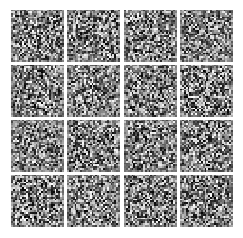


Iter: 0, D: 15.69, G:0.2516
Iter: 50, D: -3.814, G:-4.702
Iter: 100, D: -1.124, G:-4.682
Iter: 150, D: -1.974, G:-5.871
Iter: 200, D: -3.408, G:0.9027


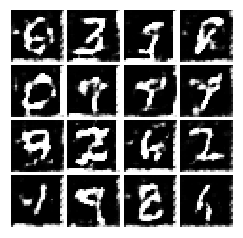


Iter: 250, D: 0.001249, G:-2.269
Iter: 300, D: -0.06042, G:0.811
Iter: 350, D: -0.6996, G:-1.949
Iter: 400, D: -0.2679, G:-1.8
Iter: 450, D: -0.1641, G:-1.061


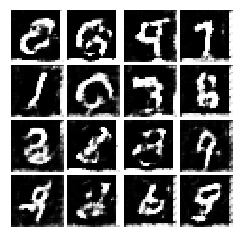


Iter: 500, D: -0.6117, G:2.881
Iter: 550, D: -0.05101, G:-1.888
Iter: 600, D: -0.5474, G:-0.7987
Iter: 650, D: -0.5845, G:-3.89
Iter: 700, D: -0.6945, G:-0.5911


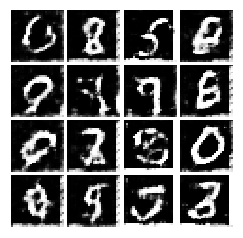


Iter: 750, D: -0.7908, G:-2.204
Iter: 800, D: -0.2995, G:-3.013
Iter: 850, D: -0.8232, G:-3.975
Iter: 900, D: -1.276, G:-0.8818
Iter: 950, D: -1.439, G:-5.922


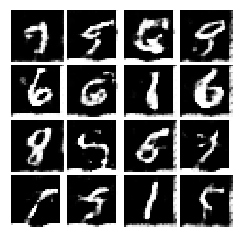


Iter: 1000, D: -1.962, G:-5.562
Iter: 1050, D: -3.012, G:-4.391
Iter: 1100, D: -2.062, G:-4.781
Iter: 1150, D: -0.1663, G:2.779
Iter: 1200, D: -0.2411, G:1.009


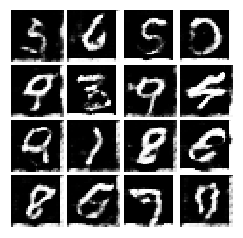


Iter: 1250, D: -0.1781, G:-0.6998
Iter: 1300, D: -0.1194, G:-1.953
Iter: 1350, D: -1.355, G:-1.223
Iter: 1400, D: -0.9081, G:-3.136
Iter: 1450, D: -0.7893, G:-7.75


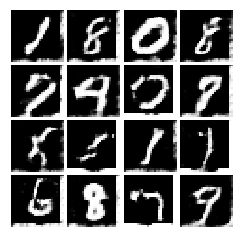


Iter: 1500, D: -0.19, G:-4.667
Iter: 1550, D: -1.037, G:-7.91
Iter: 1600, D: -0.6762, G:-4.769
Iter: 1650, D: -0.7592, G:-2.28
Iter: 1700, D: -1.644, G:-8.476


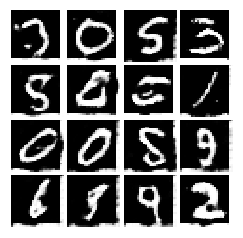


Iter: 1750, D: -1.646, G:-9.199
Iter: 1800, D: -1.551, G:-5.054
Iter: 1850, D: -0.5473, G:-7.095
Iter: 1900, D: -1.6, G:-7.74
Iter: 1950, D: -1.36, G:-16.62


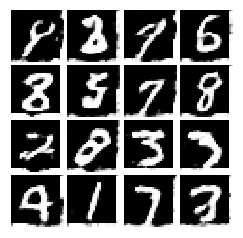


Iter: 2000, D: -2.592, G:-15.1
Iter: 2050, D: -0.3433, G:1.722
Iter: 2100, D: -0.9591, G:-0.3644
Final images


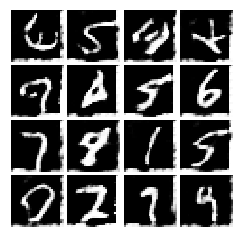

In [51]:
with get_session() as sess:
    sess.run(tf.global_variables_initializer())
    run_a_gan(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,batch_size=128,num_epoch=5)